In [1]:
import os
import functools
import json
import pandas as pd
import numpy as np
from scipy import special
from scipy.cluster import hierarchy
from sklearn.preprocessing import normalize
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.svm import LinearSVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split, StratifiedShuffleSplit
from sklearn.metrics import classification_report
from sklearn.metrics.pairwise import euclidean_distances, cosine_distances, cosine_similarity
from sklearn.cluster import KMeans, AgglomerativeClustering
import umap
import matplotlib.pyplot as plt
from matplotlib import animation
from mpl_toolkits import mplot3d
import seaborn as sns
from cartopy.io.shapereader import Reader
import pyperclip
from IPython.display import display_markdown

import sinetym.datasets
import sinetym.auxiliary
import sinetym.phonology
import sinetym.plot

In [2]:
plt.rcParams['font.family'] = ['Dejavu Sans', 'Microsoft Yahei']
# plt.rcParams['font.family'] = ['Dejavu Sans', 'Noto Sans CJK JP']

sinetym_root = os.path.expanduser(os.path.join('~', 'git', 'sinetym'))
config_file = os.path.join(sinetym_root, 'scripts', 'config.json')
# config_file = os.path.expanduser(os.path.join('~', 'data', 'models', 'config.json'))
emb_dir = os.path.join(sinetym_root, 'data', 'embeddings', 'bilinear_encoder_100_100_100_1_1')
shp_prefix = os.path.expanduser(os.path.join('~', 'git', 'ChinaAdminDivisonSHP'))

np.random.seed(5981)

In [3]:
config = json.load(open(config_file))
dialect_columns, input_columns, output_columns = [config['columns'][n] for n in ('dialect', 'input', 'output')]

for e in os.scandir(emb_dir):
    name, ext = os.path.splitext(e.name)
    if ext == '.csv':
        d = pd.read_csv(e.path, header=None, index_col=0, encoding='utf-8')
        d.set_index(d.index.fillna('').rename(None), inplace=True)
        globals()[name] = d

weight = np.reshape(
    np.loadtxt(os.path.join(emb_dir, 'weight.txt')),
    (globals()[dialect_columns[0]].shape[-1], globals()[input_columns[0]].shape[-1], -1)
)

dialect_embs = []
for c in dialect_columns:
    e = globals()[c]
    e.insert(e.shape[1], e.shape[1] + 1, 1)
    dialect_embs.append(e)

input_embs = []
for c in input_columns:
    e = globals()[c]
    e.insert(e.shape[1], e.shape[1] + 1, 1)
    input_embs.append(e)

output_embs = []
for c in output_columns:
    e = globals()[c]
    try:
        e.insert(e.shape[1], e.shape[1] + 1, globals()[f'{c}_bias'].iloc[:, 0])
    except KeyError:
        e.insert(e.shape[1], e.shape[1] + 1, 0)
    output_embs.append(e)

weight = np.pad(weight, ((0, 0), (0, 1), (0, 1)), constant_values=1)
weight = np.append(weight, np.eye(weight.shape[1], weight.shape[2])[None, ...], axis=0)

initial_emb, final_emb, tone_emb = initial, final, tone

In [4]:
dialect_infos = []
char_infos = []
for d in config['datasets']:
    d = getattr(sinetym.datasets, d if isinstance(d, str) else d['name'])
    di = d.metadata['dialect_info'][[
        'group',
        'subgroup',
        'cluster',
        'subcluster',
        'spot',
        'latitude',
        'longitude'
    ]].copy()
    di.insert(0, 'dataset', d.name)
    di['did'] = di.index + 'mb01' if d is sinetym.datasets.zhongguoyuyan else di.index
    dialect_infos.append(di)

    char_infos.append(d.metadata['char_info'].rename(columns={'頻次': 'frequency'}) \
        .reindex(['character', 'frequency'], axis=1) \
        .assign(dataset=d.name))

dialect = pd.concat(dialect_infos, axis=0)
char = pd.concat(char_infos, axis=0)

In [5]:
dialect['idx'] = np.arange(dialect.shape[0])
dialect.loc[[
    'X027',     # 北京
    'X136',     # 温州
    'X216',     # 双峰
    'X176',     # 南昌
    'X365',     # 梅县(广东)
    'X272',     # 广州
    'Z03E88',   # 西城
    'Z28E77',   # 咸阳渭城
    'Z10G68',   # 南京
    'Z16300',   # 成都锦江
    'Z10G69',   # 南通
    'Z12A91',   # 运城新绛
    'Z12177',   # 太原小店
    'Z10G71',   # 苏州姑苏
    'Z08210',   # 温州鹿城
    'Z21J03',   # 黄山徽州
    'Z26516',   # 长沙开福
    'Z26509',   # 娄底双峰
    'Z18358',   # 南昌西湖
    'Z02A14',   # 三明泰宁
    'Z15233',   # 梅州梅江
    'Z15229',   # 惠州惠城
    'Z15231',   # 广州荔湾
    'Z15235',   # 江门台山
    'Z01G23',   # 南宁江南
    'Z01G29',   # 桂林临桂
    'Z02A05',   # 福州鼓楼
    'Z02G49',   # 厦门思明
    'Z23C55',   # 海口龙华
    'Z02193',   # 南平建瓯
    'Z35H08',   # 韶关浈江
    'Z26D48',   # 永州江永
    'Z26J61',   # 怀化沅陵
], 'representative'] = True
dialect['representative'].fillna(False, inplace=True)

dialect.loc[dialect['representative'], 'sample'] = True
mask = (~dialect['representative'] & (dialect['group'] != ''))
idx, _ = next(StratifiedShuffleSplit(n_splits=1, train_size=100 - dialect['sample'].count()) \
    .split(dialect[mask], dialect.loc[mask, 'group']))
dialect.loc[dialect[mask].index[idx], 'sample'] = True
dialect['sample'].fillna(False, inplace=True)

In [6]:
char['idx'] = np.arange(char.shape[0])
char['cid'] = char.index
char['frequency'] = char['frequency'].astype(float)

data = sinetym.datasets.zhongguoyuyan.filter(id=('08210mb01', '15233mb01'))
data = sinetym.dataset.concat(
    sinetym.datasets.xiaoxuetang.filter(id=('136', '365')),
    data.assign(did=data['did'] + data['variant'])
).data

df = data[data['did'].isin(['X136', 'Z08210mb01'])].drop_duplicates('cid').set_index('cid')
char['initial_voicing'] = df['initial'].map(sinetym.phonology.get_voicing).reindex(char.index).fillna('')
char['tone'] = df['tone'].reindex(char.index).fillna('')
df = data[data['did'].isin(['X365', 'Z15233mb01'])].drop_duplicates('cid').set_index('cid')
char['initial_manner'] = df['initial'].map(sinetym.phonology.get_manner).reindex(char.index).fillna('')
char['coda_type'] = df['final'].map(sinetym.phonology.get_coda_type).reindex(char.index).fillna('')

char.loc[[
    'X9444',    # 三
    'X8989',    # 頭
    'X14067',   # 狗
    'X9934',    # 重
    'X13854',   # 有
    'X19193',   # 病
    'X21129',   # 一
    'X23424',   # 白
    'Z0391',    # 三
    'Z0334',    # 头
    'Z0696',    # 蚊
    'Z0340',    # 狗
    'Z0981',    # 重
    'Z0486',    # 眼
    'Z0613',    # 远
    'Z0141',    # 买
    'Z0369',    # 有
    'Z0860',    # 病
    'Z0501',    # 面
    'Z0656',    # 一
    'Z0886',    # 尺
    'Z0843',    # 白
    'Z0214',    # 鼻
    'Z0715',    # 摸
], 'representative'] = True
char['representative'].fillna(False, inplace=True)

char.loc[char['representative'], 'sample'] = True
mask = (~char['representative'] & (char['tone'] != '') & (char['dataset'] == 'xiaoxuetang') & (char['frequency'] >= 5))
idx, _ = next(StratifiedShuffleSplit(n_splits=1, train_size=(100 - char['sample'].count()) // 2) \
    .split(char[mask], char.loc[mask, 'tone']))
char.loc[char[mask].index[idx], 'sample'] = True
mask = (~char['representative'] & (char['tone'] != '') & (char['dataset'] == 'zhongguoyuyan'))
idx, _ = next(StratifiedShuffleSplit(n_splits=1, train_size=100 - char['sample'].count()) \
    .split(char[mask], char.loc[mask, 'tone']))
char.loc[char[mask].index[idx], 'sample'] = True
char['sample'].fillna(False, inplace=True)

In [7]:
def get_emb(embs, inputs):
    inputs = np.asarray(inputs)
    emb = np.empty((len(embs), inputs.shape[0], embs[0].shape[1]), dtype=np.float32)

    for i in range(emb.shape[0]):
        emb[i] = embs[i].reindex(inputs[:, i])
        emb[i, np.any(np.isnan(emb[i]), axis=1)] = embs[i].loc['']

    return np.mean(emb, axis=0)

def get_output(output_embs, emb):
    outputs = []

    for i, e in enumerate(output_embs):
        logits = emb @ e.values.T
        outputs.append(e.index[np.argmax(logits[:, :-1], axis=1)])

    return np.stack(outputs, axis=1)

def get_prob(output_embs, emb):
    probs = []
    for i, e in enumerate(output_embs):
        logits = emb @ e.values.T
        probs.append(pd.DataFrame(special.softmax(logits[:, :-1], axis=1), columns=e.index[:-1]))

    return probs

def transform(dialect_emb, input_emb, weight):
    return np.reshape(input_emb[:, None, :] @ np.tensordot(dialect_emb, weight, (-1, 0)), (input_emb.shape[0], -1))

def get_trans(dialect_emb, weight):
    return np.tensordot(dialect_emb, weight, [-1, 0])

def rotate(azimuth, ax=None):
    ax.view_init(azim=azimuth)
    return ax

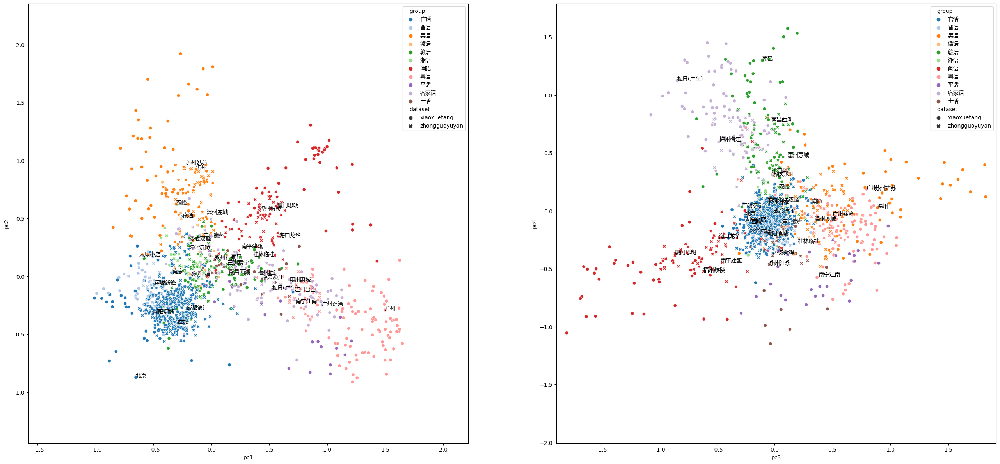

In [8]:
dialect_emb = get_emb(dialect_embs, dialect[dialect_columns])
dialect_pca = PCA(4)
columns = [f'pc{i + 1}' for i in range(dialect_pca.n_components)]
dialect[columns] = dialect_pca.fit_transform(dialect_emb)

scale = (dialect[columns].max() - dialect[columns].min()).max() * 1.05

fig = plt.figure(figsize=(32, 18))

for i in range(2):
    c1 = f'pc{i * 2 + 1}'
    c2 = f'pc{i * 2 + 2}'

    ax = fig.add_subplot(1, 2, i + 1, aspect='equal')
    sns.scatterplot(dialect[dialect['group'] != ''], x=c1, y=c2, hue='group', style='dataset', palette='tab20', ax=ax)
    for _, r in dialect[dialect['representative']].iterrows():
        ax.annotate(r['spot'], xy=r[[c1, c2]])
    ax.set_xlim((dialect[c1].min() + dialect[c1].max() + np.asarray([-1, 1]) * scale) / 2)
    ax.set_ylim((dialect[c1].min() + dialect[c2].max() + np.asarray([-1, 1]) * scale) / 2)

plt.show()
plt.close()

C:\Users\lerna\AppData\Local\Temp\ipykernel_7368\3521321034.py:7: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(df['pc1'], df['pc2'], df['pc3'], cmap='tab20', label=g)


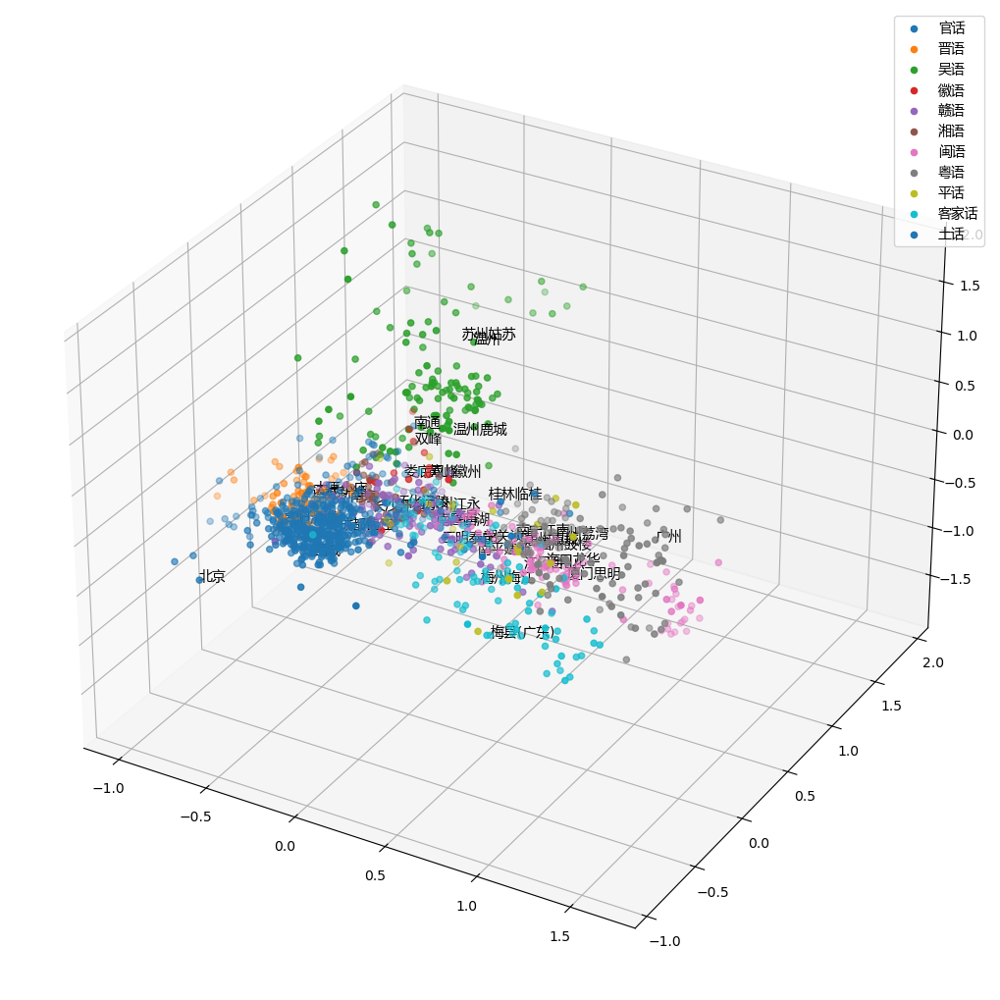

In [9]:
fig = plt.figure(figsize=(10, 10))
ax = mplot3d.Axes3D(fig)
fig.add_axes(ax)

for g in dialect.loc[dialect['group'] != '', 'group'].unique():
    df = dialect[dialect['group'] == g]
    ax.scatter(df['pc1'], df['pc2'], df['pc3'], cmap='tab20', label=g)

for _, r in dialect[dialect['representative']].iterrows():
    ax.text(*r[['pc1', 'pc2', 'pc3']], r['spot'])

ax.legend(loc='upper right')
plt.show()

ani = animation.FuncAnimation(
    fig,
    functools.partial(rotate, ax=ax),
    np.arange(45, 405, 5),
    interval=200,
    repeat_delay=200
)
ani.save('方言编码PCA降维三维散点图.gif')
plt.close()

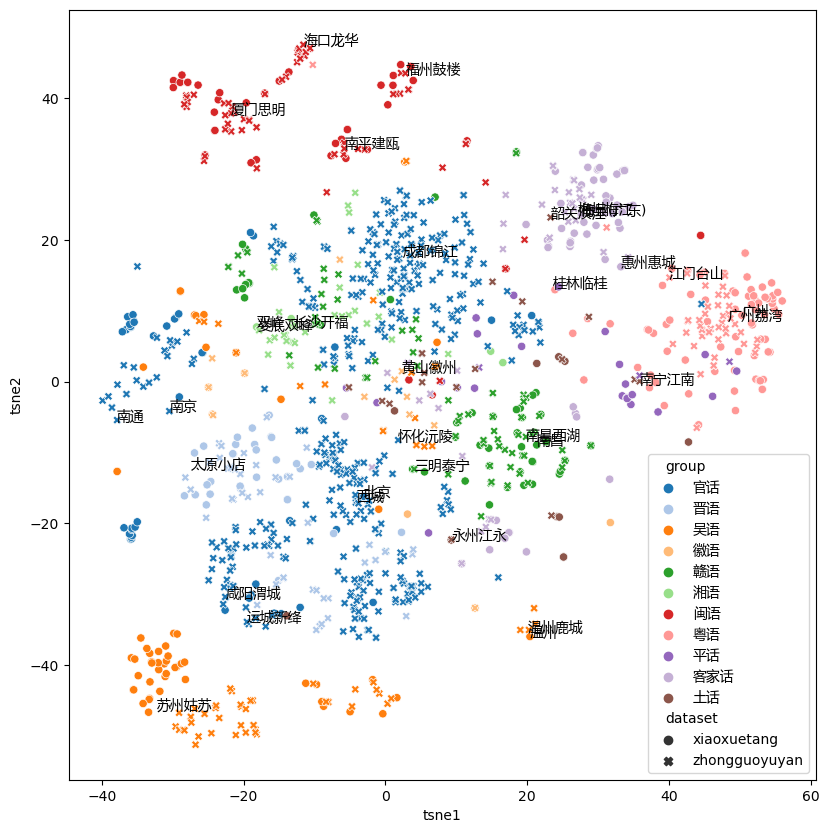

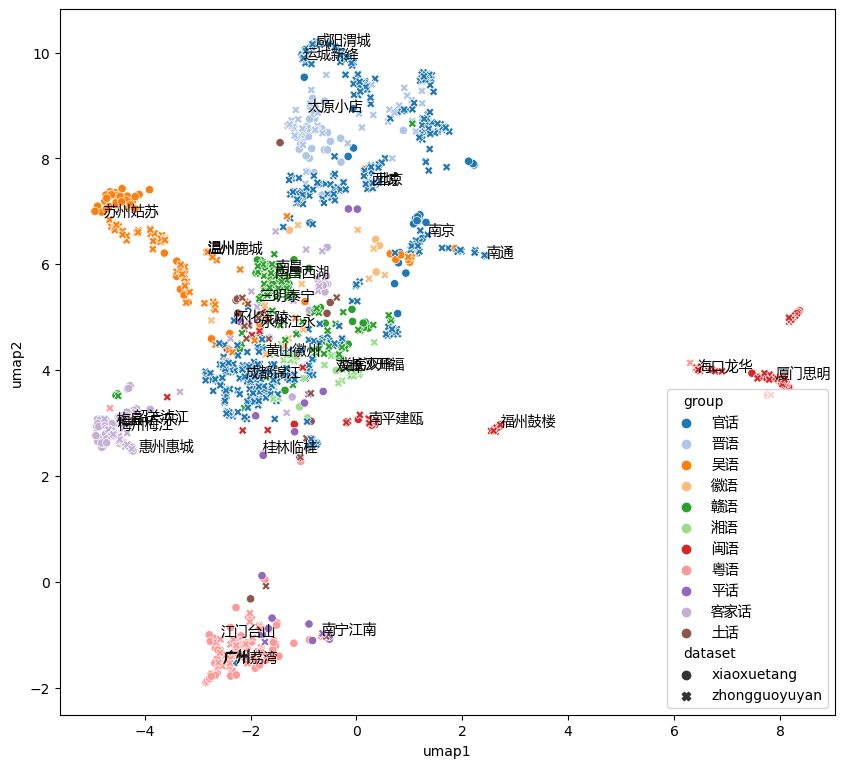

In [10]:
for prefix, transformer in (('tsne', TSNE(2)), ('umap', umap.UMAP(n_components=2))):
    dialect[[f'{prefix}1', f'{prefix}2']] = transformer.fit_transform(dialect_emb)

    plt.figure(figsize=(10, 10))
    ax = plt.axes(aspect='equal')

    sns.scatterplot(data=dialect[dialect['group'] != ''], x=f'{prefix}1', y=f'{prefix}2', hue='group', style='dataset', palette='tab20', ax=ax)
    for _, r in dialect[dialect['representative']].iterrows():
        ax.annotate(r['spot'], xy=r[[f'{prefix}1', f'{prefix}2']])

    plt.show()
    plt.close()

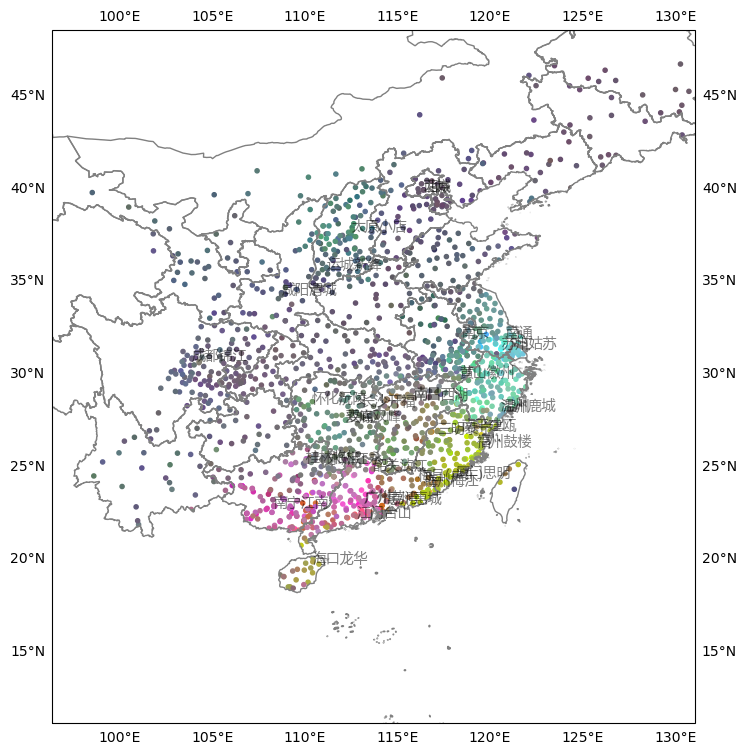

In [11]:
china = tuple(Reader(os.path.join(shp_prefix, '1. Country', 'country.shp')).geometries())
province = tuple(Reader(os.path.join(shp_prefix, '2. Province', 'province.shp')).geometries())

plt.figure(figsize=(16, 9))
ax, _, _ = sinetym.plot.geography.scatter(
    dialect['latitude'],
    dialect['longitude'],
    sinetym.auxiliary.pc2color(dialect[['pc1', 'pc2', 'pc3']].values),
    scale=3,
    clip=china,
    marker='.'
)
ax.add_geometries(province, ax.projection, edgecolor='gray', facecolor='none')

for _, r in dialect[dialect['representative']].iterrows():
    ax.annotate(r['spot'], xy=r[['longitude', 'latitude']], alpha=0.5)

gl = ax.gridlines(draw_labels=True)
gl.xlines = False
gl.ylines = False
plt.show()
plt.close()

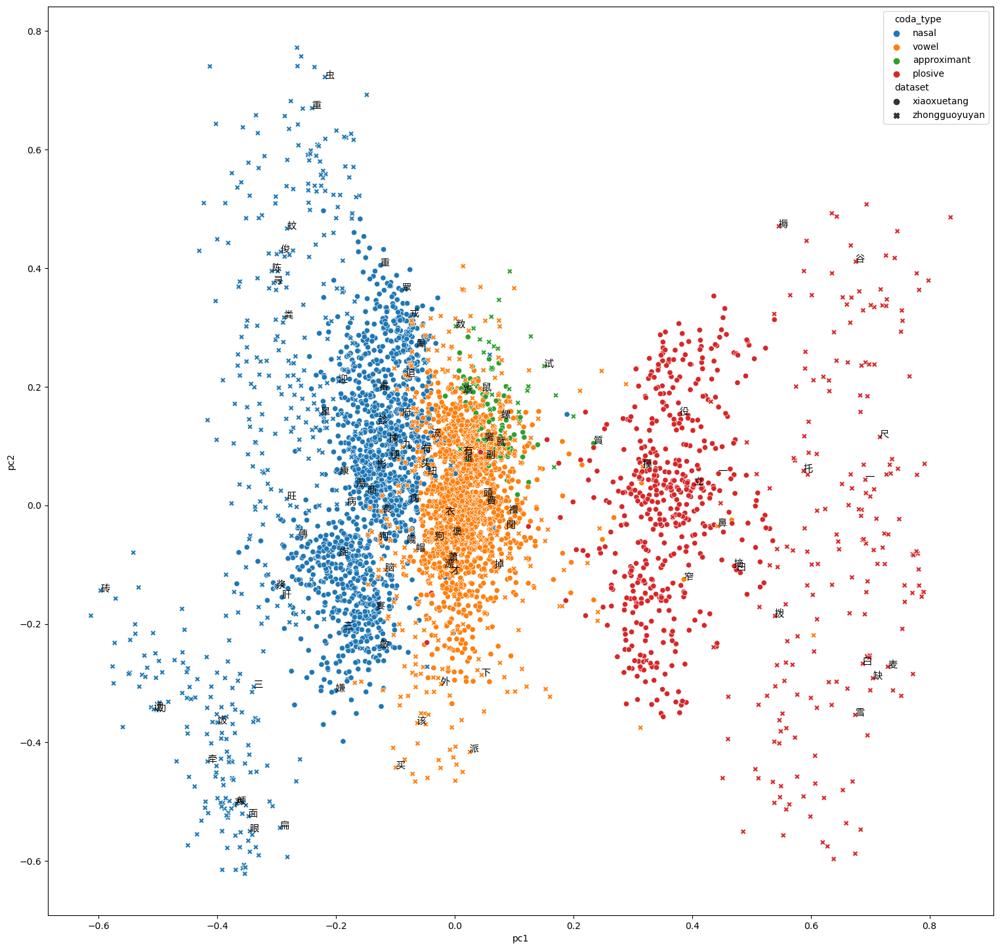

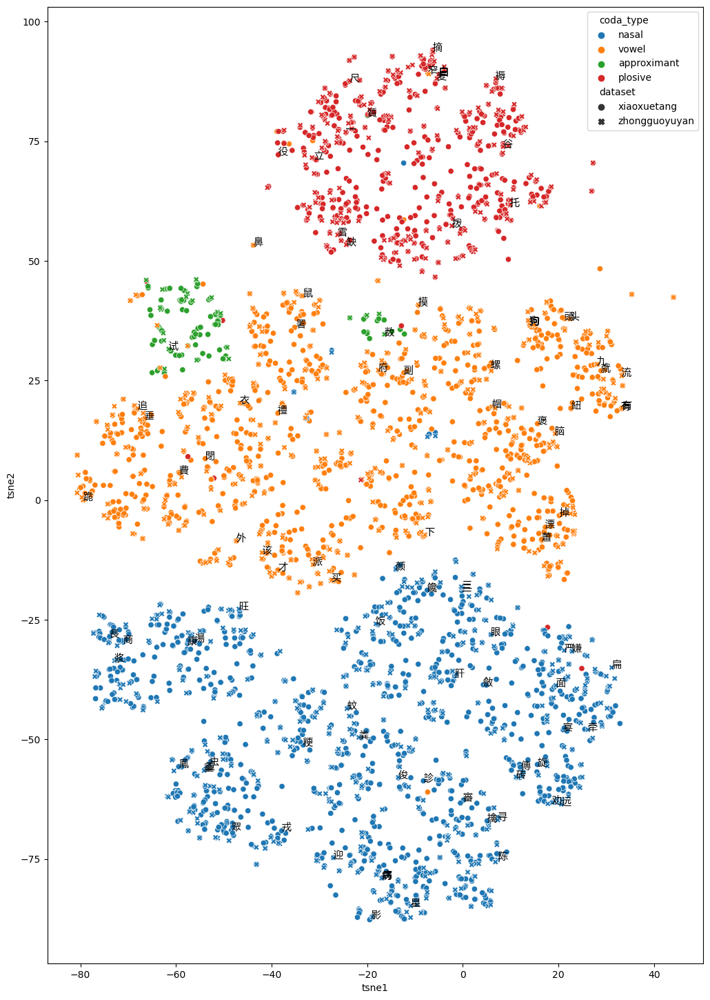

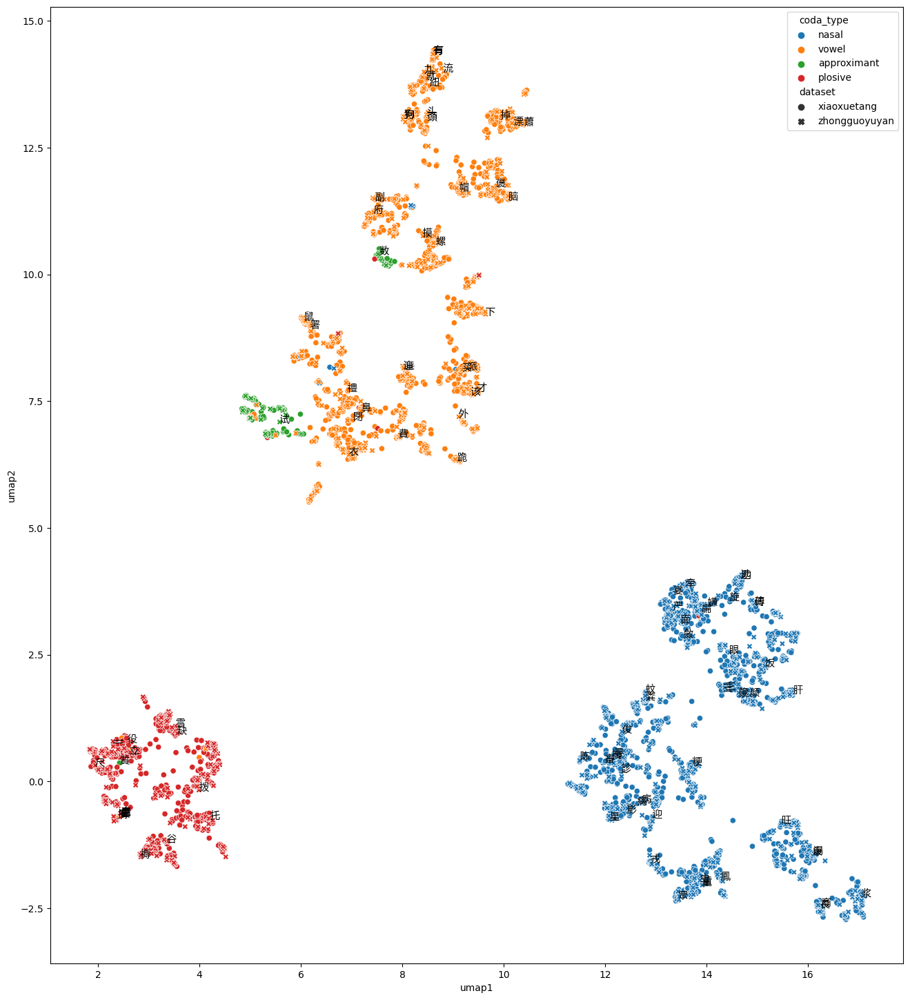

In [12]:
char_emb = get_emb(input_embs, char[input_columns])
char_pca = PCA(4)
char[[f'pc{i + 1}' for i in range(char_pca.n_components)]] \
    = char_pca.fit(char_emb[char['dataset'] == 'zhongguoyuyan']).transform(char_emb)
char[['tsne1', 'tsne2']] = TSNE(2).fit_transform(char_emb)
char[['umap1', 'umap2']] = umap.UMAP(n_components=2).fit_transform(char_emb)

for prefix in 'pc', 'tsne', 'umap':
    plt.figure(figsize=(32, 18))
    ax = plt.axes(aspect='equal')

    sns.scatterplot(
        char[char['coda_type'] != ''],
        x=f'{prefix}1',
        y=f'{prefix}2',
        hue='coda_type',
        style='dataset',
        palette='tab10',
        ax=ax
    )

    for _, r in char[char['sample']].iterrows():
        ax.annotate(r['character'], xy=r[[f'{prefix}1', f'{prefix}2']])

    plt.show()
    plt.close()

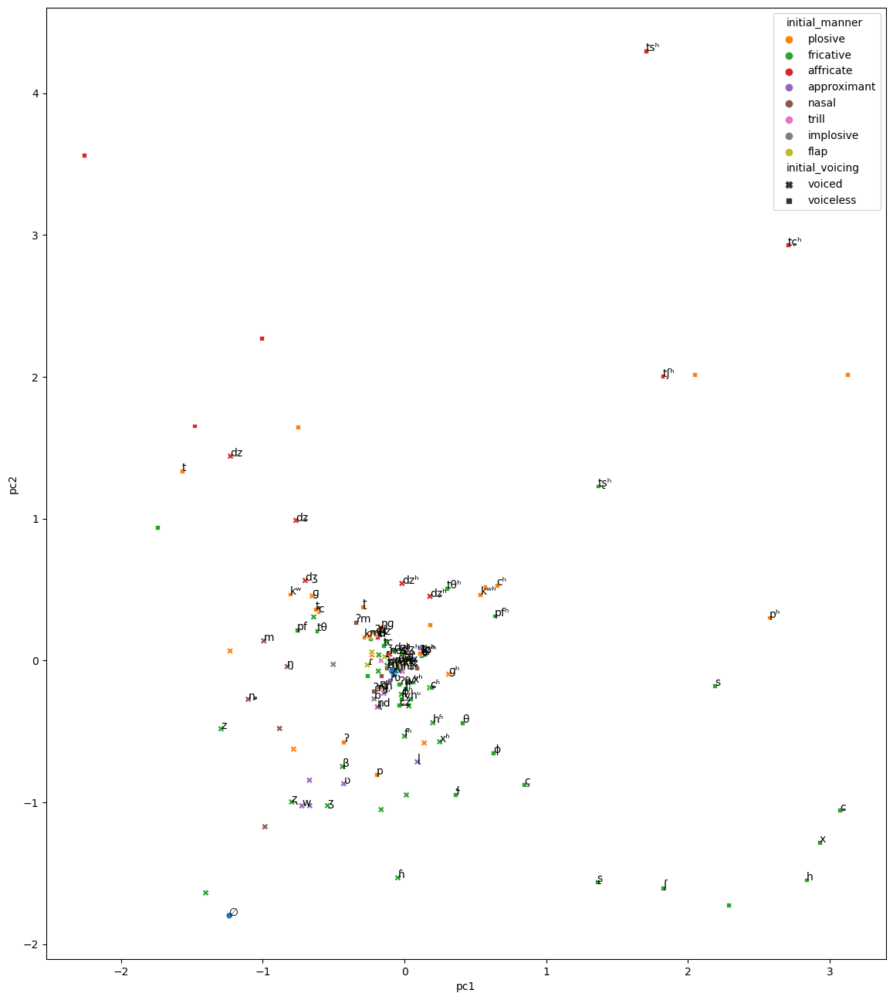

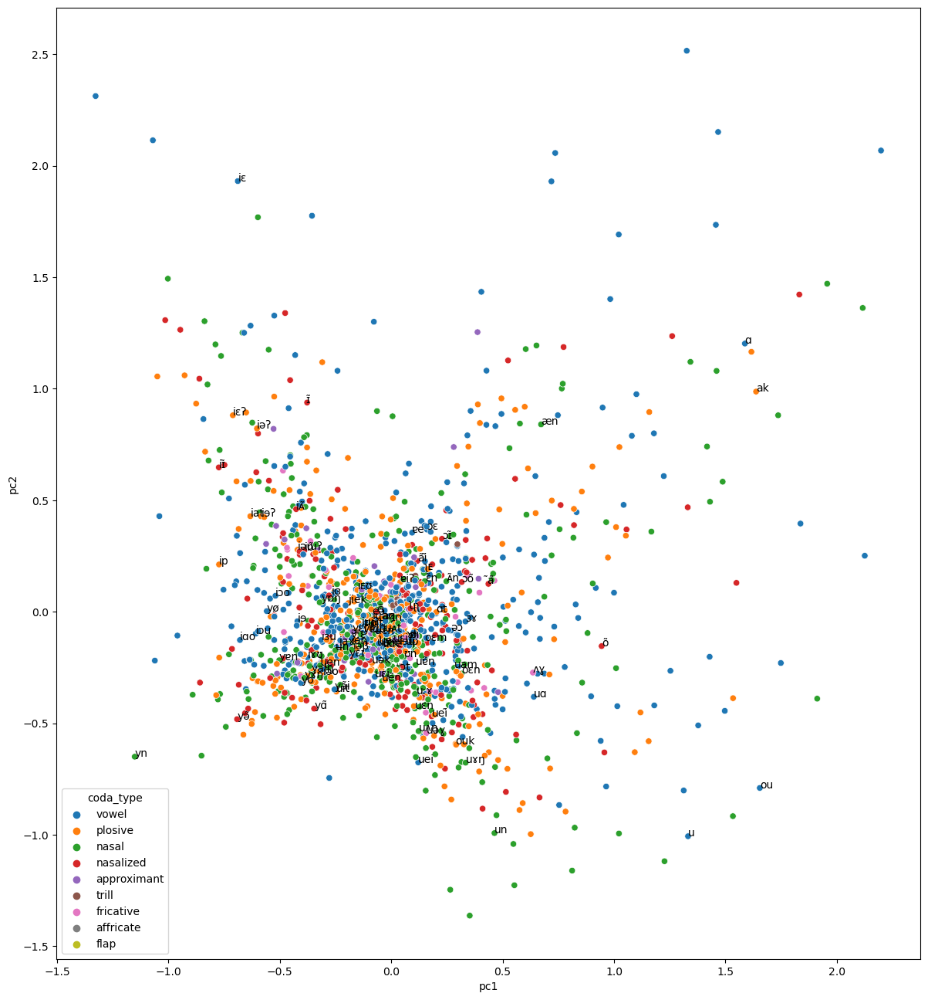

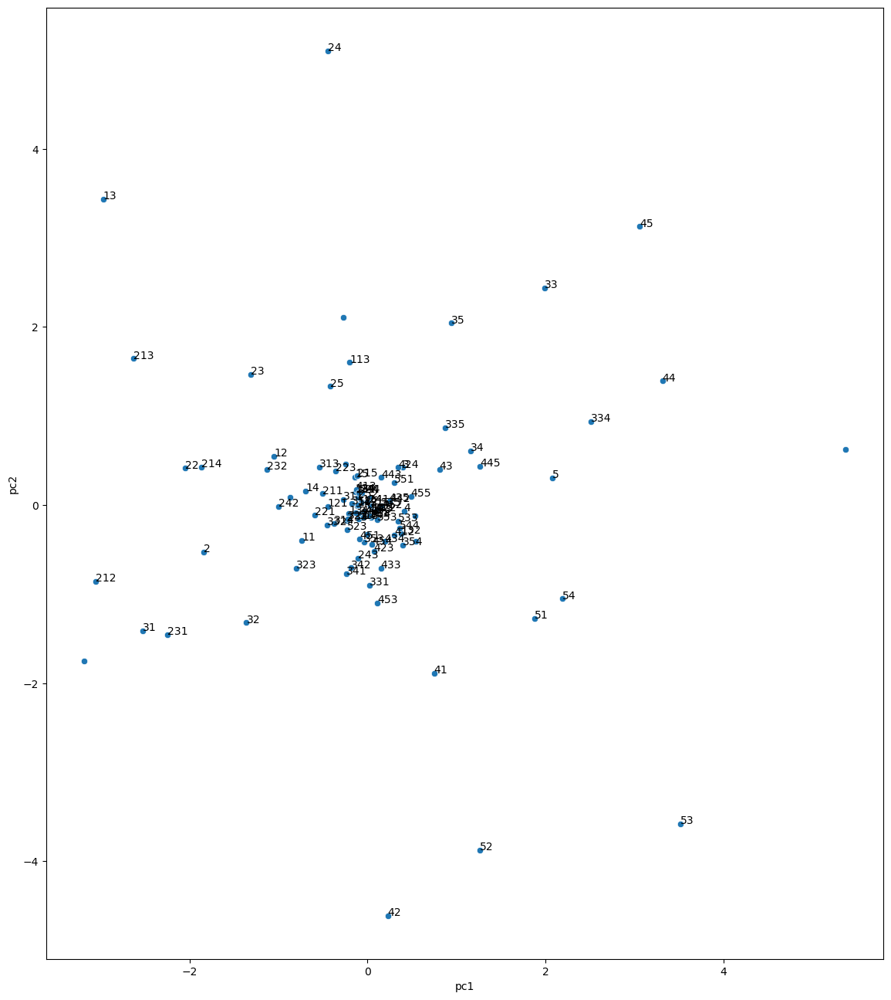

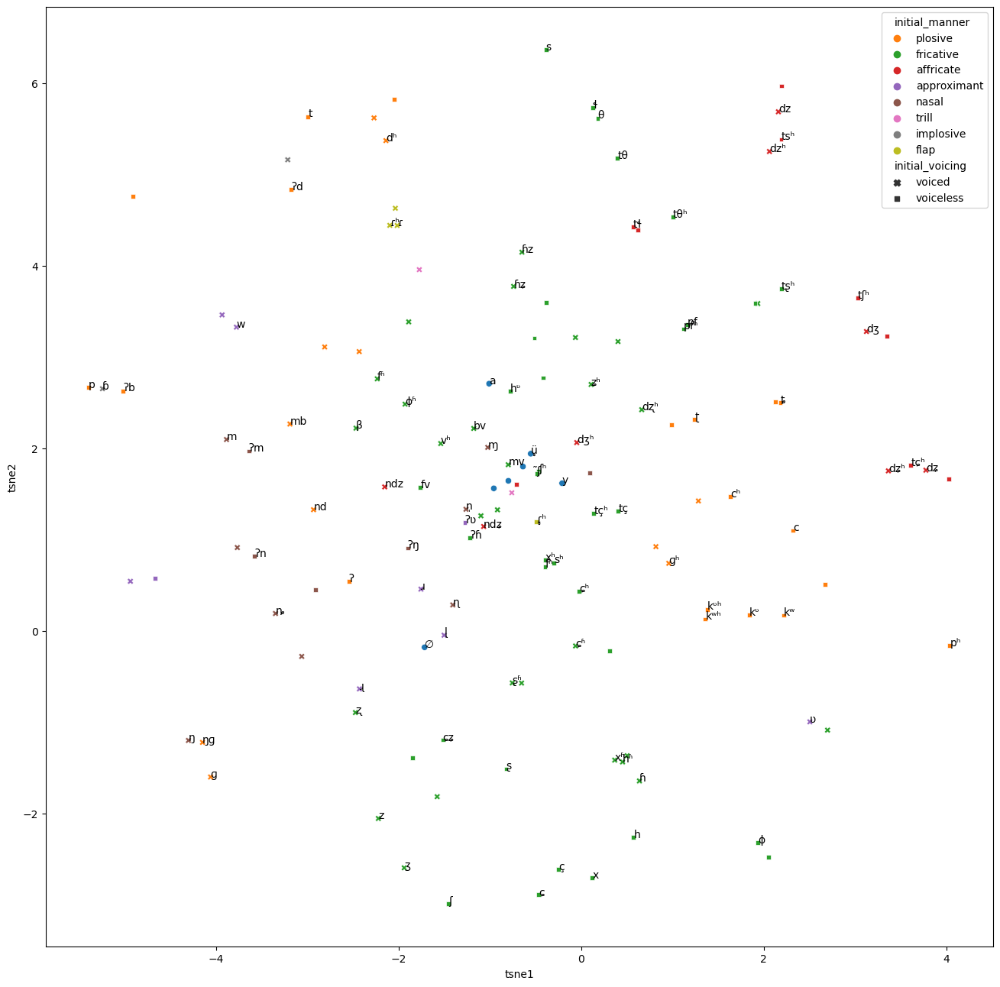

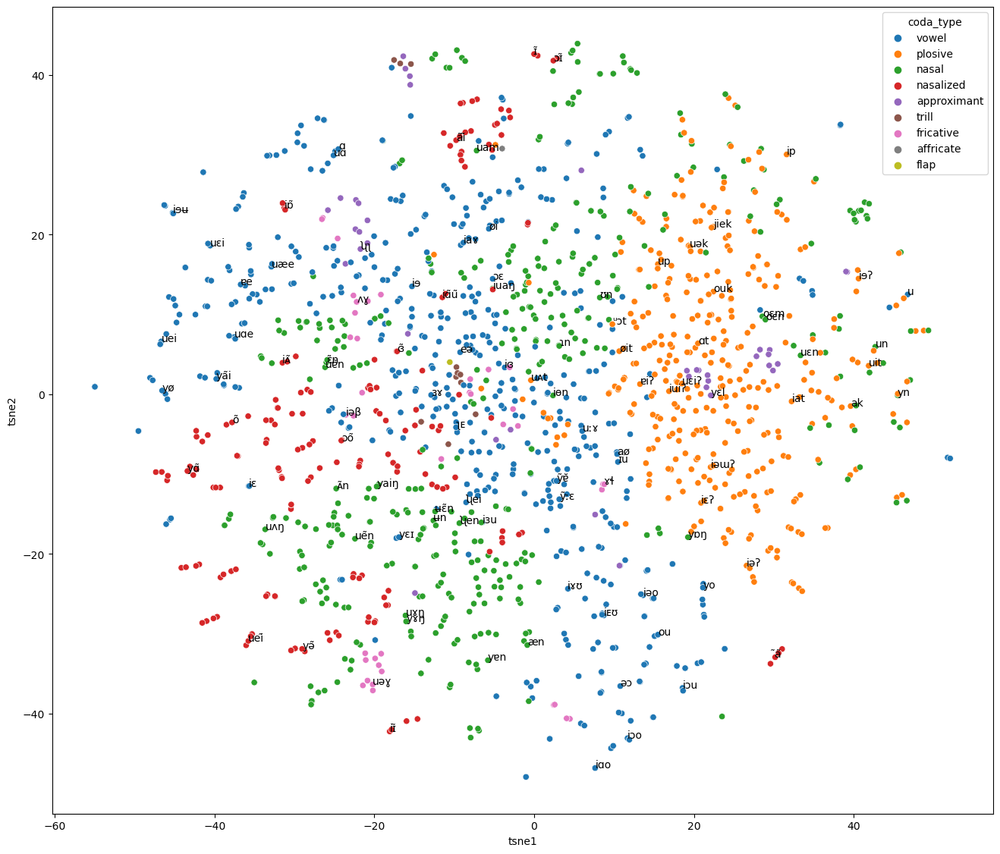

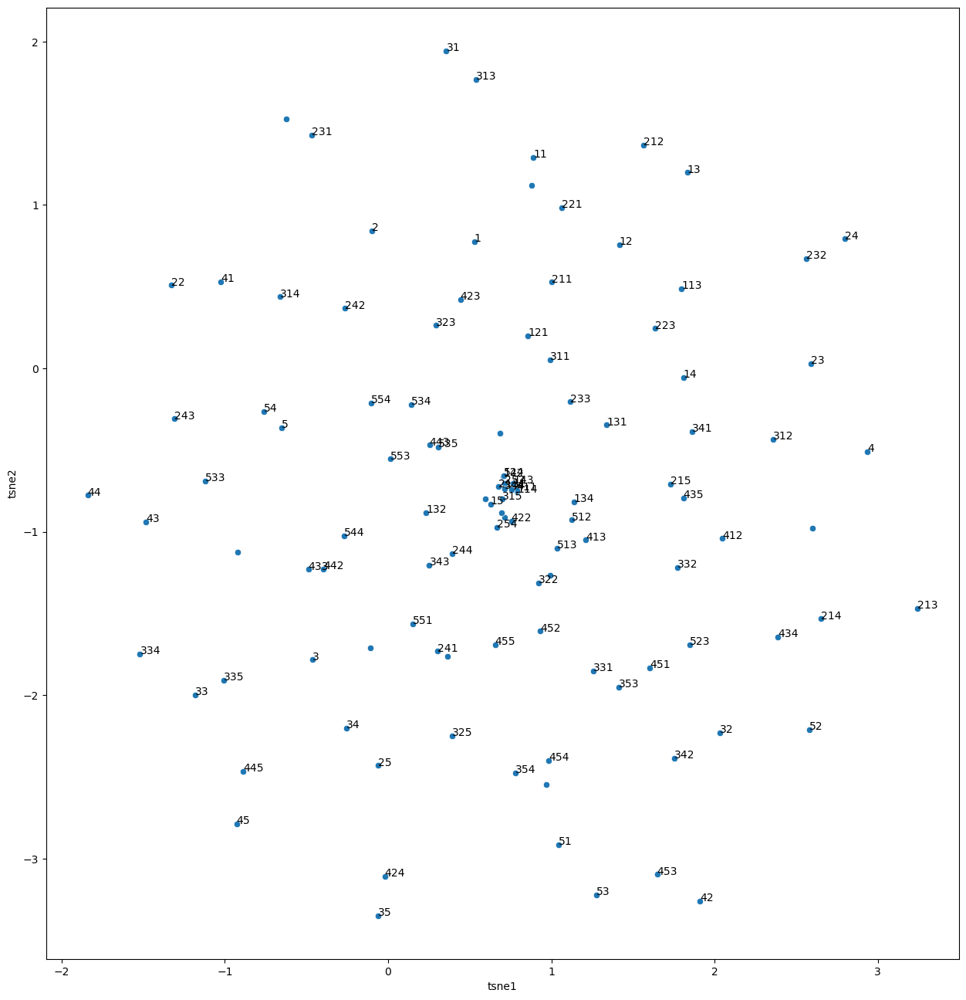

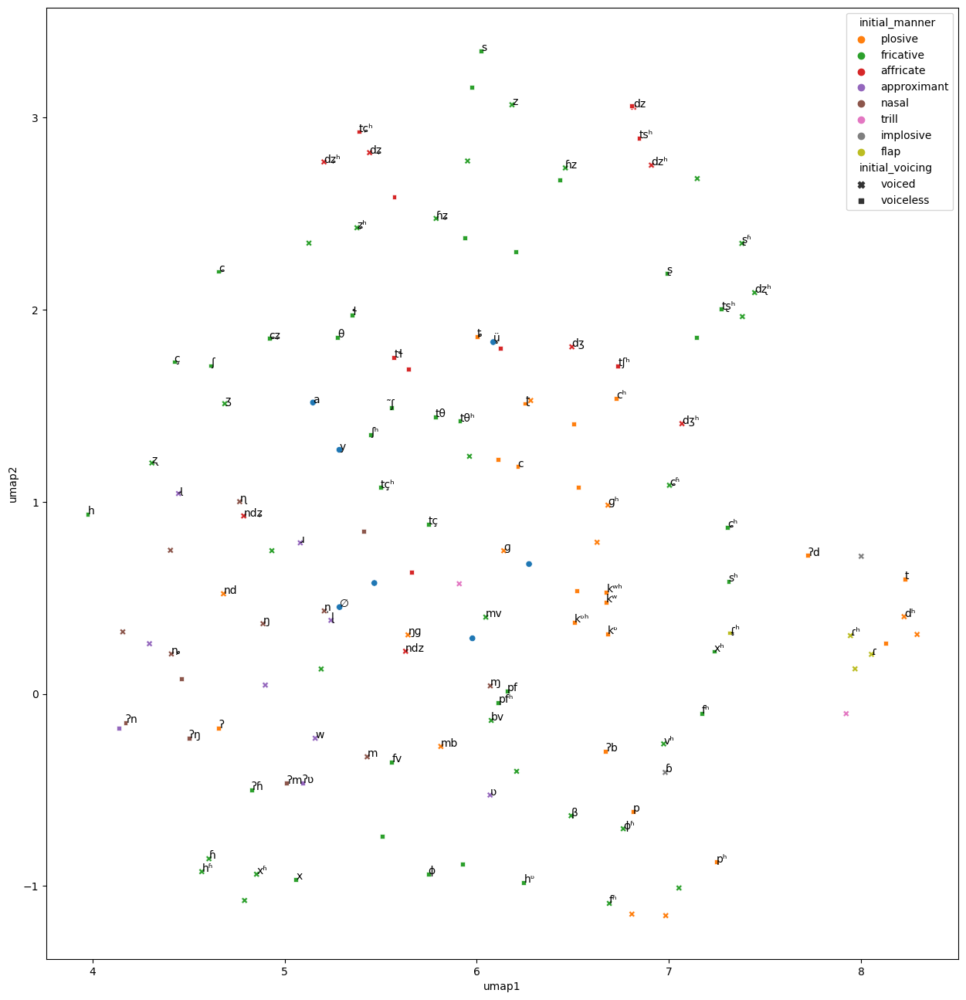

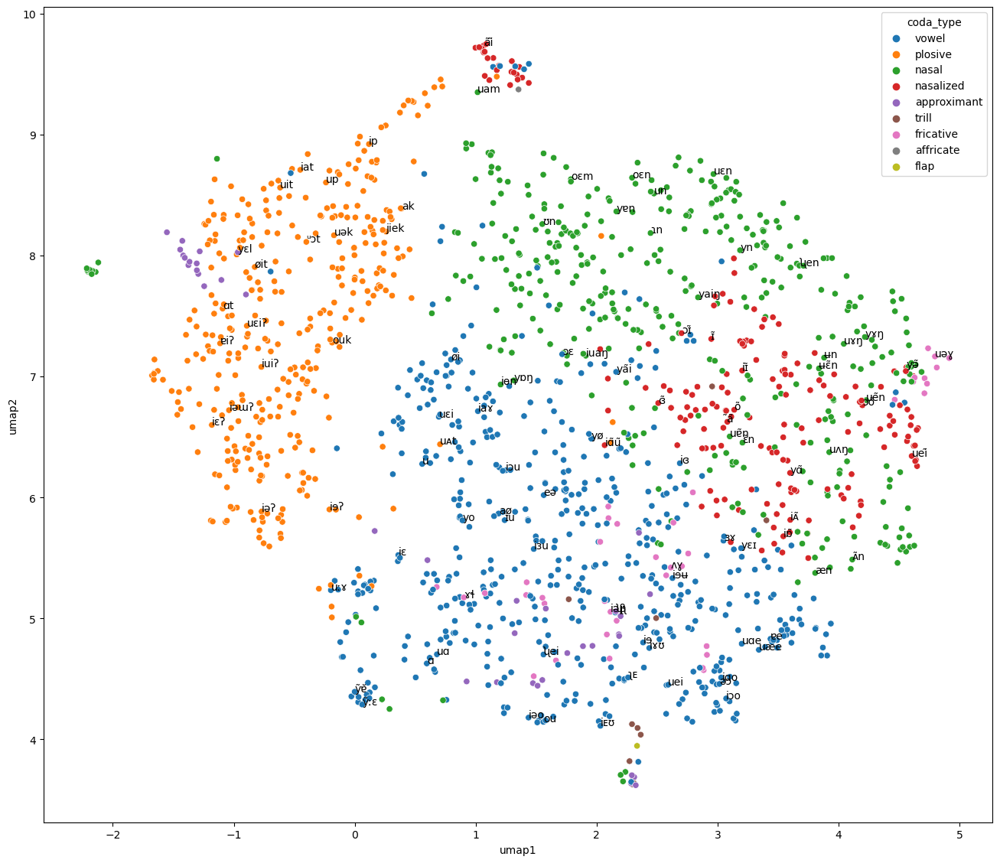

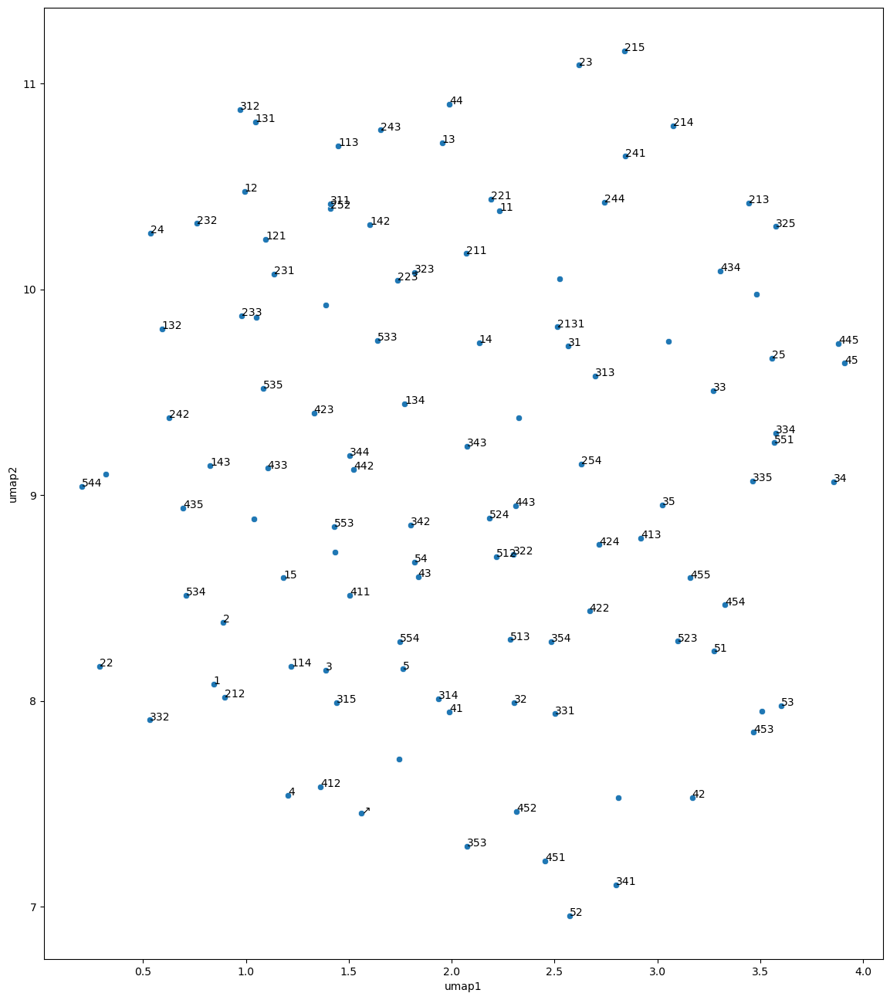

In [13]:
initial = pd.DataFrame({
    'initial_voicing': initial_emb.index[:-1].map(sinetym.phonology.get_voicing).fillna(''),
    'initial_manner': initial_emb.index[:-1].map(sinetym.phonology.get_manner).fillna('')
}, index=initial_emb.index[:-1])
final = pd.DataFrame({'coda_type': final_emb.index[:-1].map(sinetym.phonology.get_coda_type).fillna('')}, index=final_emb.index[:-1])
tone = pd.DataFrame(index=tone_emb.index[:-1])

for t in initial, final, tone:
    t.loc[t.sample(100).index, 'sample'] = True
    t['sample'].fillna(False, inplace=True)

initial_pca, final_pca, tone_pca = PCA(2), PCA(2), PCA(2)

for i, t in enumerate(('initial', 'final', 'tone')):
    target = globals()[t]
    emb = globals()[f'{t}_emb']

    for prefix, transformer in (('pc', globals()[f'{t}_pca']), ('tsne', TSNE(2)), ('umap', umap.UMAP(n_components=2))):
        target[[f'{prefix}1', f'{prefix}2']] = transformer.fit_transform(emb.values[:-1])

for prefix in ('pc', 'tsne', 'umap'):
    plt.figure(figsize=(16, 16))
    ax = plt.axes(aspect='equal')
    sns.scatterplot(initial, x=f'{prefix}1', y=f'{prefix}2', hue='initial_manner', style='initial_voicing', palette='tab10', ax=ax)
    for i, r in initial[initial['sample']].iterrows():
        ax.annotate(i, xy=r[[f'{prefix}1', f'{prefix}2']])
    plt.show()
    plt.close()

    plt.figure(figsize=(16, 16))
    ax = plt.axes(aspect='equal')
    sns.scatterplot(final, x=f'{prefix}1', y=f'{prefix}2', hue='coda_type', palette='tab10', ax=ax)
    for i, r in final[final['sample']].iterrows():
        ax.annotate(i, xy=r[[f'{prefix}1', f'{prefix}2']])
    plt.show()
    plt.close()

    plt.figure(figsize=(16, 16))
    ax = plt.axes(aspect='equal')
    sns.scatterplot(tone, x=f'{prefix}1', y=f'{prefix}2', ax=ax)
    for i, r in tone[tone['sample']].iterrows():
        ax.annotate(i, xy=r[[f'{prefix}1', f'{prefix}2']])
    plt.show()
    plt.close()

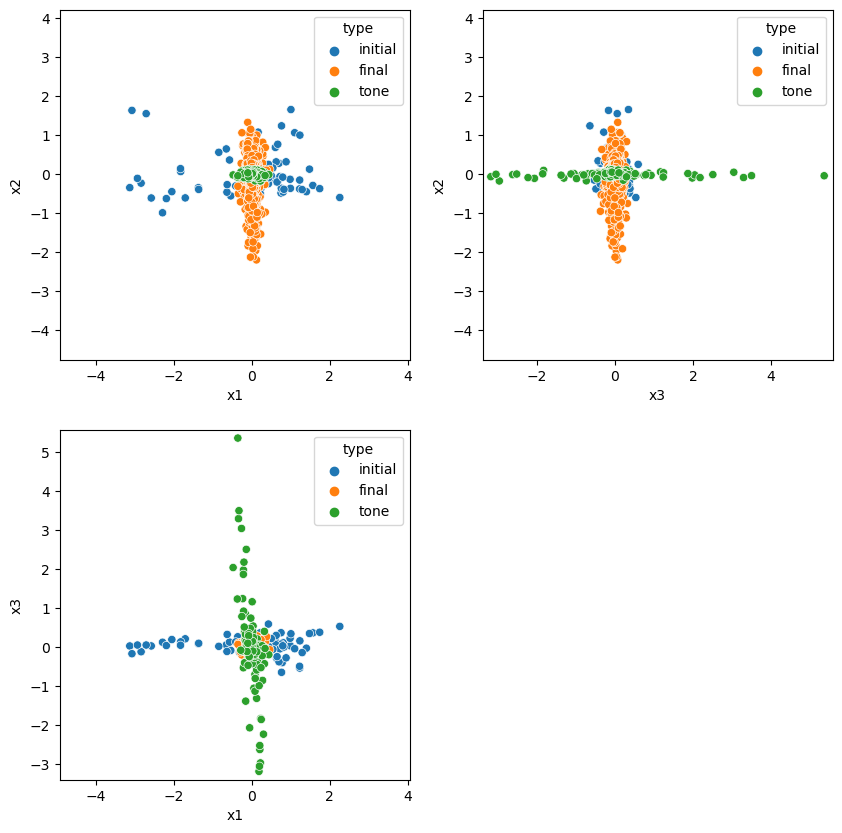

In [14]:
q, _ = np.linalg.qr(np.stack([initial_pca.components_[0], final_pca.components_[0], tone_pca.components_[0]], axis=1))
output = pd.concat([initial.assign(type='initial'), final.assign(type='final'), tone.assign(type='tone')], axis=0, ignore_index=True)
output[['x1', 'x2', 'x3']] = pd.concat(output_embs, axis=0, ignore_index=True) @ q

scale = (output[['x1', 'x2', 'x3']].max() - output[['x1', 'x2', 'x3']].min()).max() * 1.05
lim1, lim2, lim3 = (np.min(output[['x1', 'x2', 'x3']].values, axis=0, keepdims=True).T \
    + np.max(output[['x1', 'x2', 'x3']].values, axis=0, keepdims=True).T \
    + np.asarray([[-1, 1]]) * scale) / 2

fig = plt.figure(figsize=(10, 10))

ax = fig.add_subplot(2, 2, 1, aspect='equal')
sns.scatterplot(output, x='x1', y='x2', hue='type', palette='tab10', ax=ax)
ax.set_xlim(lim1)
ax.set_ylim(lim2)

ax = fig.add_subplot(2, 2, 2, aspect='equal')
sns.scatterplot(output, x='x3', y='x2', hue='type', palette='tab10', ax=ax)
ax.set_xlim(lim3)
ax.set_ylim(lim2)

ax = fig.add_subplot(2, 2, 3, aspect='equal')
sns.scatterplot(output, x='x1', y='x3', hue='type', palette='tab10', ax=ax)
ax.set_xlim(lim1)
ax.set_ylim(lim3)

plt.show()
plt.close()

C:\Users\lerna\AppData\Local\Temp\ipykernel_7368\218058412.py:7: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(df['x1'], df['x2'], df['x3'], cmap='tab10', label=t)


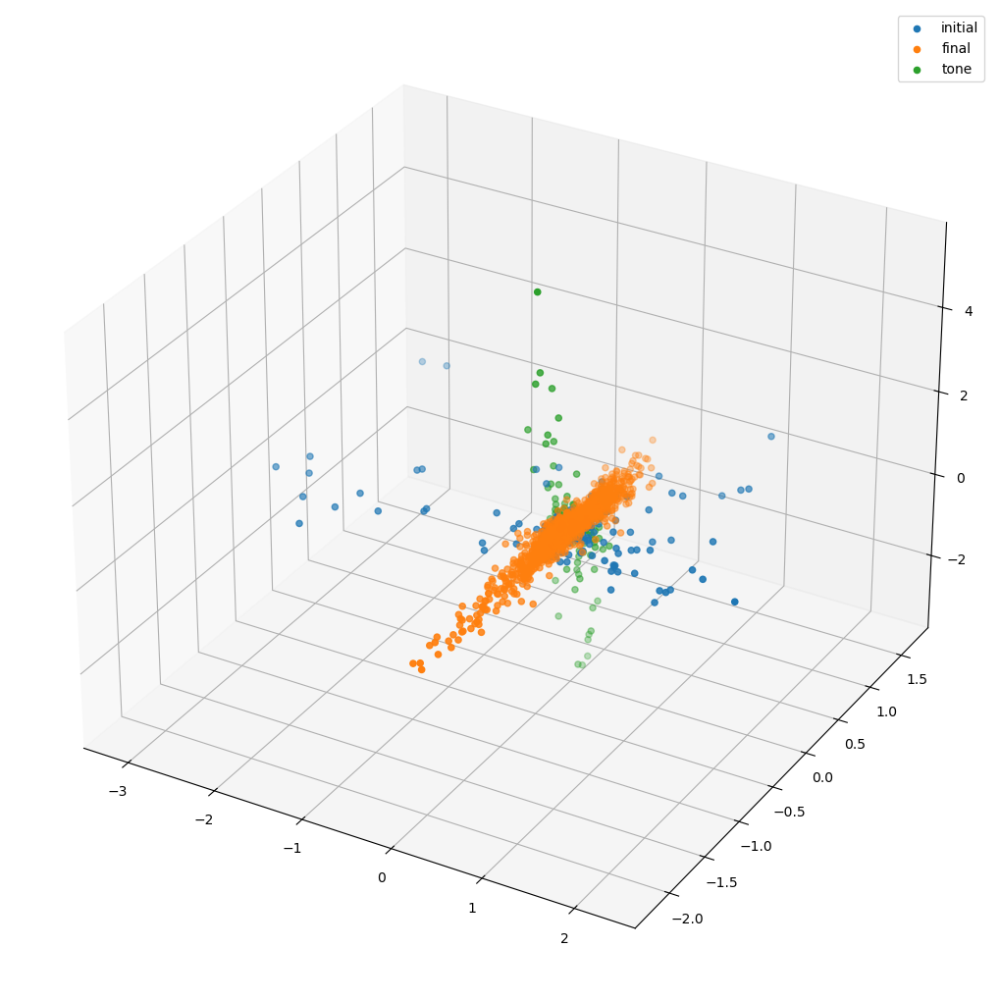

In [15]:
fig = plt.figure(figsize=(10, 10))
ax = mplot3d.Axes3D(fig)
fig.add_axes(ax)

for t in ('initial', 'final', 'tone'):
    df = output[output['type'] == t]
    ax.scatter(df['x1'], df['x2'], df['x3'], cmap='tab10', label=t)

ax.legend(loc='upper right')
plt.show()

ani = animation.FuncAnimation(
    fig,
    functools.partial(rotate, ax=ax),
    np.arange(45, 405, 5),
    interval=200,
    repeat_delay=200
)
ani.save('声韵调向量投影三维散点图.gif')
plt.close()

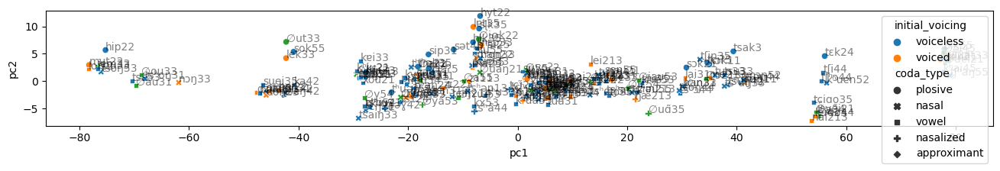

In [16]:
data = sinetym.datasets.zhongguoyuyan.filter(
    id=dialect.loc[dialect['sample'] & (dialect['dataset'] == 'zhongguoyuyan'), 'did'].str[1:]
)

data = sinetym.dataset.concat(
    sinetym.datasets.xiaoxuetang.filter(
        id=dialect.loc[dialect['sample'] & (dialect['dataset'] == 'xiaoxuetang'), 'did'].str[1:]
    ),
    data.assign(did=data['did'] + data['variant'])
).data

data['initial_voicing'] = data['initial'].map(sinetym.phonology.get_voicing).fillna('')
data['initial_manner'] = data['initial'].map(sinetym.phonology.get_manner).fillna('')
data['coda_type'] = data['final'].map(sinetym.phonology.get_coda_type).fillna('')

sample = data.sample(200)
output_emb = transform(
    get_emb(dialect_embs, sample[dialect_columns]),
    get_emb(input_embs, sample[input_columns]),
    weight
)
outputs = get_output(output_embs, output_emb)

output_pca = PCA(2)
sample[['pc1', 'pc2']] = output_pca.fit_transform(output_emb)

plt.figure(figsize=(16, 16))
ax = plt.axes(aspect='equal')

sns.scatterplot(data=sample, x='pc1', y='pc2', hue='initial_voicing', style='coda_type', palette='tab10', ax=ax)
for i, r in sample.iterrows():
    ax.annotate(f'{"".join(r[["initial", "final", "tone"]])}', xy=r[['pc1', 'pc2']], alpha=0.5)

plt.show()
plt.close()

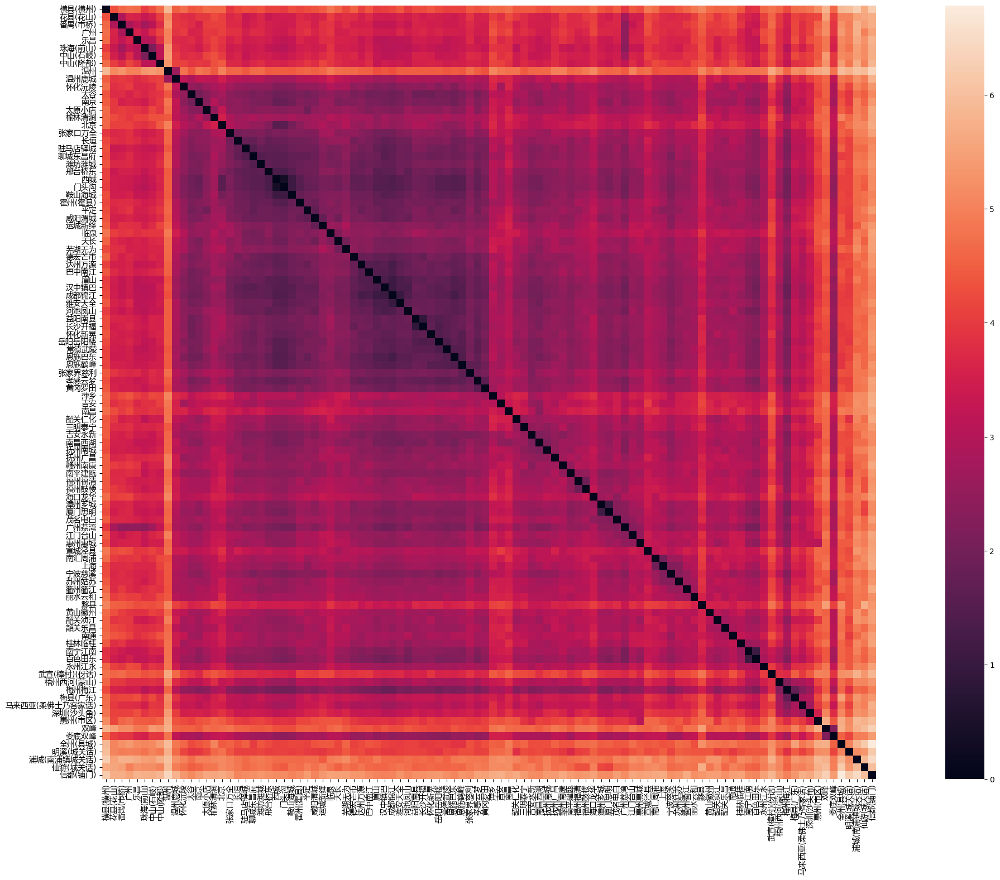

In [17]:
df = dialect[dialect['sample']]
tree = hierarchy.linkage(dialect_emb[df['idx']], method='ward', optimal_ordering=True)
leaves = hierarchy.leaves_list(tree)
df = df.iloc[leaves]
dist = pd.DataFrame(euclidean_distances(dialect_emb[df['idx']]), index=df.index, columns=df.index)

plt.figure(figsize=(32, 18))
plt.xticks(rotation='vertical', family='Microsoft Yahei')
plt.yticks(rotation='horizontal')
sns.heatmap(dist.values, square=True, xticklabels=df['spot'], yticklabels=df['spot'])
plt.show()
plt.close()

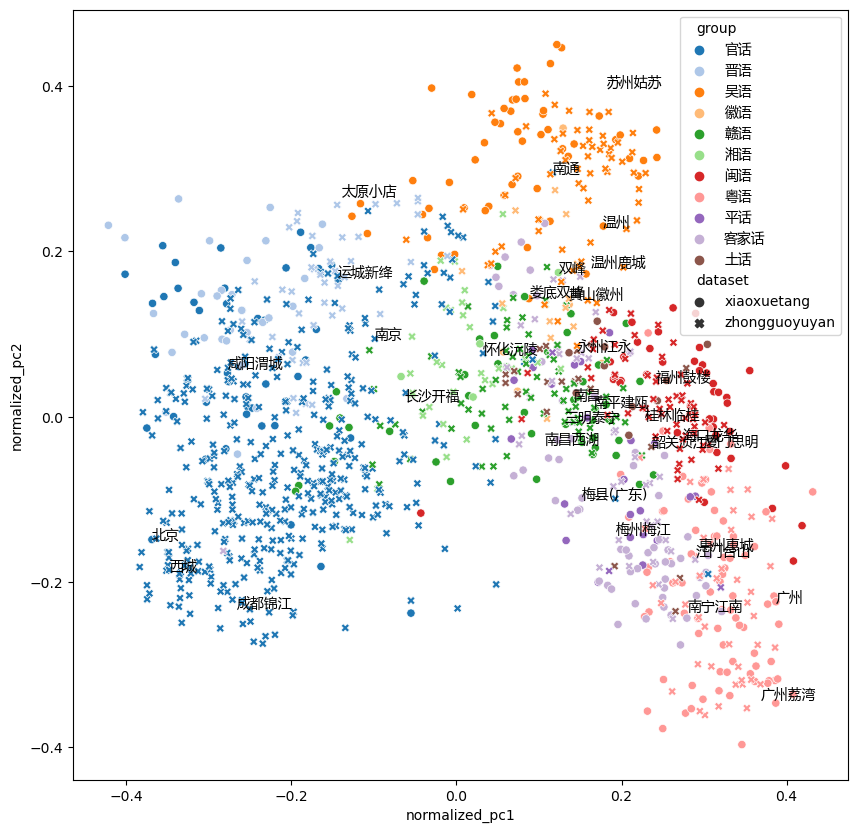

In [18]:
dialect[['normalized_pc1', 'normalized_pc2', 'normalized_pc3']] = PCA(3).fit_transform(normalize(dialect_emb))

plt.figure(figsize=(10, 10))
ax = plt.axes(aspect='equal')
sns.scatterplot(
    dialect[dialect['group'] != ''],
    x='normalized_pc1',
    y='normalized_pc2',
    hue='group',
    style='dataset',
    palette='tab20',
    ax=ax
)

for _, r in dialect[dialect['representative']].iterrows():
    ax.annotate(r['spot'], xy=r[['normalized_pc1', 'normalized_pc2']])

plt.show()
plt.close()

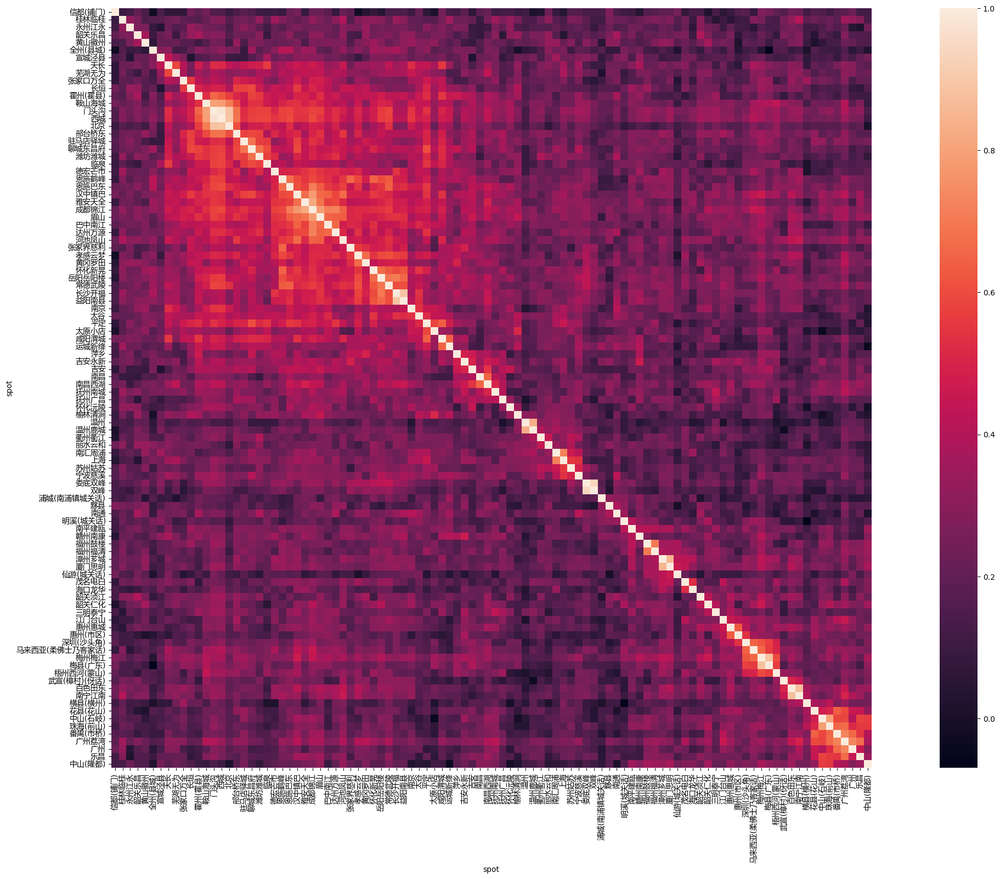

In [19]:
df = dialect[dialect['sample']]
tree = hierarchy.linkage(dialect_emb[df['idx']], method='average', metric='cosine', optimal_ordering=True)
leaves = hierarchy.leaves_list(tree)
df = df.iloc[leaves]
sim = pd.DataFrame(cosine_similarity(dialect_emb[df['idx']]), index=df['spot'], columns=df['spot'])

plt.figure(figsize=(32, 18))
plt.xticks(rotation='vertical')
plt.yticks(rotation='horizontal')
sns.heatmap(sim, square=True, xticklabels=True, yticklabels=True)
plt.show()
plt.close()

In [20]:
for dist in (
    euclidean_distances(dialect_emb[dialect.loc[dialect['representative'], 'idx']], dialect_emb),
    cosine_distances(dialect_emb[dialect.loc[dialect['representative'], 'idx']], dialect_emb)
):
    idx = np.argsort(dist, axis=1)[:, 1:11]
    display(pd.DataFrame(dialect['spot'].values[idx], index=dialect.loc[dialect['representative'], 'spot']))

,0,1,2,3,4,5,6,7,8,9
spot,,,,,,,,,,
北京,西城,门头沟,房山,怀柔,昌平,武清,朝阳凌源,承德平泉,密云,廊坊广阳
温州,温州鹿城,温州永嘉,温州瑞安,温州苍南,温州乐清,温州平阳,丽水青田,温州文成,嵊县崇仁,宁波镇海
南昌,宜春高安,南昌西湖,抚州临川,南昌湾里,景德镇珠山,抚州资溪,鹰潭月湖,乐平,宜春奉新,哈尔滨尚志
双峰,娄底双峰,湘潭湘乡,娄底娄星,娄底涟源,湘潭韶山,邵阳隆回,常德津市,株洲,益阳安化,邵阳新宁
广州,广州荔湾,澳门,广州番禺,,韶关,云浮郁南,南宁,南宁横县,南宁,香港(市区)
梅县(广东),梅州梅江,苗栗,贺州八步,揭阳揭西,香港,宜春铜鼓,河源连平,梅州五华,东莞(清溪),梅州丰顺
厦门思明,厦门思明,泉州永春,台北新北,厦门同安,漳州芗城,泉州安溪,泉州南安,漳州芗城,泉州鲤城,漳州华安
三明泰宁,南平邵武,大田,宿迁宿城,巫溪,巫山,南充营山,奉节,沙坪坝,黔东南凯里,昌平
福州鼓楼,福州闽侯,福州长乐,福州连江,福州永泰,宁德古田,福州福清,宁德寿宁,平潭,福州罗源,大田


,0,1,2,3,4,5,6,7,8,9
spot,,,,,,,,,,
北京,西城,门头沟,昌平,房山,怀柔,武清,朝阳凌源,密云,承德平泉,阜新细河
温州,温州鹿城,温州永嘉,温州瑞安,温州苍南,温州乐清,温州平阳,丽水青田,温州文成,嵊县崇仁,宝山罗店
南昌,宜春高安,南昌西湖,抚州临川,南昌湾里,乐平,景德镇珠山,高安,奉新,抚州资溪,东乡
双峰,娄底双峰,湘潭湘乡,娄底娄星,娄底涟源,湘潭韶山,邵阳隆回,常德津市,株洲,邵阳城步,益阳安化
广州,澳门,广州荔湾,广州番禺,,番禺(市桥),韶关,香港(市区),南宁,曼谷(广府话),云浮郁南
梅县(广东),梅州梅江,苗栗,贺州八步,香港,揭阳揭西,东莞(清溪),三都(江西铜鼓),沙田赤泥坪(香港新界),西贡荔枝庄(香港新界),宜春铜鼓
厦门思明,厦门思明,泉州永春,台北新北,厦门同安,漳州芗城,泉州安溪,漳州,漳州芗城,泉州南安,泉州鲤城
三明泰宁,泰宁(城关话),南平邵武,邵武,宿迁宿城,南平延平,宁德柘荣,抚州南城,大田,吉安永丰,桂林兴安
福州鼓楼,福州闽侯,福州长乐,福州连江,福州永泰,福州,宁德古田,马祖,福州福清,古田,福清


,did
count,94
unique,94
top,X027
freq,1


c:\Users\lerna\AppData\Local\miniconda3\lib\site-packages\sklearn\svm\_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(


,did
count,96
unique,96
top,X027
freq,1


c:\Users\lerna\AppData\Local\miniconda3\lib\site-packages\sklearn\svm\_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(


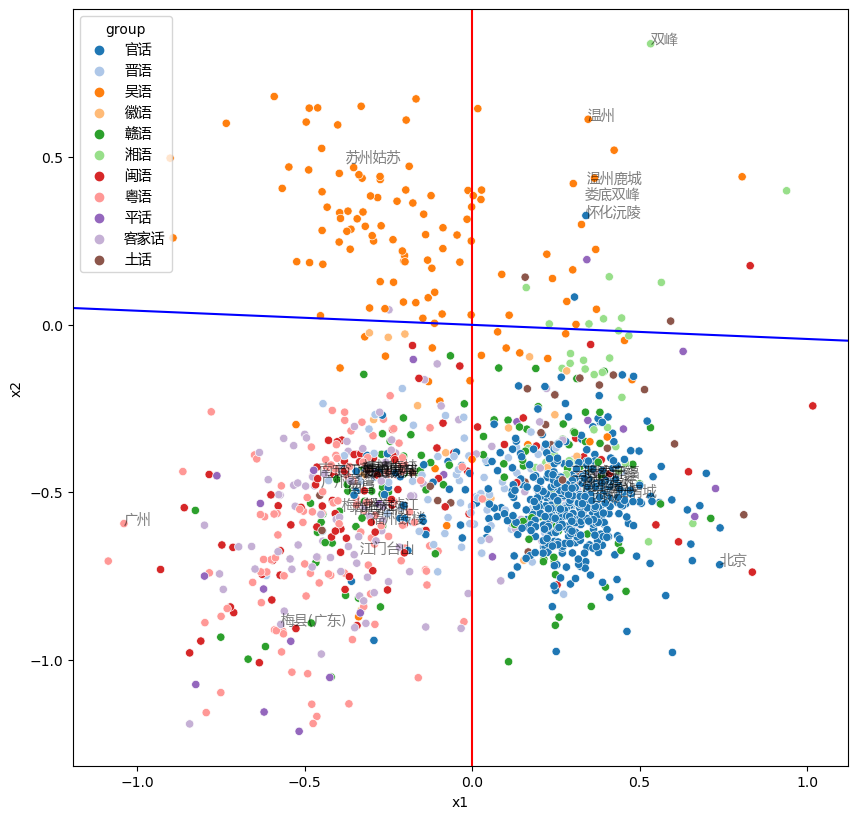

In [21]:
# 一白
train_data = data[data['cid'].isin(['X21129', 'X23424', 'Z0656', 'Z0843']) & data['coda_type'].notna()]
labels = (train_data['coda_type'] == 'plosive').groupby(train_data['did']).any()
train_data = train_data.groupby('did')[dialect_columns].first()
display(train_data.describe())
plosive_svc = LinearSVC(fit_intercept=False).fit(get_emb(dialect_embs, train_data[dialect_columns]), labels)

# 头病
train_data = data[data['cid'].isin(['X8989', 'X19193', 'Z0334', 'Z0860']) & data['initial_voicing'].notna()]
labels = (train_data['initial_voicing'] == 'voiced').groupby(train_data['did']).any()
train_data = train_data.groupby('did')[dialect_columns].first()
display(train_data.describe())
voiced_svc = LinearSVC(fit_intercept=False).fit(get_emb(dialect_embs, train_data[dialect_columns]), labels)

q, _ = np.linalg.qr(np.stack([plosive_svc.coef_[0], voiced_svc.coef_[0]], axis=1))
dialect[['x1', 'x2']] = dialect_emb @ q

plt.figure(figsize=(10, 10))
ax = plt.axes(aspect='equal')

sns.scatterplot(dialect[dialect['group'] != ''], x='x1', y='x2', hue='group', palette='tab20', ax=ax)
for _, r in dialect[dialect['representative']].iterrows():
    ax.annotate(r['spot'], xy=r[['x1', 'x2']], alpha=0.5)

ax.axvline(0, color='red')
a = voiced_svc.coef_[0] @ q
ax.axline([0, 0], slope=-a[0] / a[1], color='blue')

plt.show()
plt.close()

In [22]:
group_data = dialect[~dialect['group'].isin(['', '土话'])]
_, idx = next(StratifiedShuffleSplit(n_splits=1, test_size=0.2).split(group_data, group_data['group']))
group_data.loc[group_data.iloc[idx].index, 'test'] = True
group_data['test'].fillna(False, inplace=True)
display(group_data.describe())

group_lr = LogisticRegression(fit_intercept=False)
group_svc = LinearSVC(fit_intercept=False)
group_tree = DecisionTreeClassifier()
group_knn = KNeighborsClassifier(metric='cosine')

for name, classifier in ('lr', group_lr), ('svc', group_svc), ('tree', group_tree), ('knn', group_knn):
    group_data[name] = classifier.fit(
        dialect_emb[group_data.loc[~group_data['test'], 'idx']],
        group_data.loc[~group_data['test'], 'group']
    ).predict(dialect_emb[group_data['idx']])

for name in ('lr', 'svc', 'tree', 'knn'):
    print(classification_report(
        group_data.loc[group_data['test'], 'group'],
        group_data.loc[group_data['test'], name]
    ))

,latitude,longitude,idx,pc1,pc2,pc3,pc4,tsne1,tsne2,umap1,umap2,normalized_pc1,normalized_pc2,normalized_pc3,x1,x2
count,1179.000000,1179.000000,1179.000000,1179.000000,1179.000000,1179.000000,1179.000000,1179.000000,1179.000000,1179.000000,1179.000000,1179.000000,1179.000000,1179.000000,1179.000000,1179.000000
mean,29.680991,113.616126,754.394402,0.014946,-0.006181,-0.008758,0.032914,1.674450,-0.146899,-0.832438,4.891452,0.000754,-0.000029,0.000260,0.013136,-0.447087
std,6.304314,5.654703,506.214510,0.561507,0.435050,0.432821,0.398007,23.124353,22.708128,2.622206,3.003308,0.221679,0.163874,0.152573,0.360355,0.300557
min,1.620287,84.808333,0.000000,-1.009099,-0.911391,-1.792739,-1.053946,-39.890766,-51.229340,-4.939511,-1.903940,-0.421482,-0.397212,-0.308262,-1.086097,-1.213347
25%,25.255901,110.343203,294.500000,-0.363454,-0.304767,-0.184287,-0.187366,-16.016612,-16.671912,-2.256558,3.507595,-0.203044,-0.117790,-0.111052,-0.296152,-0.600162
50%,29.025064,113.950523,718.000000,-0.196089,-0.121977,-0.040420,-0.043415,-1.389088,3.280658,-1.114135,4.834052,0.014687,-0.003840,-0.018980,0.122001,-0.498012
75%,32.495833,117.583333,1219.500000,0.314231,0.186336,0.132500,0.141904,16.577500,15.914998,0.115478,7.209887,0.197584,0.104997,0.098353,0.313511,-0.386164
max,113.158419,133.208333,1694.000000,1.648481,1.921466,1.821729,1.575056,55.981857,47.524754,8.370139,10.209610,0.431589,0.450590,0.378142,1.016931,0.839061


c:\Users\lerna\AppData\Local\miniconda3\lib\site-packages\sklearn\svm\_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(


              precision    recall  f1-score   support

          吴语       1.00      0.92      0.96        24
          官话       0.89      0.98      0.93        92
         客家话       0.90      0.90      0.90        20
          平话       0.50      0.40      0.44         5
          徽语       1.00      0.75      0.86         4
          晋语       0.83      0.67      0.74        15
          湘语       0.86      0.86      0.86         7
          粤语       0.89      0.96      0.92        25
          赣语       0.89      0.74      0.81        23
          闽语       0.95      0.95      0.95        21

    accuracy                           0.90       236
   macro avg       0.87      0.81      0.84       236
weighted avg       0.90      0.90      0.89       236

              precision    recall  f1-score   support

          吴语       1.00      0.92      0.96        24
          官话       0.92      0.97      0.94        92
         客家话       1.00      0.90      0.95        20
          平话       0.50 

In [23]:
display(group_data.loc[
    group_data['test'] & np.any([group_data[n] != group_data['group'] for n in ('lr', 'svc', 'knn')], axis=0),
    ['dataset', 'group', 'subgroup', 'cluster', 'subcluster', 'spot', 'lr', 'svc', 'knn']
].sort_values('group'))

,dataset,group,subgroup,cluster,subcluster,spot,lr,svc,knn
did,,,,,,,,,
Z21E49,zhongguoyuyan,吴语,,宣州片,铜泾,芜湖繁昌,官话,官话,吴语
X110,xiaoxuetang,吴语,,太湖片,毗陵小片,金坛西岗,官话,赣语,官话
X029,xiaoxuetang,官话,,广灵片,,广灵,官话,官话,晋语
Z26A38,zhongguoyuyan,官话,西南官话,怀靖片,怀凤小片,湘西凤凰,晋语,赣语,官话
Z26A57,zhongguoyuyan,官话,西南官话,,黔北,怀化芷江,官话,湘语,官话
Z12A93,zhongguoyuyan,官话,中原官话,汾河片,平阳小片,临汾翼城,晋语,晋语,官话
Z26A56,zhongguoyuyan,客家话,,铜桂片,,株洲攸县,赣语,赣语,赣语
Z02A08,zhongguoyuyan,客家话,,闽西片,连城,龙岩连城,闽语,闽语,客家话
X360,xiaoxuetang,平话,,桂南片,东南小片,藤县(藤城),粤语,粤语,平话


C:\Users\lerna\AppData\Local\Temp\ipykernel_7368\3169641533.py:9: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(pc[mask, 0], pc[mask, 1], pc[mask, 2], label=g, cmap='tab20')


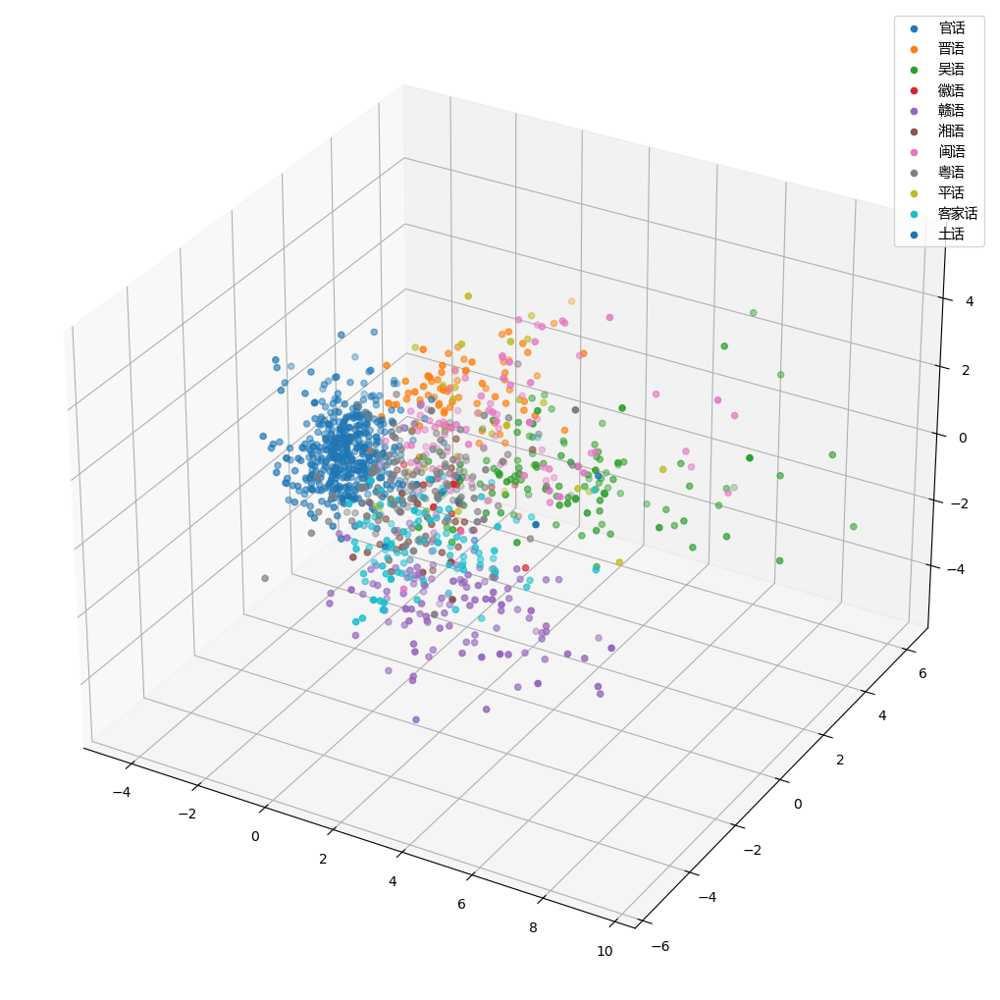

In [24]:
pc = PCA(3).fit_transform(group_svc.decision_function(dialect_emb))

fig = plt.figure(figsize=(10, 10))
ax = mplot3d.Axes3D(fig)
fig.add_axes(ax)

for g in dialect.loc[dialect['group'] != '', 'group'].unique():
    mask = (dialect['group'] == g)
    ax.scatter(pc[mask, 0], pc[mask, 1], pc[mask, 2], label=g, cmap='tab20')

ax.legend(loc='upper right')
plt.show()

ani = animation.FuncAnimation(
    fig,
    functools.partial(rotate, ax=ax),
    np.arange(45, 405, 5),
    interval=200,
    repeat_delay=200
)
ani.save('方言编码SVM变换PCA降维三维散点图.gif')
plt.close()

,latitude,longitude,idx,pc1,pc2,pc3,pc4,tsne1,tsne2,umap1,umap2,normalized_pc1,normalized_pc2,normalized_pc3,x1,x2
count,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000
mean,33.118598,111.930455,922.129670,-0.328460,-0.256269,-0.058067,-0.073501,-6.198225,-3.543357,-0.463455,6.238698,-0.208912,-0.046431,0.015609,0.269502,-0.528655
std,5.475245,7.380164,455.278961,0.169894,0.177793,0.129077,0.132815,13.971210,19.030191,1.394611,2.371572,0.102013,0.118616,0.205561,0.176870,0.120179
min,18.575000,84.808333,0.000000,-1.009099,-0.871498,-0.448365,-0.620639,-39.890766,-36.129219,-2.852180,-1.531993,-0.401271,-0.274923,-0.308262,-0.446949,-0.977791
25%,29.815117,106.161661,587.000000,-0.423669,-0.373898,-0.145474,-0.150646,-14.384977,-22.065473,-1.736535,3.968891,-0.280254,-0.132095,-0.183958,0.217559,-0.595292
50%,32.025000,111.600000,963.000000,-0.316059,-0.276800,-0.067705,-0.073835,-3.802459,2.303159,-0.671323,6.305851,-0.220860,-0.062214,0.010694,0.298454,-0.530478
75%,36.107427,117.095095,1289.500000,-0.234342,-0.175039,0.021753,0.011271,2.616647,13.983890,0.768516,8.372039,-0.149755,0.033402,0.212965,0.370574,-0.468991
max,52.858333,133.208333,1694.000000,0.705033,0.516256,0.413670,0.394049,44.599075,26.943743,2.456319,10.209610,0.305016,0.295699,0.378142,0.740194,0.083061


C:\Users\lerna\AppData\Local\Temp\ipykernel_7368\2216746556.py:12: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(df['pc1'], df['pc2'], df['pc3'], cmap='tab10', label=g)


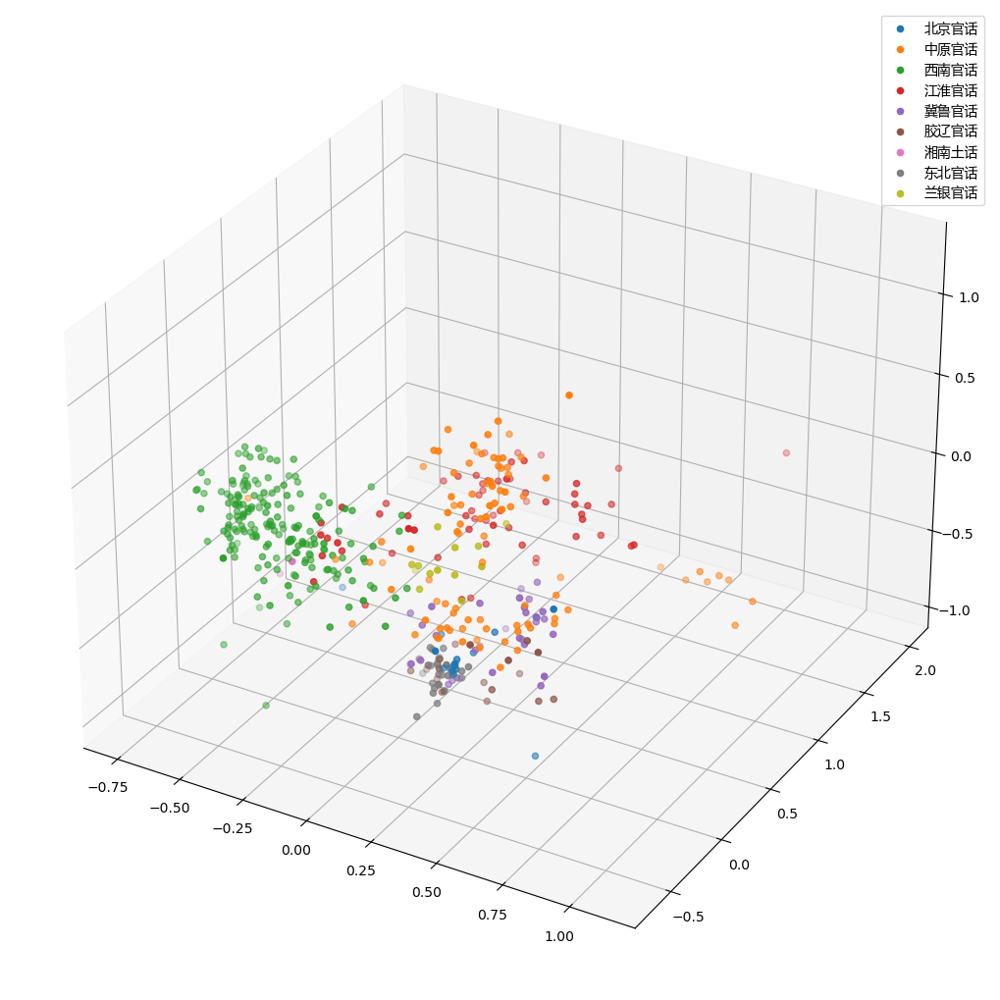

In [25]:
mandarin = dialect[(dialect['group'] == '官话') & (dialect['subgroup'] != '')]
display(mandarin.describe())

mandarin[['pc1', 'pc2', 'pc3']] = PCA(3).fit_transform(dialect_emb[mandarin['idx']])

fig = plt.figure(figsize=(10, 10))
ax = mplot3d.Axes3D(fig)
fig.add_axes(ax)

for g in mandarin['subgroup'].unique():
    df = mandarin[mandarin['subgroup'] == g]
    ax.scatter(df['pc1'], df['pc2'], df['pc3'], cmap='tab10', label=g)

ax.legend(loc='upper right')
plt.show()

ani = animation.FuncAnimation(
    fig,
    functools.partial(rotate, ax=ax),
    np.arange(45, 405, 5),
    interval=200,
    repeat_delay=200
)
ani.save('官话方言编码PCA降维三维散点图.gif')
plt.close()

In [26]:
_, idx = next(StratifiedShuffleSplit(n_splits=1, test_size=0.2).split(mandarin, mandarin['subgroup']))
mandarin.loc[mandarin.iloc[idx].index, 'test'] = True
mandarin['test'].fillna(False, inplace=True)

subgroup_lr = LogisticRegression(fit_intercept=False)
subgroup_svc = LinearSVC(fit_intercept=False)
subgroup_tree = DecisionTreeClassifier()
subgroup_knn = KNeighborsClassifier(metric='cosine')

for name, classifier in ('lr', subgroup_lr), ('svc', subgroup_svc), ('tree', subgroup_tree), ('knn', subgroup_knn):
    mandarin[name] = classifier.fit(
        dialect_emb[mandarin.loc[~mandarin['test'], 'idx']],
        mandarin.loc[~mandarin['test'], 'subgroup']
    ).predict(dialect_emb[mandarin['idx']])

for name in ('lr', 'svc', 'tree', 'knn'):
    print(classification_report(
        mandarin.loc[mandarin['test'], 'subgroup'],
        mandarin.loc[mandarin['test'], name]
    ))

c:\Users\lerna\AppData\Local\miniconda3\lib\site-packages\sklearn\svm\_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
c:\Users\lerna\AppData\Local\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\lerna\AppData\Local\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\lerna\AppData\Local\miniconda3\lib\site-packages\sklearn\metrics\_classification.

              precision    recall  f1-score   support

        东北官话       0.88      1.00      0.93         7
        中原官话       0.75      0.95      0.84        19
        兰银官话       0.00      0.00      0.00         3
        冀鲁官话       0.80      0.67      0.73         6
        北京官话       1.00      0.67      0.80         3
        江淮官话       1.00      0.92      0.96        13
        胶辽官话       0.50      0.33      0.40         3
        西南官话       0.97      1.00      0.99        37

    accuracy                           0.89        91
   macro avg       0.74      0.69      0.71        91
weighted avg       0.86      0.89      0.87        91

              precision    recall  f1-score   support

        东北官话       0.88      1.00      0.93         7
        中原官话       0.73      0.84      0.78        19
        兰银官话       0.67      0.67      0.67         3
        冀鲁官话       0.67      0.67      0.67         6
        北京官话       1.00      0.33      0.50         3
        江淮官话       1.00 

In [27]:
display(mandarin.loc[
    mandarin['test'] & np.any([mandarin[n] != mandarin['subgroup'] for n in ('lr', 'svc', 'knn')], axis=0),
    ['dataset', 'group', 'subgroup', 'cluster', 'subcluster', 'spot', 'lr', 'svc', 'knn']
].sort_values('subgroup'))

,dataset,group,subgroup,cluster,subcluster,spot,lr,svc,knn
did,,,,,,,,,
X038,xiaoxuetang,官话,中原官话,汾河片,平阳小片,霍州(霍县),中原官话,中原官话,北京官话
Z14A67,zhongguoyuyan,官话,中原官话,秦陇片,陇东小片,白银靖远,中原官话,冀鲁官话,中原官话
Z14E68,zhongguoyuyan,官话,中原官话,秦陇片,庆阳小片,庆阳庆城,中原官话,兰银官话,中原官话
Z21A31,zhongguoyuyan,官话,中原官话,商阜片,亳州方言,亳州谯城,中原官话,中原官话,冀鲁官话
Z35H12,zhongguoyuyan,官话,中原官话,信蚌片,,东方,西南官话,胶辽官话,胶辽官话
Z06K06,zhongguoyuyan,官话,中原官话,兖菏片,,菏泽曹县,中原官话,中原官话,冀鲁官话
Z31N03,zhongguoyuyan,官话,兰银官话,北疆片,,昌吉玛纳斯,中原官话,兰银官话,兰银官话
Z31C87,zhongguoyuyan,官话,兰银官话,北疆片,,昌吉奇台,中原官话,兰银官话,兰银官话
Z14E69,zhongguoyuyan,官话,兰银官话,河西片,武威小片,金昌永昌,中原官话,中原官话,中原官话


C:\Users\lerna\AppData\Local\Temp\ipykernel_7368\882826679.py:9: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(pc[mask, 0], pc[mask, 1], pc[mask, 2], label=g, cmap='tab10')


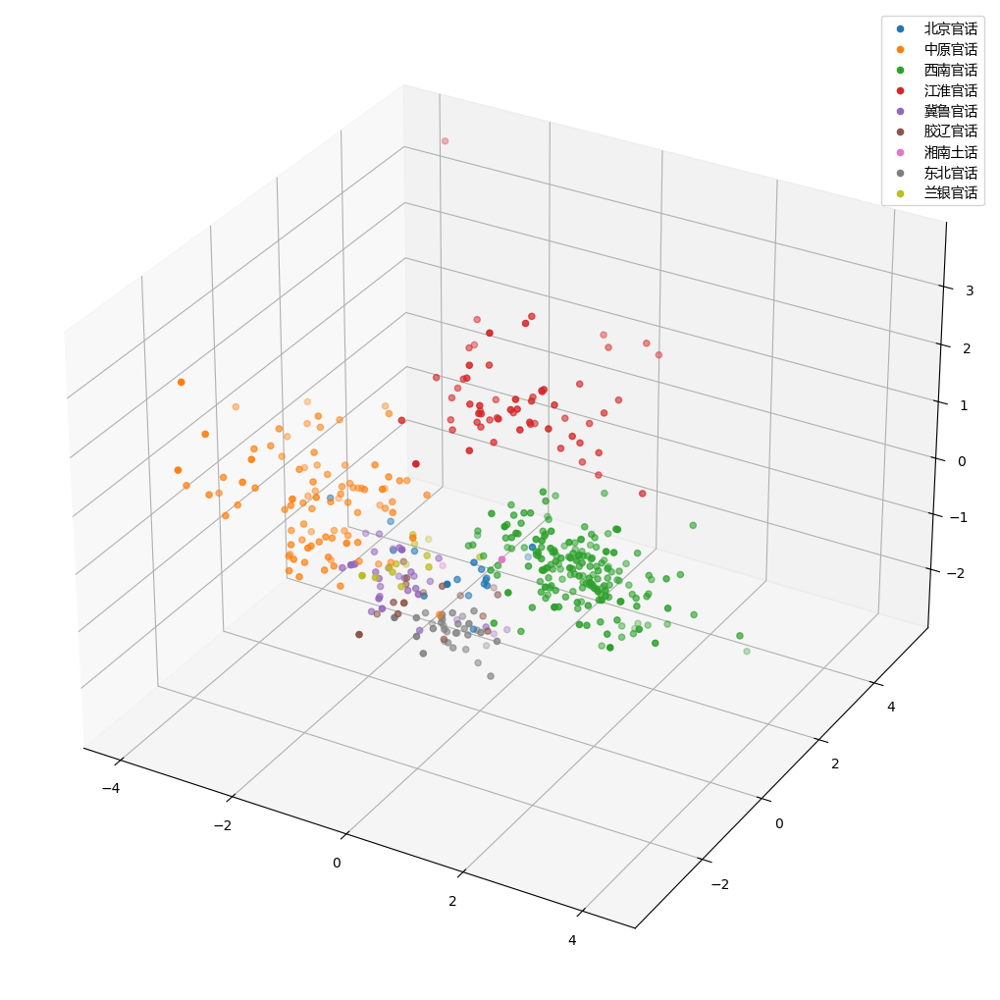

In [28]:
pc = PCA(3).fit_transform(subgroup_svc.decision_function(dialect_emb[mandarin['idx']]))

fig = plt.figure(figsize=(10, 10))
ax = mplot3d.Axes3D(fig)
fig.add_axes(ax)

for g in mandarin['subgroup'].unique():
    mask = (mandarin['subgroup'] == g)
    ax.scatter(pc[mask, 0], pc[mask, 1], pc[mask, 2], label=g, cmap='tab10')

ax.legend(loc='upper right')
plt.show()

ani = animation.FuncAnimation(
    fig,
    functools.partial(rotate, ax=ax),
    np.arange(45, 405, 5),
    interval=200,
    repeat_delay=200
)
ani.save('官话方言编码SVM变换PCA降维三维散点图.gif')
plt.close()

In [29]:
for classifier in (group_svc, subgroup_svc):
    output_emb = transform(
        np.tile(classifier.coef_, [char[char['representative']].shape[0], 1]),
        np.repeat(char_emb[char.loc[char['representative'], 'idx']], classifier.coef_.shape[0], axis=0),
        weight
    )
    output = get_output(output_embs, output_emb)
    display(pd.DataFrame(
        np.apply_along_axis(''.join, -1, output).reshape([-1, classifier.coef_.shape[0]]),
        index=char.loc[char['representative'], 'character'],
        columns=classifier.classes_
    ))

,吴语,官话,客家话,平话,徽语,晋语,湘语,粤语,赣语,闽语
character,,,,,,,,,,
頭,dʑuŋ231,tɕʰuŋ5,tɕʰuŋ5,tsuŋ52,tɕʰuŋ41,ti24,tɕuŋ22,fuŋ52,tɕʰyɛn5,ti24
三,tɕʰuŋ52,tɕʰuŋ5,tɕʰuŋ5,tɕʰuŋ52,tɕʰuŋ11,ti24,tɕʰuŋ33,tɕʰuŋ52,xuŋ22,ti24
重,dʑam231,xuŋ5,tɕʰuŋ5,xai32,tɕʰam41,ti24,ɣam52,tɕʰam5,tɕʰyɛn2,ti24
有,dʑam231,tɕʰuŋ5,tɕʰuŋ5,xuŋ32,tɕʰam41,ti24,tɕʰuŋ52,kʷʰuŋ5,tɕʰam51,ti24
狗,dʑuŋ52,tɕʰuŋ52,tɕʰuŋ31,θuŋ33,tɕʰuŋ4,ti24,tɕʰuŋ52,kʷʰuŋ5,tɕʰiɛn5,ti24
病,ɡam231,xuŋ5,tɕʰuŋ51,xam52,tɕʰam33,ti24,ɣuŋ5,fuŋ22,tɕʰam5,ti24
一,tɕʰuŋ5,tɕʰuŋ52,tɕʰuŋ41,xuŋ52,xam435,ti24,tɕʰuŋ33,kʷʰam5,tɕʰuŋ51,ti24
白,ɡuŋ12,xuŋ52,tɕʰuŋ5,xuŋ22,tɕʰuŋ33,ti24,tɕʰuŋ32,fuŋ52,xuŋ22,ti24
买,dʑuŋ231,tɕʰuŋ5,tɕʰuŋ41,tɕʰuŋ33,tɕʰuŋ11,ti24,tɕʰuŋ42,fuŋ22,tɕʰam44,ti24


,东北官话,中原官话,兰银官话,冀鲁官话,北京官话,江淮官话,湘南土话,胶辽官话,西南官话
character,,,,,,,,,
頭,pi24,zi42,vuŋ5,ti24,tɕʰu,tɕʰu,ti24,ti24,ti24
三,ti44,zəŋ1,dʑuŋ,ti24,tɕʰu,tɕʰu,ti24,ti21,ti24
重,pi13,fəŋ4,ɣæ51,ti24,xuŋ5,tɕʰu,ti24,mi21,ti24
有,təŋ1,zã2,vuŋ5,ti24,tɕʰu,tɕʰu,ti24,ti21,ti24
狗,ti44,pfɔ̃,vuŋ5,ti24,tɕʰu,tɕʰu,ti24,ti21,ti24
病,ti13,tsʰɛ,ɡuŋ5,ti24,tɕʰu,tɕʰu,ti24,ti45,ti24
一,ti24,zəŋ4,tʰuŋ,ti24,xuŋ5,tɕʰu,ti24,ti24,ti24
白,ti24,fei4,vuŋ5,ti24,tɕʰu,xuŋ5,ti24,ti24,ti24
买,jau4,zʮ24,vuŋ5,ti24,tɕʰu,tɕʰu,ti24,təŋ2,ti24


In [30]:
train_data, test_data = train_test_split(char[char['coda_type'] != ''], train_size=0.05)
display(train_data.describe())
plosive_svc = LinearSVC(fit_intercept=False).fit(char_emb[train_data['idx']], train_data['coda_type'] == 'plosive')
print(classification_report(test_data['coda_type'] == 'plosive', plosive_svc.predict(char_emb[test_data['idx']])))

train_data, test_data = train_test_split(char[char['initial_voicing'] != ''], train_size=0.05)
display(train_data.describe())
voiced_svc = LinearSVC(fit_intercept=False).fit(char_emb[train_data['idx']], train_data['initial_voicing'])
print(classification_report(test_data['initial_voicing'], voiced_svc.predict(char_emb[test_data['idx']])))

,frequency,idx,pc1,pc2,pc3,pc4,tsne1,tsne2,umap1,umap2
count,166.000000,213.000000,213.000000,213.000000,213.000000,213.000000,213.000000,213.000000,213.000000,213.000000
mean,240.259036,4790.530516,0.008508,0.022614,-0.027953,-0.016620,-19.933805,-1.546254,9.784709,4.065248
std,86.294698,2745.095672,0.240660,0.185340,0.187267,0.178973,26.559183,47.903114,4.366858,5.057269
min,18.000000,39.000000,-0.518174,-0.546961,-0.567422,-0.599953,-79.032692,-87.193245,1.861476,-2.641363
25%,195.250000,2298.000000,-0.145397,-0.083916,-0.160762,-0.131278,-37.816803,-40.792343,6.648843,-0.101168
50%,242.000000,4647.000000,-0.029358,0.017198,-0.026051,-0.021303,-16.330481,-3.267547,9.469894,2.188949
75%,307.250000,7443.000000,0.053781,0.116811,0.092242,0.099827,1.344935,35.860985,13.702550,8.399189
max,425.000000,8750.000000,0.772919,0.740124,0.477378,0.634112,30.871023,92.745476,17.061277,13.732666


              precision    recall  f1-score   support

       False       1.00      1.00      1.00      3379
        True       0.98      0.99      0.99       668

    accuracy                           1.00      4047
   macro avg       0.99      0.99      0.99      4047
weighted avg       1.00      1.00      1.00      4047



c:\Users\lerna\AppData\Local\miniconda3\lib\site-packages\sklearn\svm\_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(


,frequency,idx,pc1,pc2,pc3,pc4,tsne1,tsne2,umap1,umap2
count,142.000000,187.000000,187.000000,187.000000,187.000000,187.000000,187.000000,187.000000,187.000000,187.000000
mean,246.443662,4932.224599,0.003288,0.009717,0.008973,0.006686,-21.519487,-4.712612,9.665206,4.033133
std,86.192143,2661.427480,0.237026,0.189148,0.205510,0.188307,27.265890,45.816536,4.220981,4.722132
min,17.000000,62.000000,-0.459458,-0.568453,-0.516065,-0.574600,-79.213005,-83.220154,1.938557,-2.616338
25%,186.250000,2907.500000,-0.150448,-0.115269,-0.153844,-0.100814,-43.923576,-41.768740,6.319168,0.182792
50%,230.000000,5124.000000,-0.023507,0.026634,0.017925,-0.008741,-21.806650,-3.024515,9.358403,2.615994
75%,313.500000,7561.500000,0.061648,0.107526,0.140872,0.128429,0.189456,27.904357,13.314639,7.653959
max,439.000000,8757.000000,0.778443,0.634605,0.595438,0.684886,30.857880,82.754761,17.064789,14.082713


c:\Users\lerna\AppData\Local\miniconda3\lib\site-packages\sklearn\svm\_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(


              precision    recall  f1-score   support

      voiced       0.98      0.98      0.98      1657
   voiceless       0.98      0.98      0.98      1899

    accuracy                           0.98      3556
   macro avg       0.98      0.98      0.98      3556
weighted avg       0.98      0.98      0.98      3556



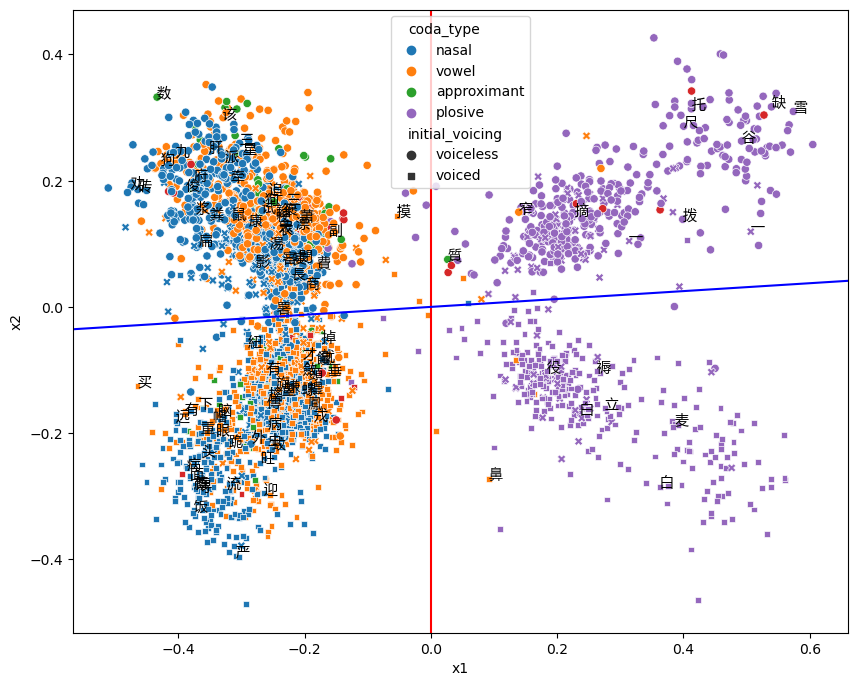

In [31]:
q, _ = np.linalg.qr(np.stack([plosive_svc.coef_[0], voiced_svc.coef_[0]], axis=1))
char[['x1', 'x2']] = char_emb @ q

plt.figure(figsize=(10, 10))
ax = plt.axes(aspect='equal')

sns.scatterplot(
    char[(char['coda_type'] != '') | (char['initial_voicing'] != '')],
    x='x1',
    y='x2',
    hue='coda_type',
    style='initial_voicing',
    palette='tab10',
    ax=ax
)

for _, r in char[char['sample']].iterrows():
    ax.annotate(r['character'], xy=r[['x1', 'x2']])

ax.axvline(0, color='red')
a = voiced_svc.coef_[0] @ q
ax.axline([0, 0], slope=-a[0] / a[1], color='blue')

plt.show()
plt.close()

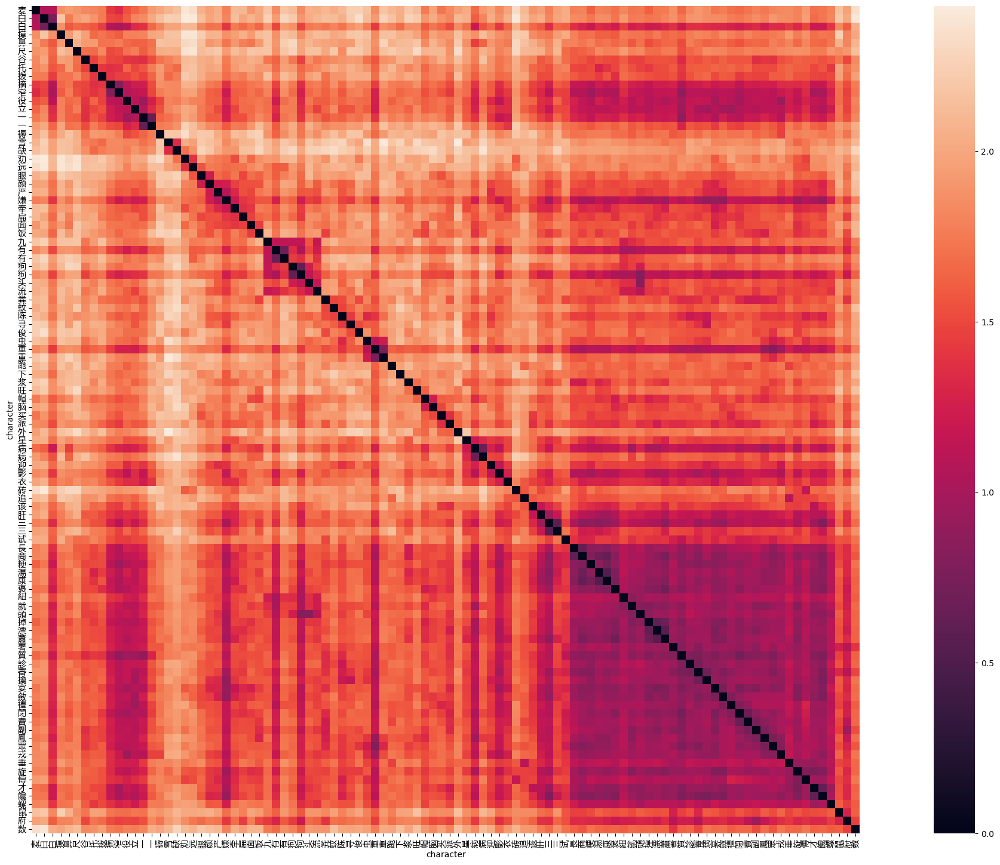

In [32]:
df = char[char['sample']]
tree = hierarchy.linkage(char_emb[df['idx']], method='ward', optimal_ordering=True)
leaves = hierarchy.leaves_list(tree)
df = df.iloc[leaves]
dist = pd.DataFrame(euclidean_distances(char_emb[df['idx']]), index=df['character'], columns=df['character'])

plt.figure(figsize=(32, 18))
plt.xticks(rotation='vertical')
plt.yticks(rotation='horizontal')
sns.heatmap(dist, square=True, xticklabels=True, yticklabels=True)
plt.show()
plt.close()

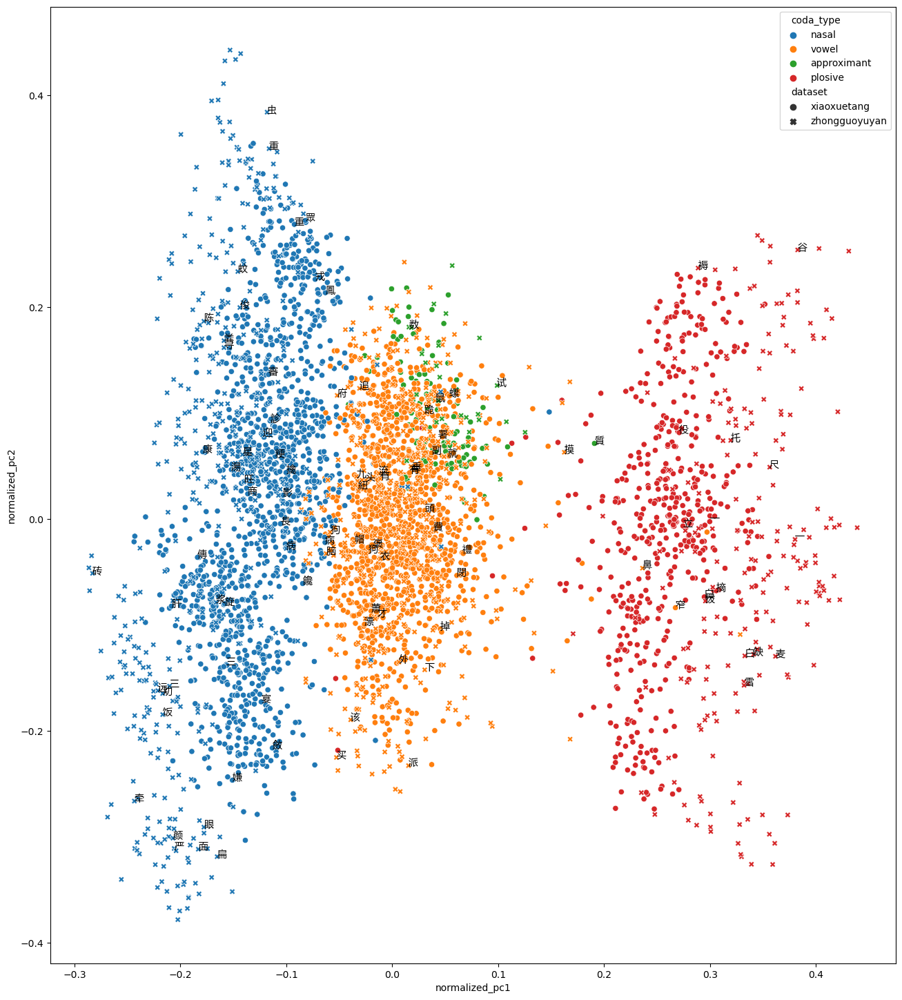

In [33]:
normalized_char_emb = normalize(char_emb)
char[['normalized_pc1', 'normalized_pc2']] = PCA(2) \
    .fit(normalized_char_emb[char['dataset'] == 'zhongguoyuyan']) \
    .transform(normalized_char_emb)

plt.figure(figsize=(32, 18))
ax = plt.axes(aspect='equal')

sns.scatterplot(
    char[char['coda_type'] != ''],
    x='normalized_pc1',
    y='normalized_pc2',
    hue='coda_type',
    style='dataset',
    palette='tab10',
    ax=ax
)

for _, r in char[char['sample']].iterrows():
    ax.annotate(r['character'], xy=r[['normalized_pc1', 'normalized_pc2']])

plt.show()
plt.close()

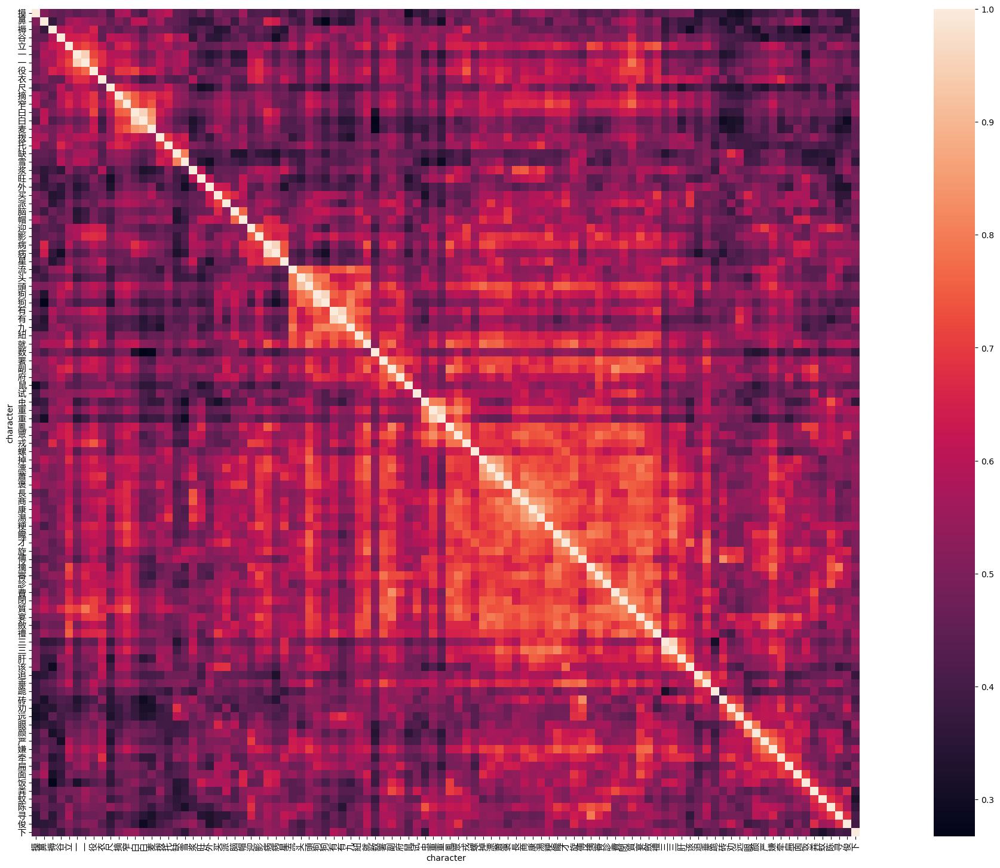

In [34]:
df = char[char['sample']]
tree = hierarchy.linkage(char_emb[df['idx']], method='average', metric='cosine', optimal_ordering=True)
leaves = hierarchy.leaves_list(tree)
df = df.iloc[leaves]
sim = pd.DataFrame(cosine_similarity(char_emb[df['idx']]), index=df['character'], columns=df['character'])

plt.figure(figsize=(32, 18))
plt.xticks(rotation='vertical')
plt.yticks(rotation='horizontal')
sns.heatmap(sim, square=True, xticklabels=True, yticklabels=True)
plt.show()
plt.close()

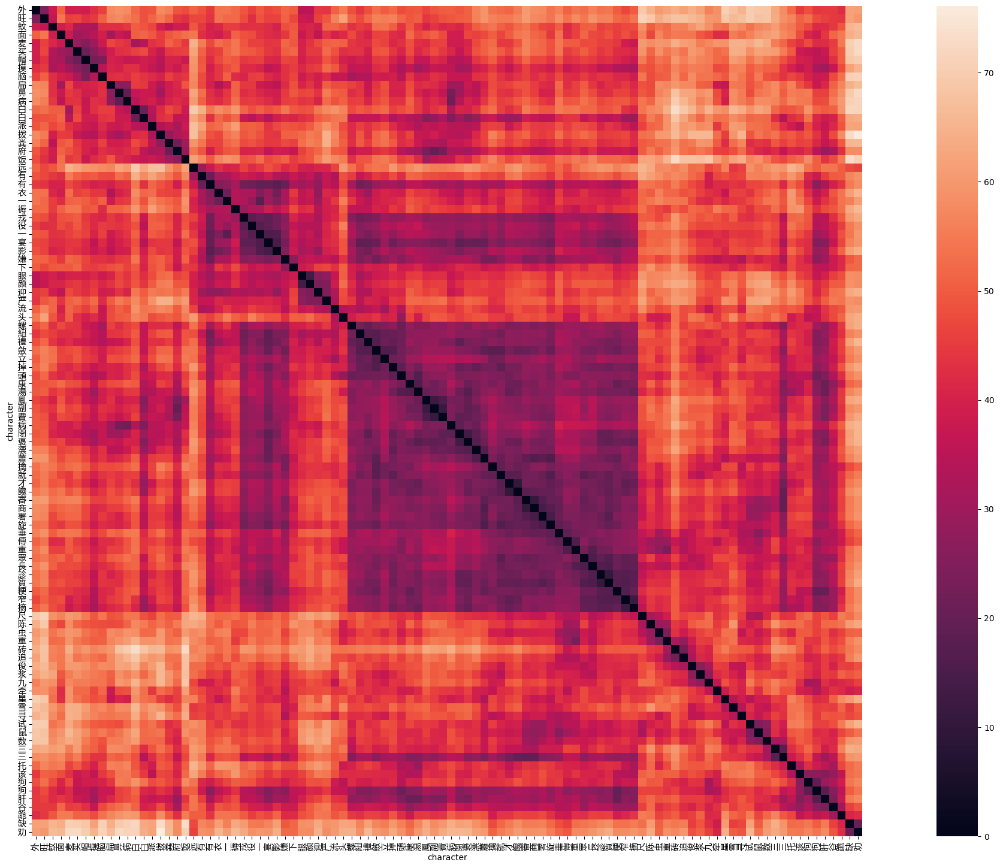

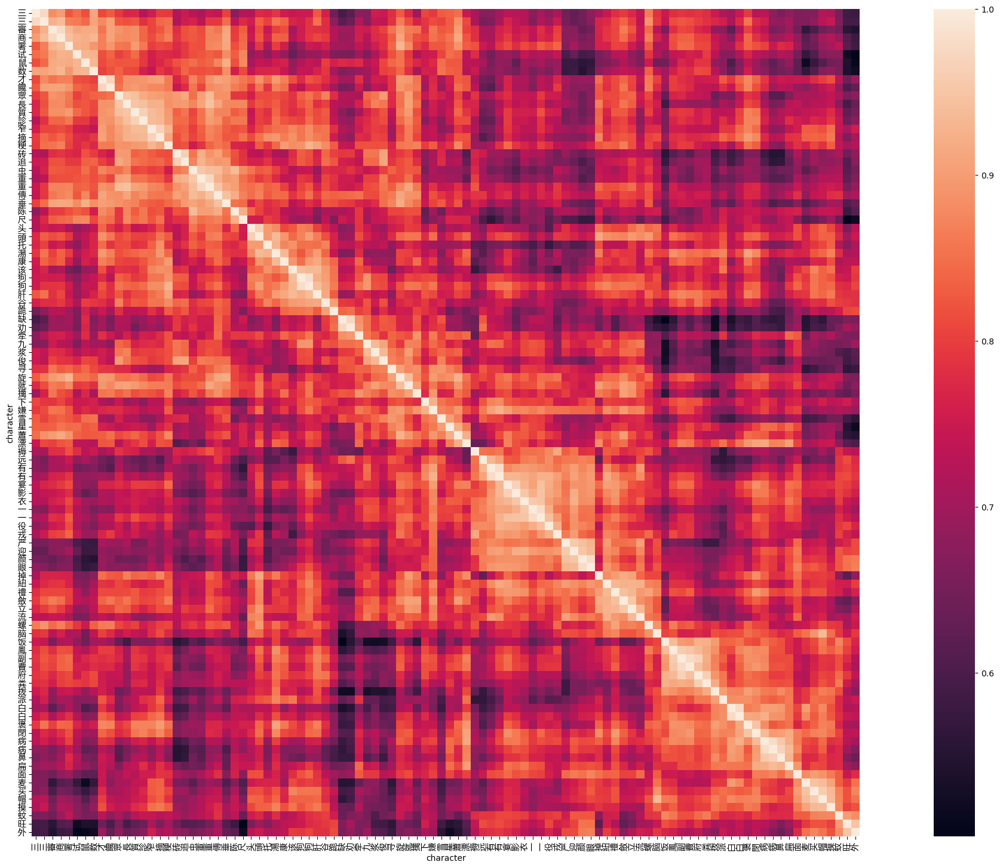

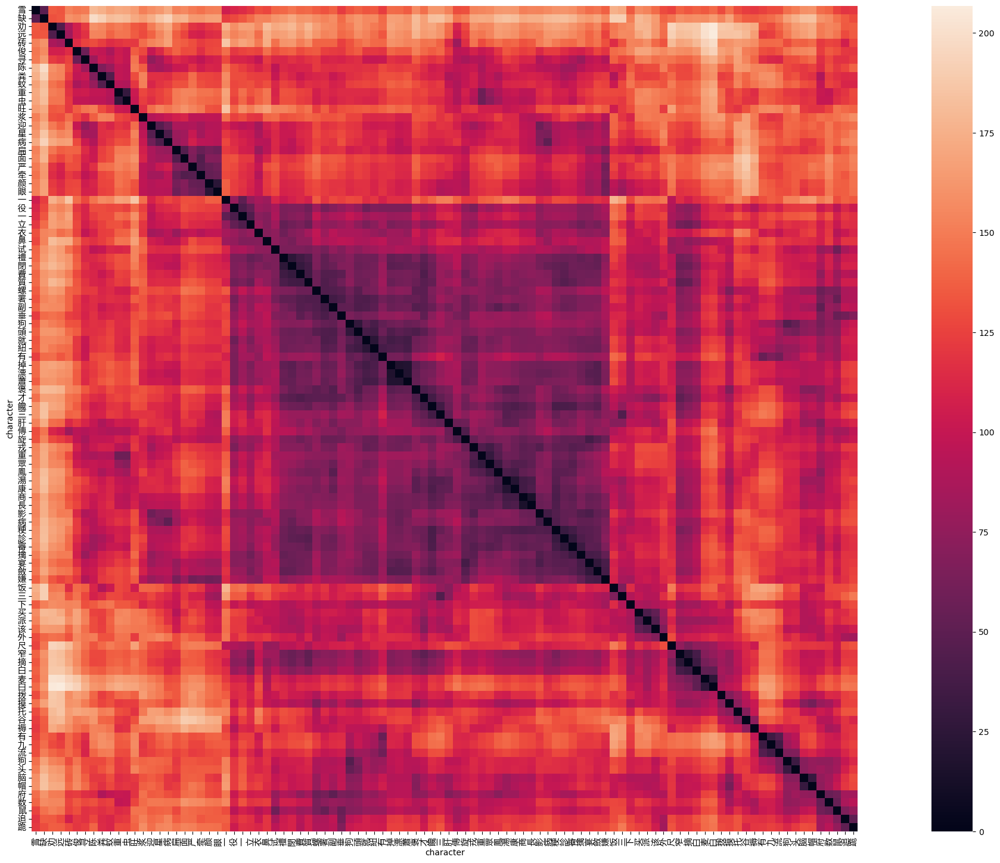

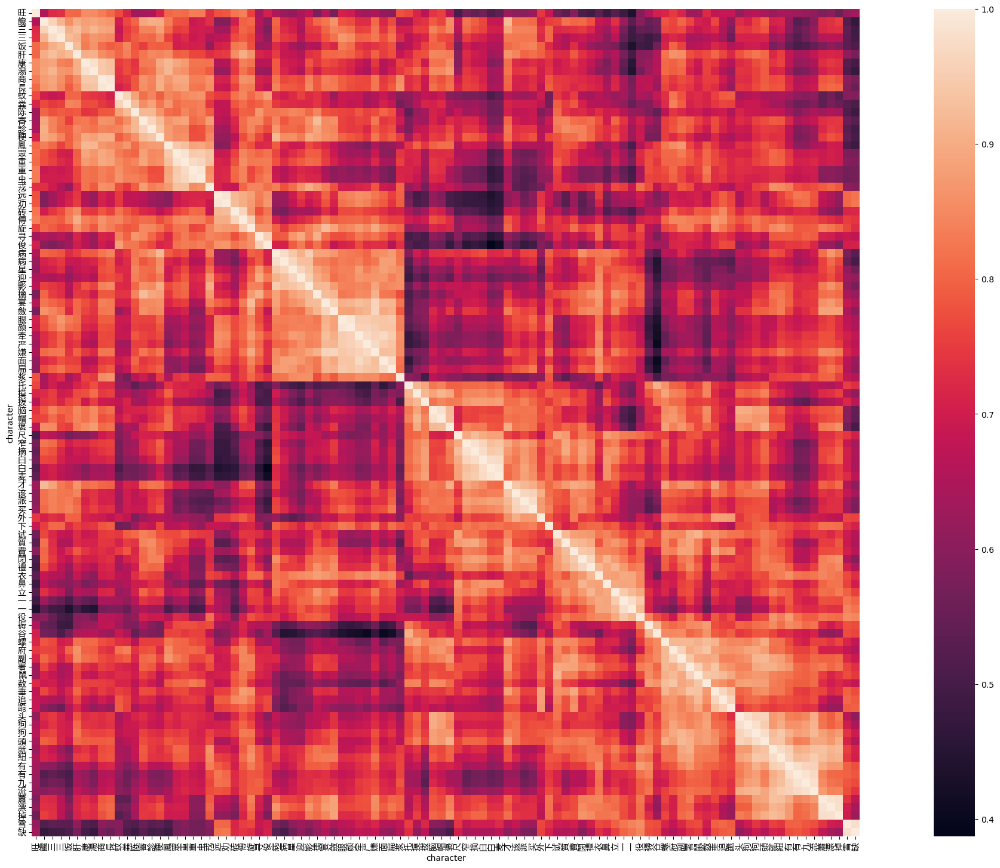

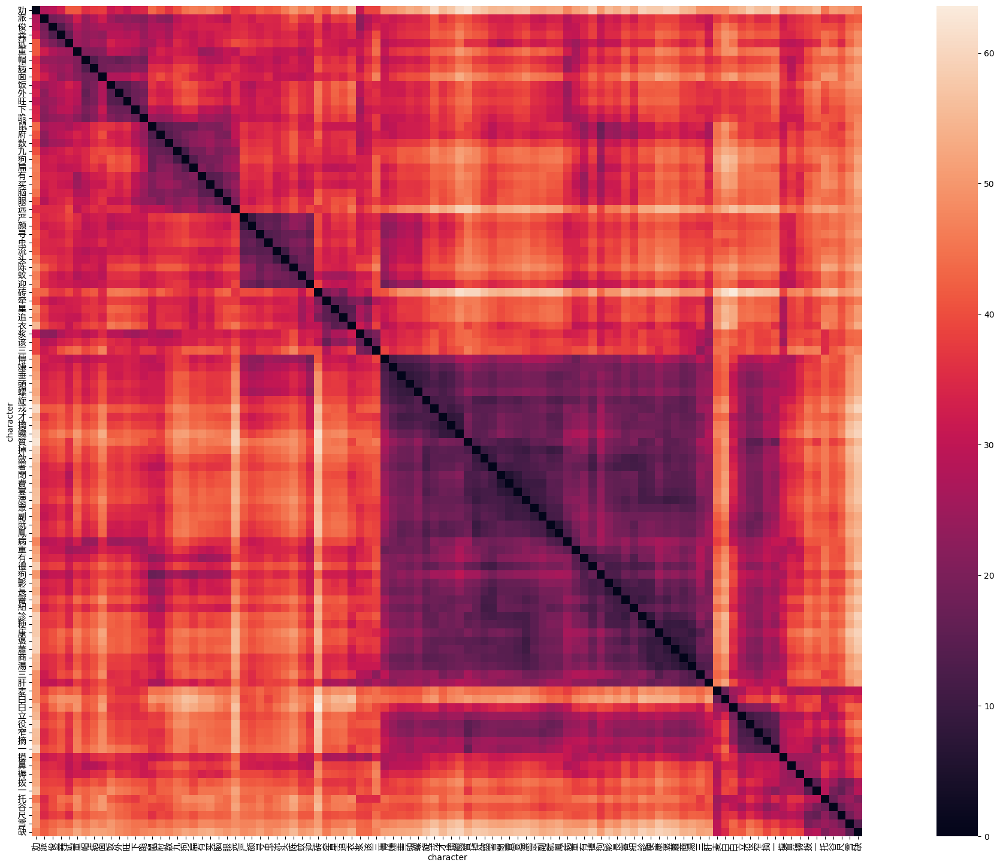

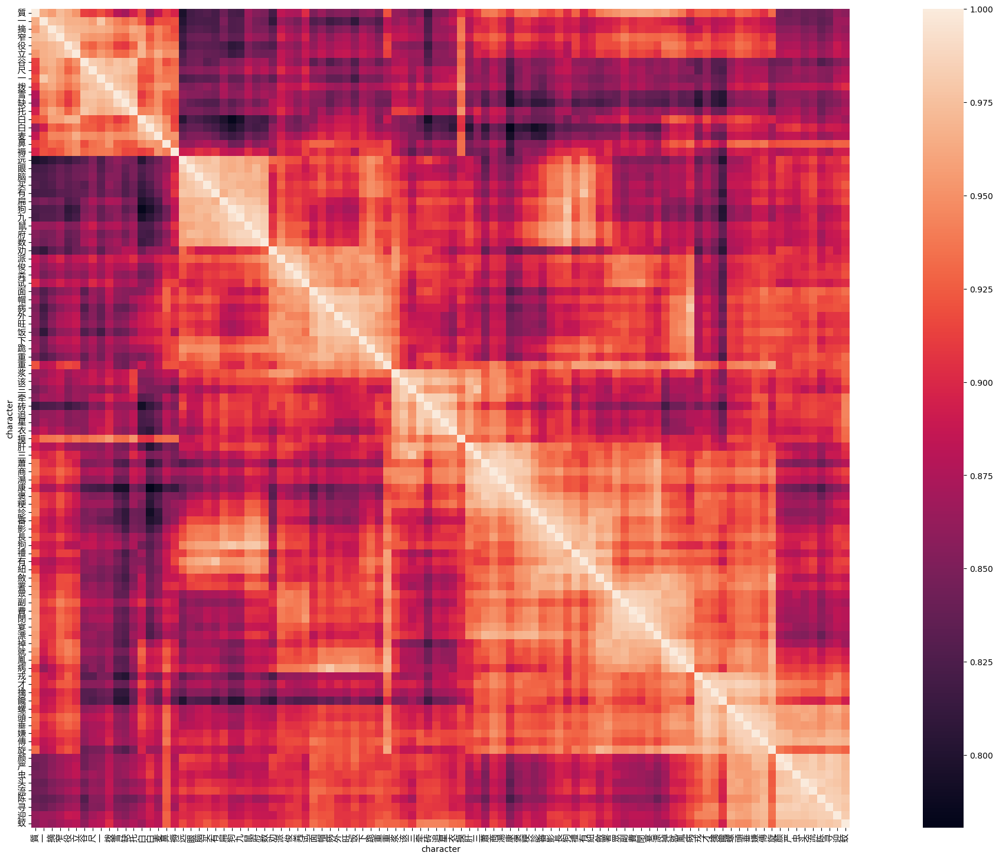

In [35]:
trans = get_trans(dialect_emb, weight)

for t in ('initial', 'final', 'tone'):
    u, s, _ = np.linalg.svd(globals()[f'{t}_emb'].T, full_matrices=False)
    m = u * s[None, :]
    a = trans @ m
    # eig_val, eig_vec = np.linalg.eig(np.tensordot(a, a, ((0, -1), (0, -1))))
    eig_val, eig_vec = np.linalg.eig(np.mean(a @ np.swapaxes(a, -1, -2), axis=0))
    emb = char_emb @ (eig_vec * np.sqrt(eig_val)[None, :])
    globals()[f'{t}_trans'] = m
    char[[f'{t}_pc1', f'{t}_pc2']] = PCA(2).fit(emb[char['dataset'] == 'zhongguoyuyan']).transform(emb)

    df = char[char['sample']]
    tree = hierarchy.linkage(emb[df['idx']], method='ward', optimal_ordering=True)
    leaves = hierarchy.leaves_list(tree)
    df = df.iloc[leaves]
    dist = pd.DataFrame(euclidean_distances(emb[df['idx']]), index=df['character'], columns=df['character'])

    plt.figure(figsize=(32, 18))
    plt.xticks(rotation='vertical')
    plt.yticks(rotation='horizontal')
    sns.heatmap(dist, square=True, xticklabels=True, yticklabels=True)
    plt.show()
    plt.close()

    df = char[char['sample']]
    emb = char_emb[None, df['idx'], :] @ a
    sim = emb @ np.swapaxes(emb, -1, -2)
    norm = np.sqrt(np.diagonal(sim, axis1=1, axis2=2))
    sim = np.mean(sim / norm[:, None, :] / norm[:, :, None], axis=0)

    tree = hierarchy.linkage(
        np.sqrt(2 - 2 * sim[np.triu_indices(df.shape[0], 1)]),
        method='average',
        optimal_ordering=True
    )
    leaves = hierarchy.leaves_list(tree)
    sim = pd.DataFrame(sim[leaves, :][:, leaves], index=df.iloc[leaves]['character'], columns=df.iloc[leaves]['character'])

    plt.figure(figsize=(32, 18))
    plt.xticks(rotation='vertical')
    plt.yticks(rotation='horizontal')
    sns.heatmap(sim, square=True, xticklabels=True, yticklabels=True)
    plt.show()
    plt.close()

1.217800433681388

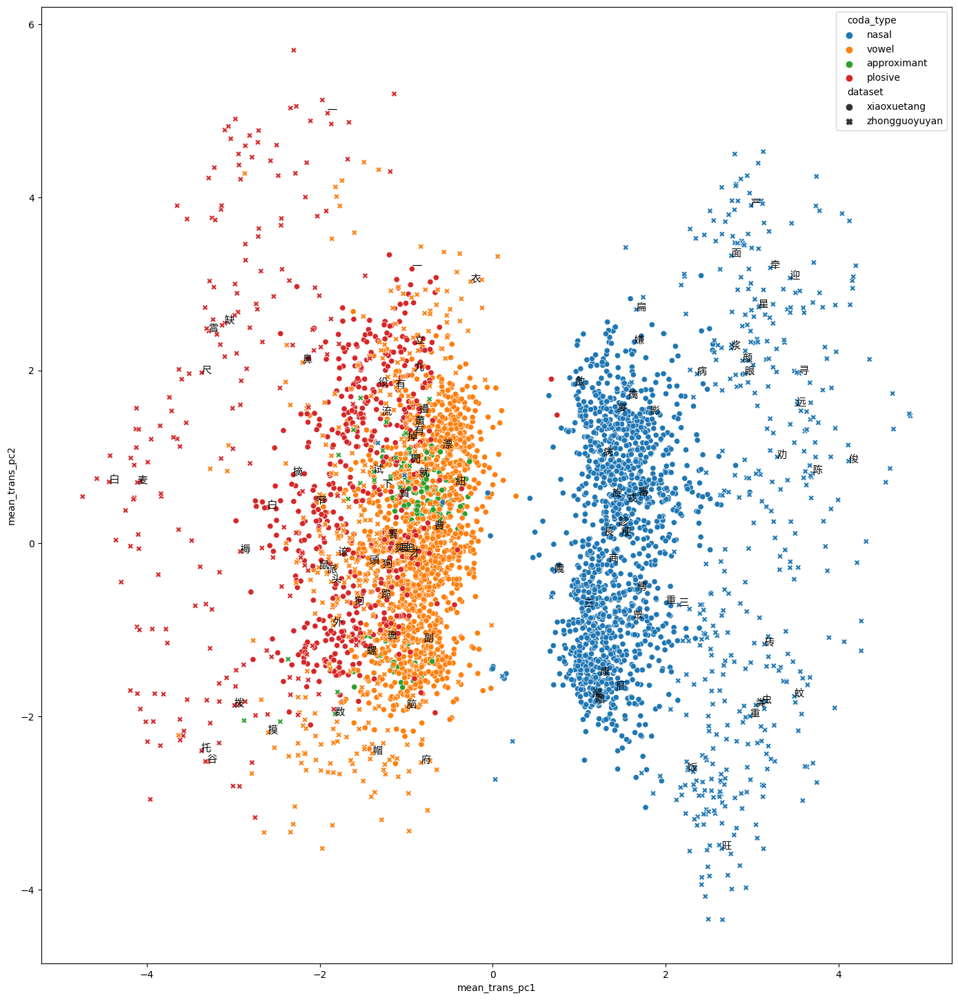

In [36]:
# mean_dialect_emb = np.mean(dialect_emb, axis=0)
mean_dialect_emb = np.mean([np.mean(e, axis=0) for e in dialect_embs], axis=0)
display(np.linalg.norm(mean_dialect_emb))

mean_trans_emb = char_emb @ get_trans(mean_dialect_emb, weight)
char[['mean_trans_pc1', 'mean_trans_pc2']] = PCA(2).fit_transform(mean_trans_emb)

plt.figure(figsize=(32, 18))
ax = plt.axes(aspect='equal')

sns.scatterplot(
    char[char['coda_type'] != ''],
    x='mean_trans_pc1',
    y='mean_trans_pc2',
    hue='coda_type',
    style='dataset',
    palette='tab10',
    ax=ax
)
for _, r in char[char['sample']].iterrows():
    ax.annotate(r['character'], xy=r[['mean_trans_pc1', 'mean_trans_pc2']])

plt.show()
plt.close()

In [37]:
input_emb = get_emb(input_embs, data[input_columns])
output_emb = np.stack([get_emb((e,), data[[c]]) for e, c in zip(output_embs, output_columns)], axis=1)
trans = np.swapaxes(np.tensordot(np.linalg.pinv(input_emb), output_emb, (-1, 0)), 0, 1)

for i, t in enumerate(('initial', 'final', 'tone')):
    char[[f'trans1_{t}_pc1', f'trans1_{t}_pc2']] = globals()[f'{t}_pca'].transform(char_emb @ trans[i])

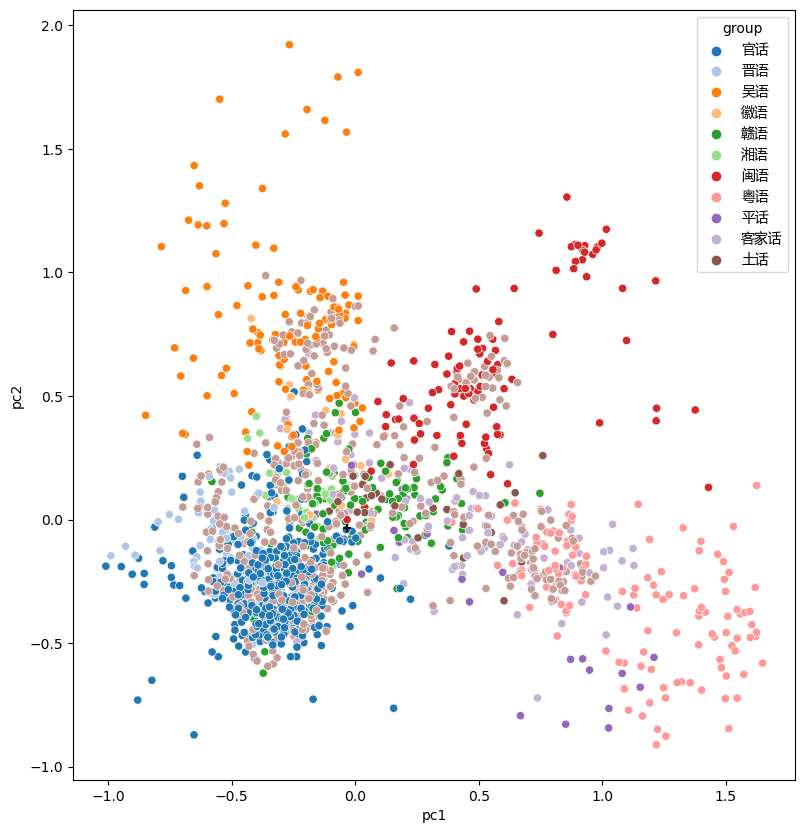

In [38]:
xtx = input_emb.T @ input_emb
ata = np.tensordot(np.tensordot(weight, xtx, [1, 0]), weight, [[1, 2], [2, 1]])
xty = input_emb.T @ np.mean(output_emb, axis=1)
atb = np.tensordot(weight, xty, [[1, 2], [0, 1]])
normal_dialect_emb = np.tensordot(np.linalg.inv(ata), atb, [-1, 0])
pc = dialect_pca.transform([normal_dialect_emb])

plt.figure(figsize=(10, 10))
ax = plt.axes(aspect='equal')
sns.scatterplot(dialect, x='pc1', y='pc2', hue='group', palette='tab20', ax=ax)
ax.scatter(pc[:, 0], pc[:, 1], color='black', marker='+')
plt.show()
plt.close()

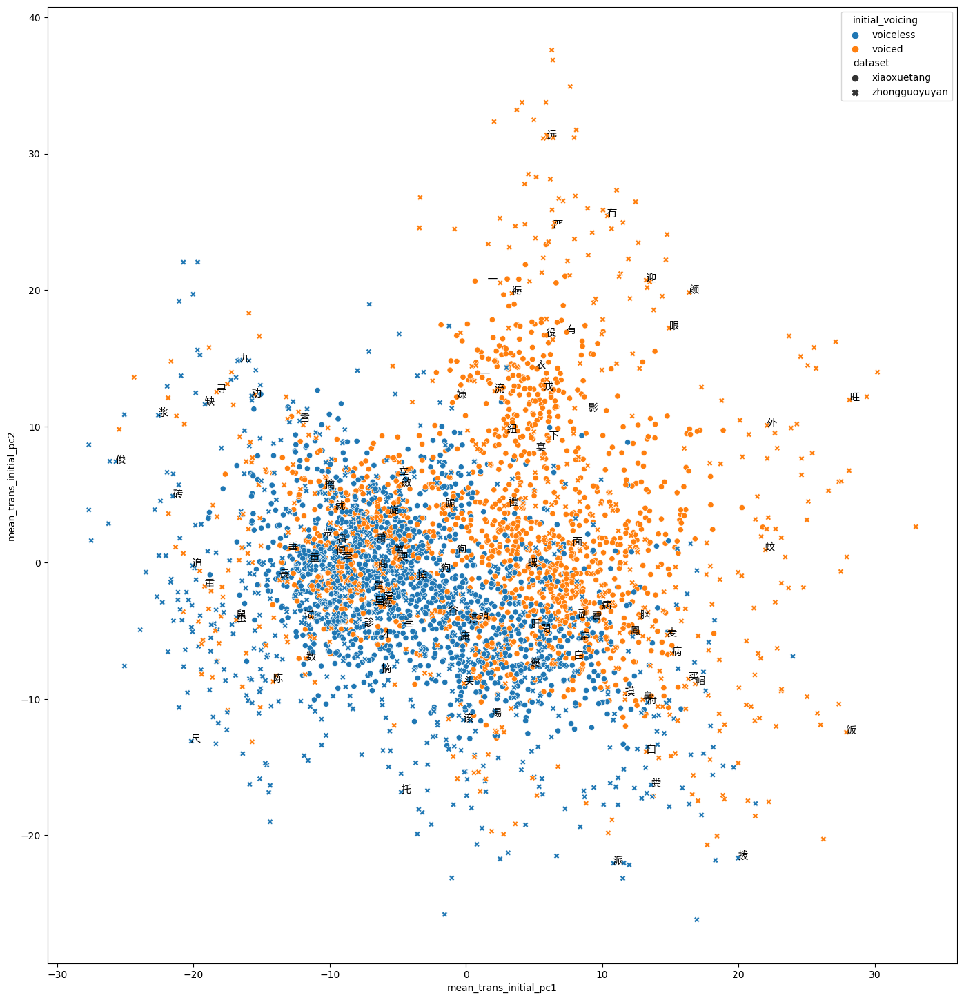

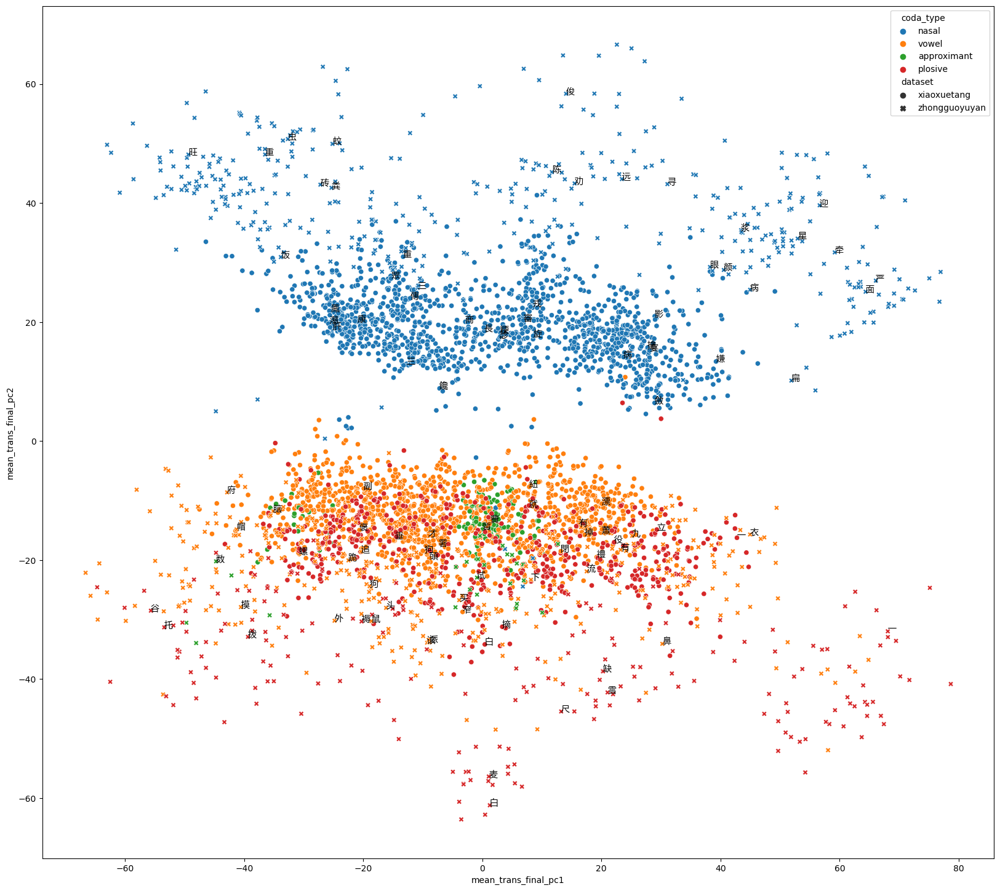

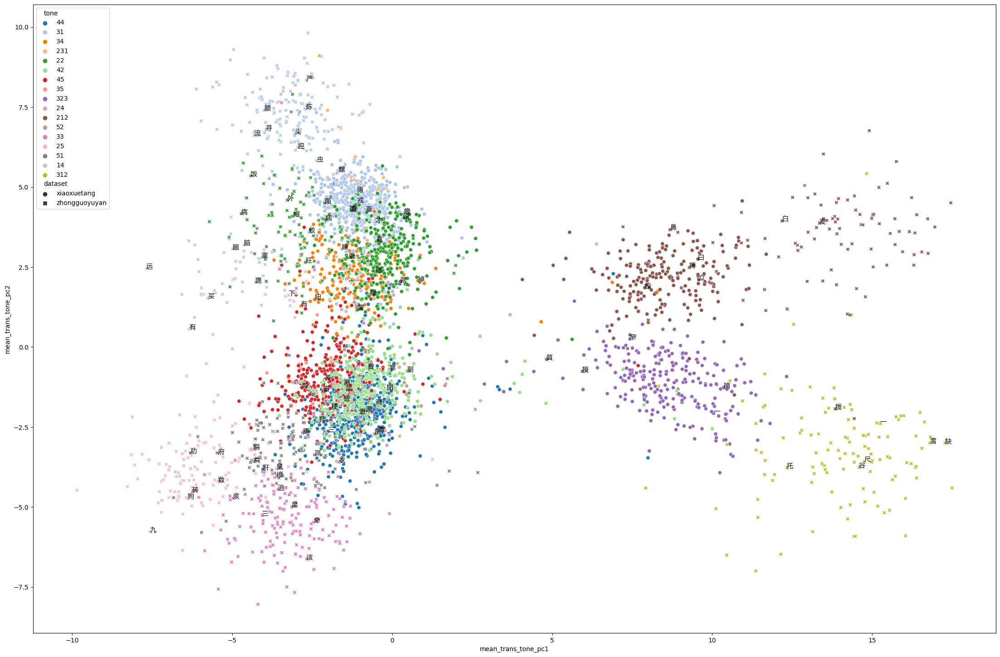

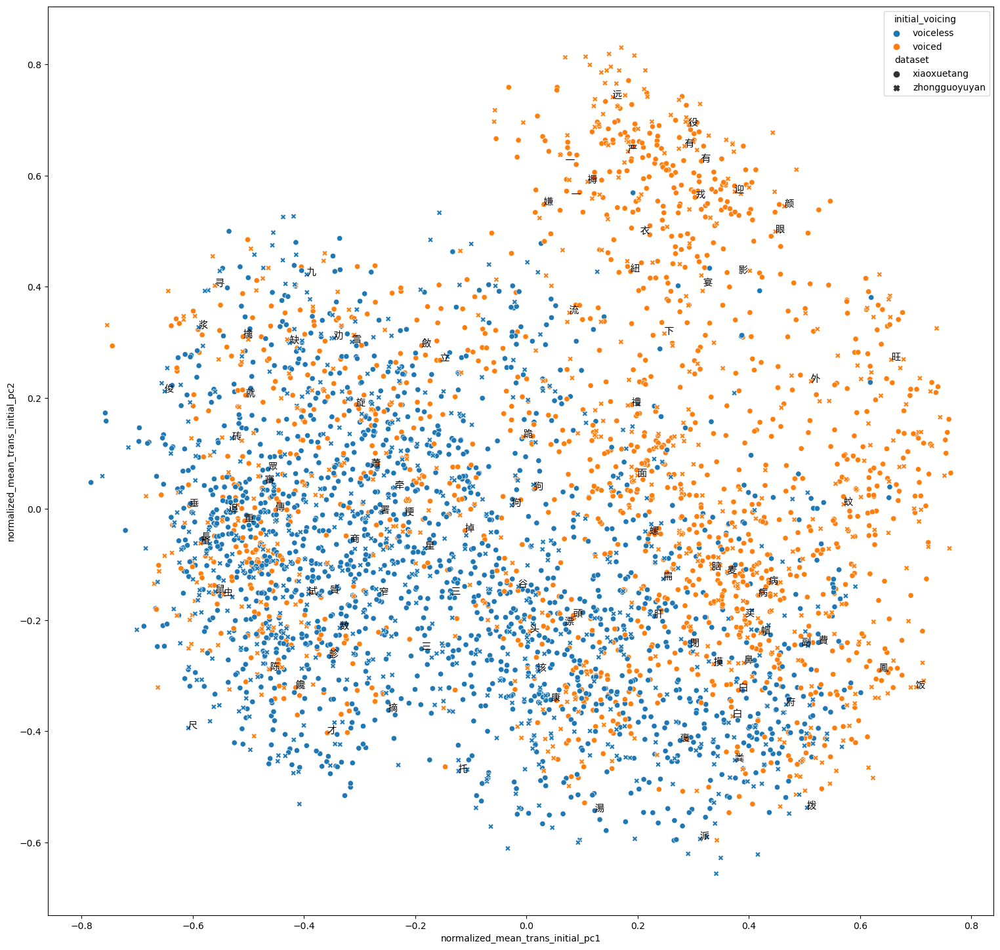

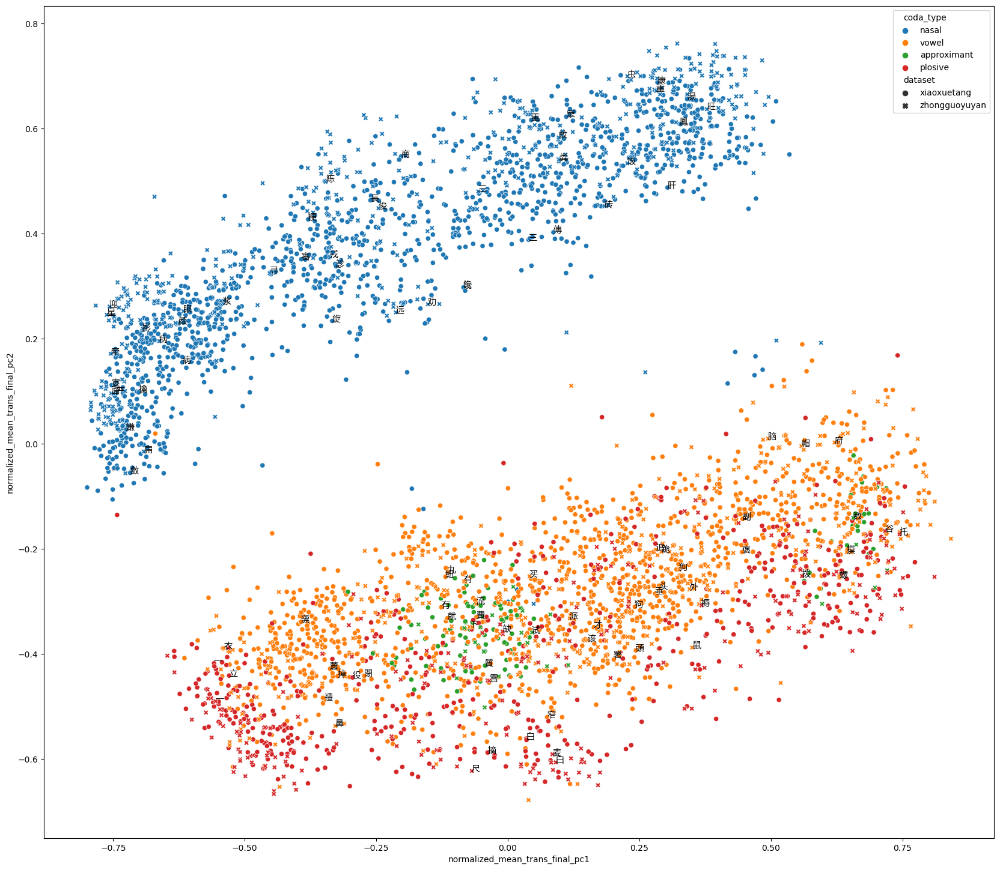

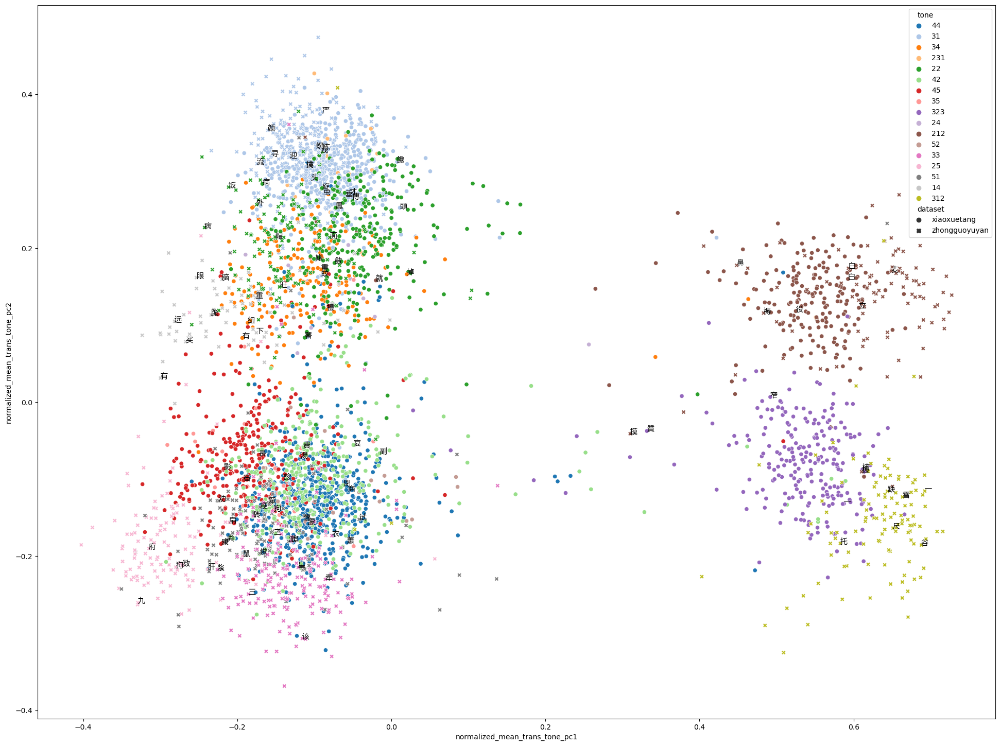

In [39]:
mean_trans_normalized_char_emb = normalized_char_emb @ get_trans(mean_dialect_emb, weight)

for t in ('initial', 'final', 'tone'):
    # char[[f'{t}_pc1', f'{t}_pc2']] = globals()[f'{t}_pca'].transform(char_emb)
    # char[[f'mean_trans_{t}_pc1', f'mean_trans_{t}_pc2']] = globals()[f'{t}_pca'].transform(mean_trans_emb)
    emb = mean_trans_emb @ globals()[f'{t}_trans']
    char[[f'mean_trans_{t}_pc1', f'mean_trans_{t}_pc2']] \
        = PCA(2).fit(emb[char['dataset'] == 'zhongguoyuyan']).transform(emb)
    emb = normalize(emb)
    char[[f'normalized_mean_trans_{t}_pc1', f'normalized_mean_trans_{t}_pc2']] \
        = PCA(2).fit(emb[char['dataset'] == 'zhongguoyuyan']).transform(emb)
    emb = mean_trans_normalized_char_emb @ globals()[f'{t}_trans']
    char[[f'mean_trans_normalized_{t}_pc1', f'mean_trans_normalized_{t}_pc2']] \
        = PCA(2).fit(emb[char['dataset'] == 'zhongguoyuyan']).transform(emb)

for prefix in ('mean_trans_', 'normalized_mean_trans_'):
    plt.figure(figsize=(32, 18))
    ax = plt.axes(aspect='equal')

    sns.scatterplot(
        char[char['initial_voicing'] != ''],
        x=f'{prefix}initial_pc1',
        y=f'{prefix}initial_pc2',
        hue='initial_voicing',
        style='dataset',
        palette='tab10',
        ax=ax
    )
    for _, r in char[char['sample']].iterrows():
        ax.annotate(r['character'], xy=r[[f'{prefix}initial_pc1', f'{prefix}initial_pc2']])

    plt.show()
    plt.close()

    plt.figure(figsize=(32, 18))
    ax = plt.axes(aspect='equal')

    sns.scatterplot(
        char[char['coda_type'] != ''],
        x=f'{prefix}final_pc1',
        y=f'{prefix}final_pc2',
        hue='coda_type',
        style='dataset',
        palette='tab10',
        ax=ax
    )
    for _, r in char[char['sample']].iterrows():
        ax.annotate(r['character'], xy=r[[f'{prefix}final_pc1', f'{prefix}final_pc2']])

    plt.show()
    plt.close()

    plt.figure(figsize=(32, 18))
    ax = plt.axes(aspect='equal')

    sns.scatterplot(
        char[char['tone'] != ''],
        x=f'{prefix}tone_pc1',
        y=f'{prefix}tone_pc2',
        hue='tone',
        style='dataset',
        palette='tab20',
        ax=ax
    )
    for _, r in char[char['sample']].iterrows():
        ax.annotate(r['character'], xy=r[[f'{prefix}tone_pc1', f'{prefix}tone_pc2']])

    plt.show()
    plt.close()

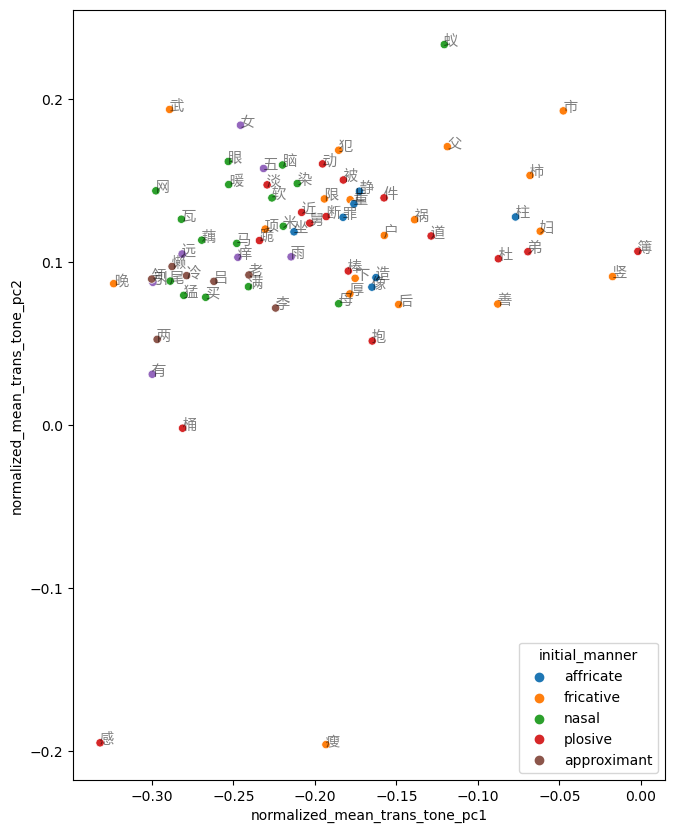

In [40]:
df = char[(char['dataset'] == 'zhongguoyuyan') & (char['tone'] == '14')]

plt.figure(figsize=(10, 10))
ax = plt.axes(aspect='equal')

sns.scatterplot(
    df,
    x='normalized_mean_trans_tone_pc1',
    y='normalized_mean_trans_tone_pc2',
    hue='initial_manner',
    palette='tab10',
    ax=ax
)

for _, r in df.iterrows():
    ax.annotate(r['character'], xy=r[['normalized_mean_trans_tone_pc1', 'normalized_mean_trans_tone_pc2']], alpha=0.5)

plt.show()
plt.close()

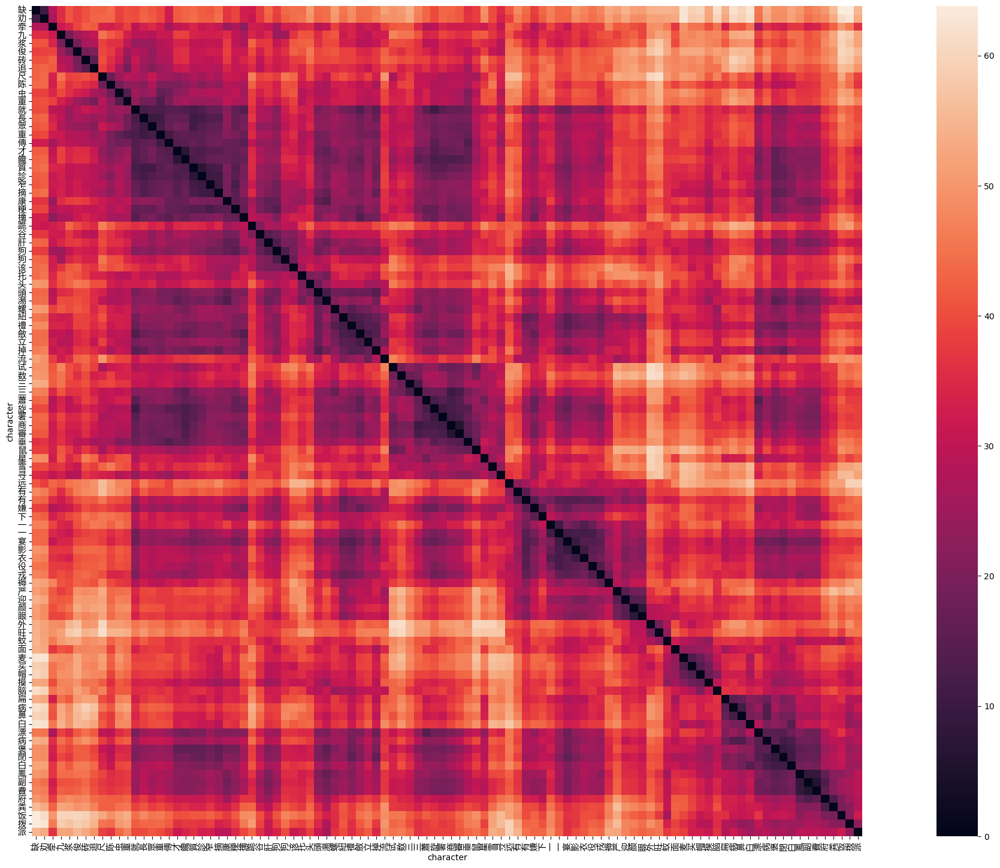

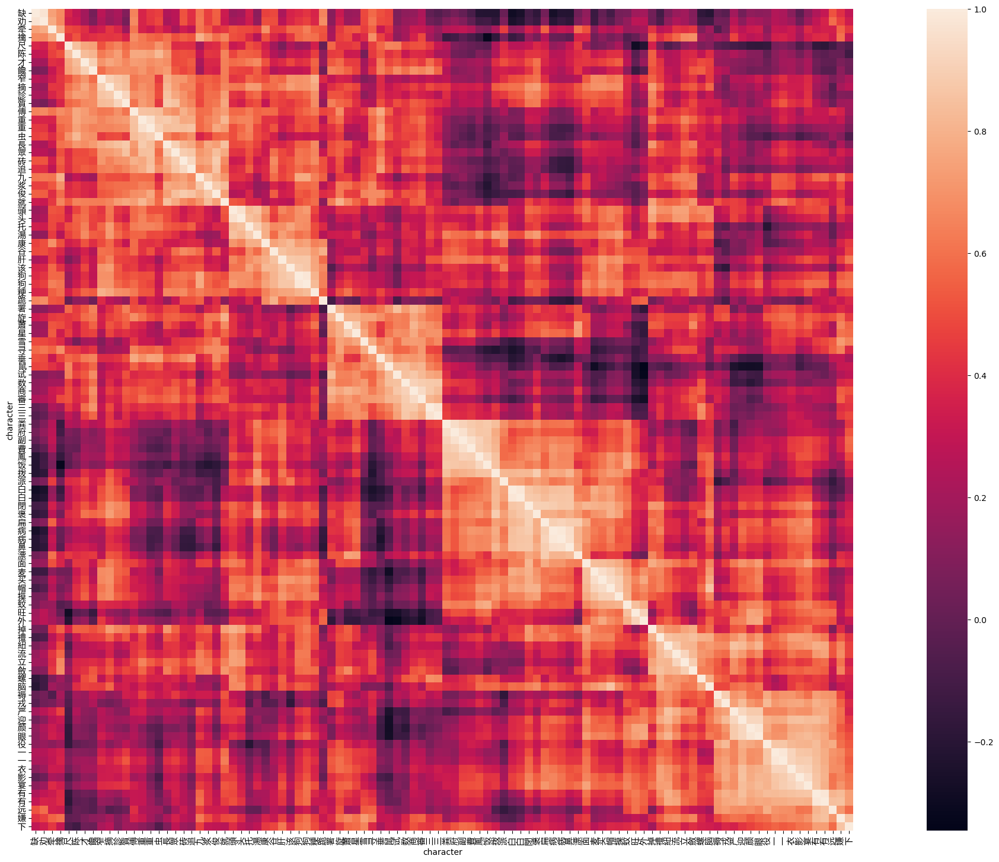

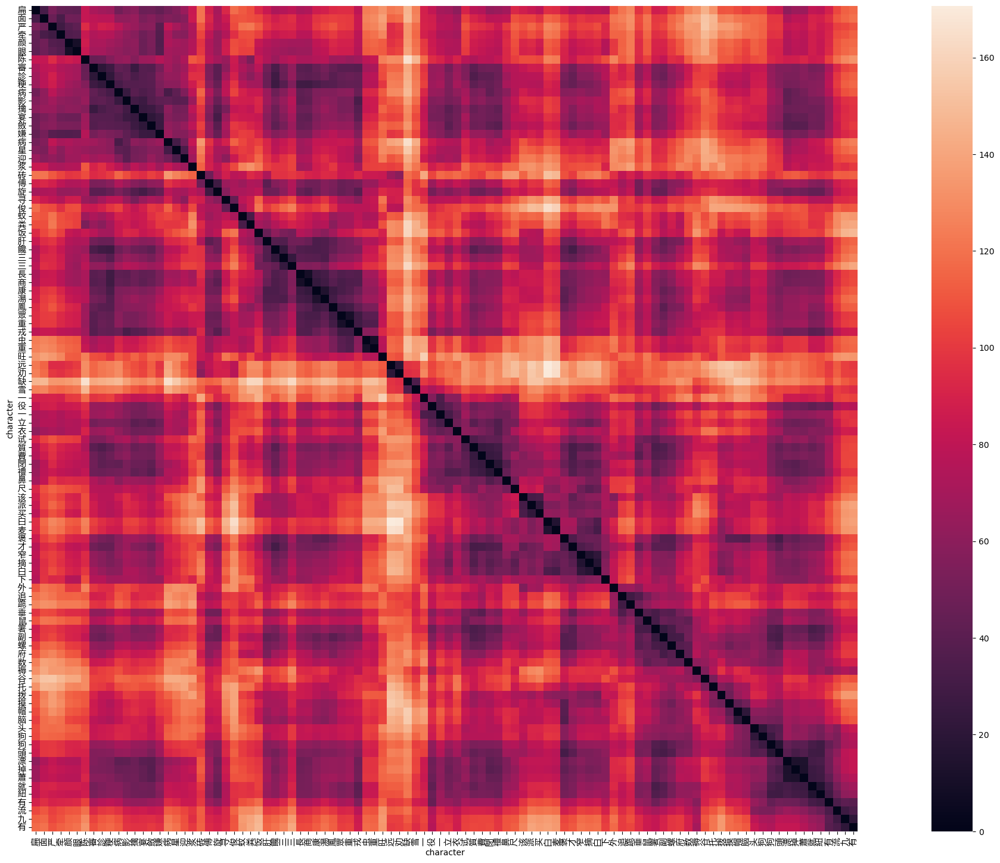

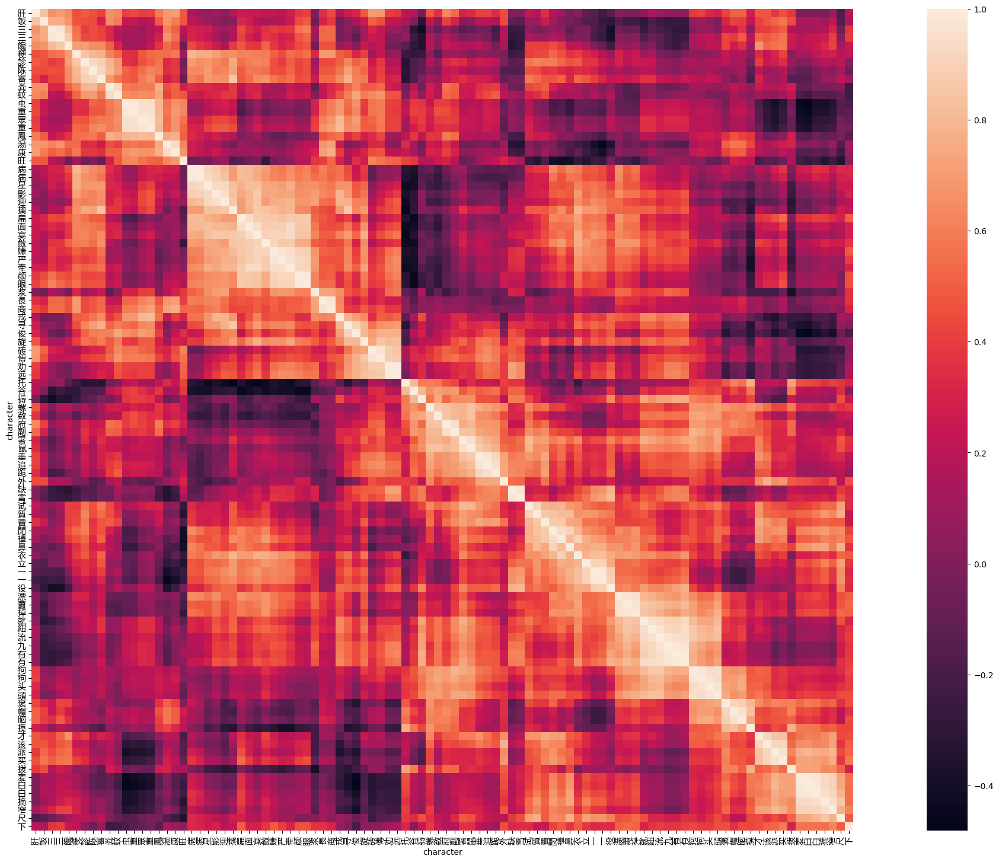

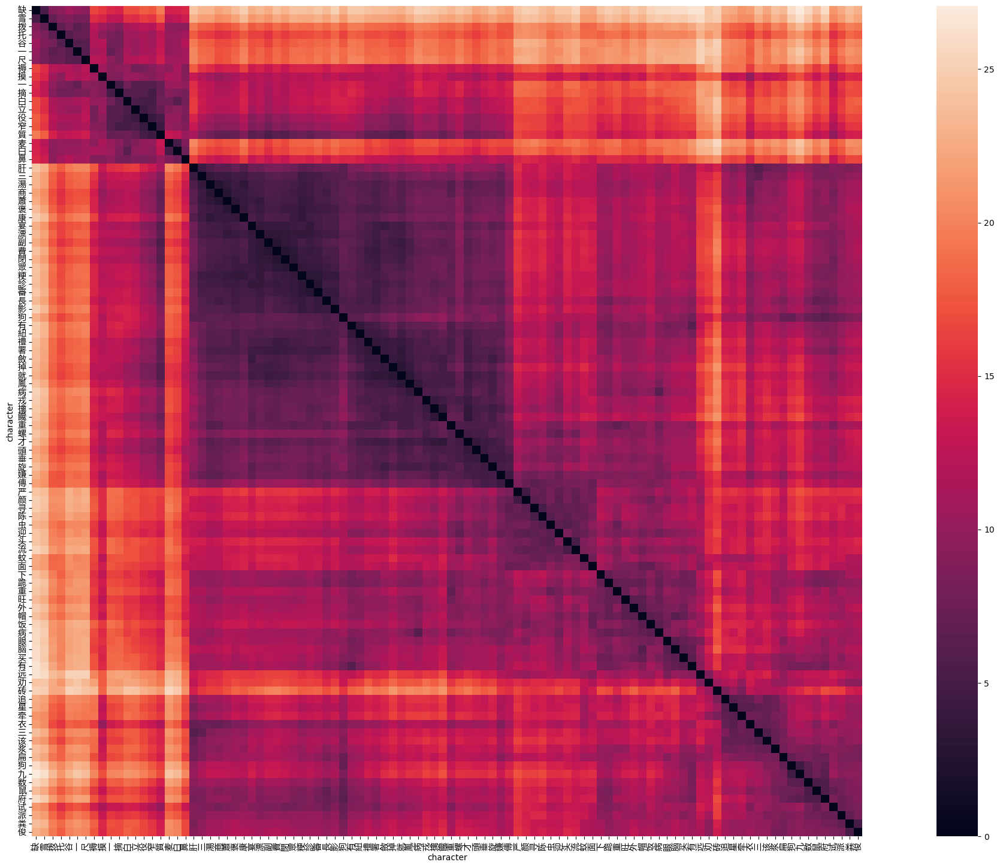

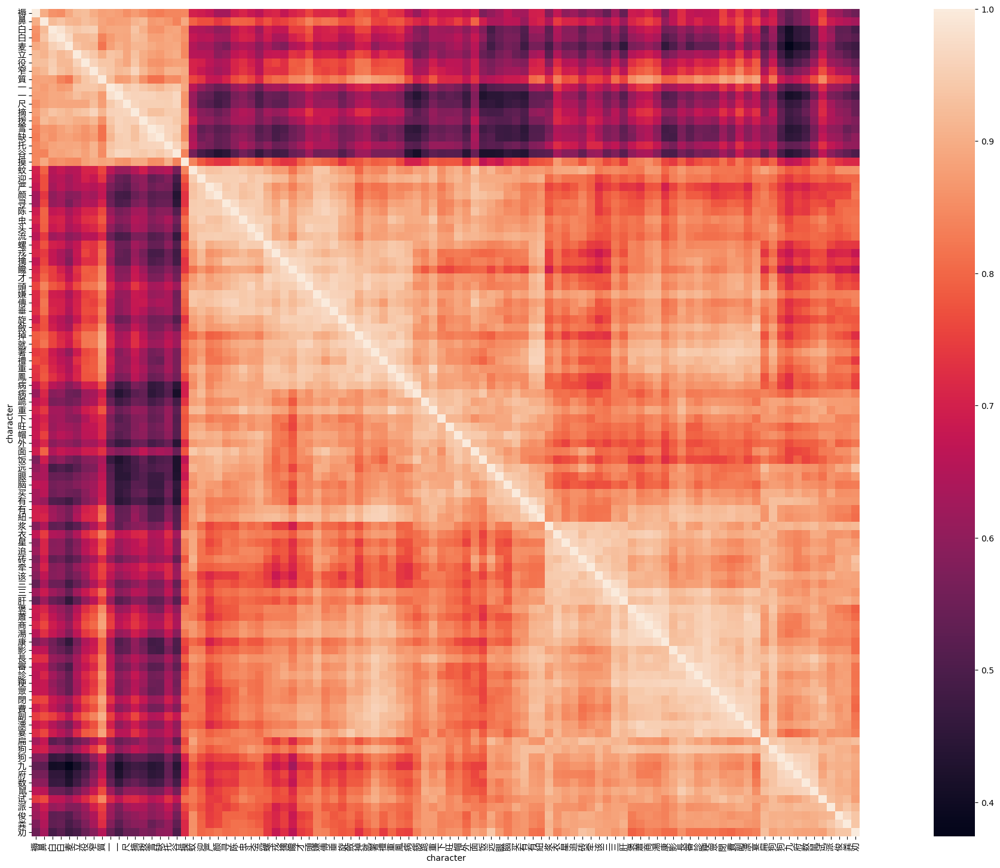

In [41]:
for e in (initial_emb, final_emb, tone_emb):
    u, s, _ = np.linalg.svd(e.T, full_matrices=False)
    emb = char_emb @ get_trans(mean_dialect_emb, weight) @ (u * s[None, :])

    df = char[char['sample']]
    tree = hierarchy.linkage(emb[df['idx']], method='ward', optimal_ordering=True)
    leaves = hierarchy.leaves_list(tree)
    df = df.iloc[leaves]
    dist = pd.DataFrame(euclidean_distances(emb[df['idx']]), index=df['character'], columns=df['character'])

    plt.figure(figsize=(32, 18))
    plt.xticks(rotation='vertical')
    plt.yticks(rotation='horizontal')
    sns.heatmap(dist, square=True, xticklabels=True, yticklabels=True)
    plt.show()
    plt.close()

    df = char[char['sample']]
    tree = hierarchy.linkage(emb[df['idx']], method='average', metric='cosine', optimal_ordering=True)
    leaves = hierarchy.leaves_list(tree)
    df = df.iloc[leaves]
    sim = pd.DataFrame(cosine_similarity(emb[df['idx']]), index=df['character'], columns=df['character'])

    plt.figure(figsize=(32, 18))
    plt.xticks(rotation='vertical')
    plt.yticks(rotation='horizontal')
    sns.heatmap(sim, square=True, xticklabels=True, yticklabels=True)
    plt.show()
    plt.close()

In [42]:
rhyme_book_prefix = os.path.join(os.environ['XIAOXUETANG_HOME'], 'data', 'xlsx', 'rhyme_books')

guangyun = pd.read_excel(os.path.join(rhyme_book_prefix, '020 韻書_廣韻.xlsx'), dtype=str).rename(columns={
    '字號': 'cid',
    '字': 'character',
    '攝': 'class',
    '聲調': 'tone',
    '韻目': 'rhyme',
    '字母': 'initial',
    '開合': 'turn',
    '等第': 'division',
    '清濁': 'voicing'
})
guangyun['cid'] = 'X' + guangyun['cid']
guangyun = pd.merge(guangyun, char.loc[char['frequency'] >= 5, []], on='cid', how='inner')
display(guangyun.describe())

_, idx = next(StratifiedShuffleSplit(n_splits=1, test_size=0.2).split(guangyun, guangyun['initial']))
guangyun.loc[guangyun.iloc[idx].index, 'test'] = True
guangyun['test'].fillna(False, inplace=True)
guangyun_emb = get_emb(input_embs, guangyun[input_columns])
train_emb = get_emb(input_embs, guangyun.loc[~guangyun['test'], input_columns])

guangyun_lr = LogisticRegression(fit_intercept=False)
guangyun_svc = LinearSVC(fit_intercept=False)
guangyun_tree = DecisionTreeClassifier()
guangyun_knn = KNeighborsClassifier(metric='cosine')

for name, classifier in ('lr', guangyun_lr), ('svc', guangyun_svc), ('tree', guangyun_tree), ('knn', guangyun_knn):
    guangyun[name] = classifier.fit(
        train_emb,
        guangyun.loc[~guangyun['test'], 'initial']
    ).predict(guangyun_emb)
    print(classification_report(
        guangyun.loc[guangyun['test'], 'initial'],
        guangyun.loc[guangyun['test'], name]
    ))

,cid,character,class,tone,rhyme,initial,turn,division,voicing,上字,下字
count,5543,5543,5543,5543,5543,5543,5543,5543,5543,5543,5543
unique,5543,5147,16,4,206,42,2,4,4,354,975
top,X1,差,山,平,陽,見,開,3,全清,古,良
freq,1,4,797,2227,111,505,3779,2807,2030,326,53


c:\Users\lerna\AppData\Local\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\lerna\AppData\Local\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\lerna\AppData\Local\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\l

              precision    recall  f1-score   support

           並       0.89      0.94      0.91        33
           云       0.78      0.47      0.58        15
           以       0.74      0.89      0.81        38
           來       0.87      0.98      0.92        66
           初       1.00      0.45      0.62        11
           匣       0.88      0.88      0.88        57
           奉       0.81      0.87      0.84        15
           娘       0.00      0.00      0.00         7
           定       0.85      0.91      0.88        43
           崇       1.00      0.12      0.22         8
           幫       0.86      0.91      0.89        35
           影       0.85      0.98      0.91        52
           從       0.82      0.75      0.78        24
           微       1.00      0.50      0.67        12
           徹       0.00      0.00      0.00         7
           心       0.77      0.93      0.84        46
           敷       0.00      0.00      0.00         9
           日       1.00    

In [43]:
zhongyuanyinyun = pd.read_excel(os.path.join(rhyme_book_prefix, '024 韻書_中原音韻.xlsx'), dtype=str).rename(columns={
    '字號': 'cid',
    '字': 'character',
    '韻部': 'rhyme',
    '聲調': 'tone',
    '字母': 'initial',
    '清濁': 'voicing'
})
zhongyuanyinyun['cid'] = 'X' + zhongyuanyinyun['cid']
zhongyuanyinyun = pd.merge(zhongyuanyinyun, char.loc[char['frequency'] >= 5, []], on='cid', how='inner')
display(zhongyuanyinyun.describe())

_, idx = next(StratifiedShuffleSplit(n_splits=1, test_size=0.2).split(zhongyuanyinyun, zhongyuanyinyun['rhyme']))
zhongyuanyinyun.loc[zhongyuanyinyun.iloc[idx].index, 'test'] = True
zhongyuanyinyun['test'].fillna(False, inplace=True)
zhongyuanyinyun_emb = get_emb(input_embs, zhongyuanyinyun[input_columns])
train_emb = get_emb(input_embs, zhongyuanyinyun.loc[~zhongyuanyinyun['test'], input_columns])

zhongyuanyinyun_lr = LogisticRegression(fit_intercept=False)
zhongyuanyinyun_svc = LinearSVC(fit_intercept=False)
zhongyuanyinyun_tree = DecisionTreeClassifier()
zhongyuanyinyun_knn = KNeighborsClassifier(metric='cosine')

for name, classifier in (
    ('lr', zhongyuanyinyun_lr),
    ('svc', zhongyuanyinyun_svc),
    ('tree', zhongyuanyinyun_tree),
    ('knn', zhongyuanyinyun_knn)
):
    zhongyuanyinyun[name] = classifier.fit(
        train_emb,
        zhongyuanyinyun.loc[~zhongyuanyinyun['test'], 'rhyme']
    ).predict(zhongyuanyinyun_emb)
    print(classification_report(
        zhongyuanyinyun.loc[zhongyuanyinyun['test'], 'rhyme'],
        zhongyuanyinyun.loc[zhongyuanyinyun['test'], name]
    ))

,cid,character,rhyme,tone,initial,voicing,寧繼福擬音
count,1242,1242,1242,1242,1242,1242,1242
unique,1242,1222,19,7,21,3,415
top,X1,惡,魚模,去聲,影,全清,fu
freq,1,3,144,307,165,766,18


c:\Users\lerna\AppData\Local\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\lerna\AppData\Local\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\lerna\AppData\Local\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\l

              precision    recall  f1-score   support

          侵尋       0.00      0.00      0.00         6
          先天       0.64      0.56      0.60        16
          家麻       1.00      0.12      0.22         8
          寒山       0.00      0.00      0.00         7
          尤侯       0.67      0.75      0.71        16
          庚青       0.81      0.81      0.81        16
          廉纖       0.00      0.00      0.00         6
          支思       0.00      0.00      0.00         7
          東鍾       0.76      1.00      0.87        13
          桓歡       0.00      0.00      0.00         4
          歌戈       0.43      0.25      0.32        12
          江陽       0.92      0.69      0.79        16
          皆來       0.00      0.00      0.00         7
          監咸       0.00      0.00      0.00         6
          真文       0.69      0.60      0.64        15
          蕭豪       0.43      0.92      0.59        26
          車遮       0.89      0.62      0.73        13
          魚模       0.50    

c:\Users\lerna\AppData\Local\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\lerna\AppData\Local\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\lerna\AppData\Local\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


C:\Users\lerna\AppData\Local\Temp\ipykernel_7368\756432568.py:9: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(pc[mask, 0], pc[mask, 1], pc[mask, 2], cmap='tab20', label=r)


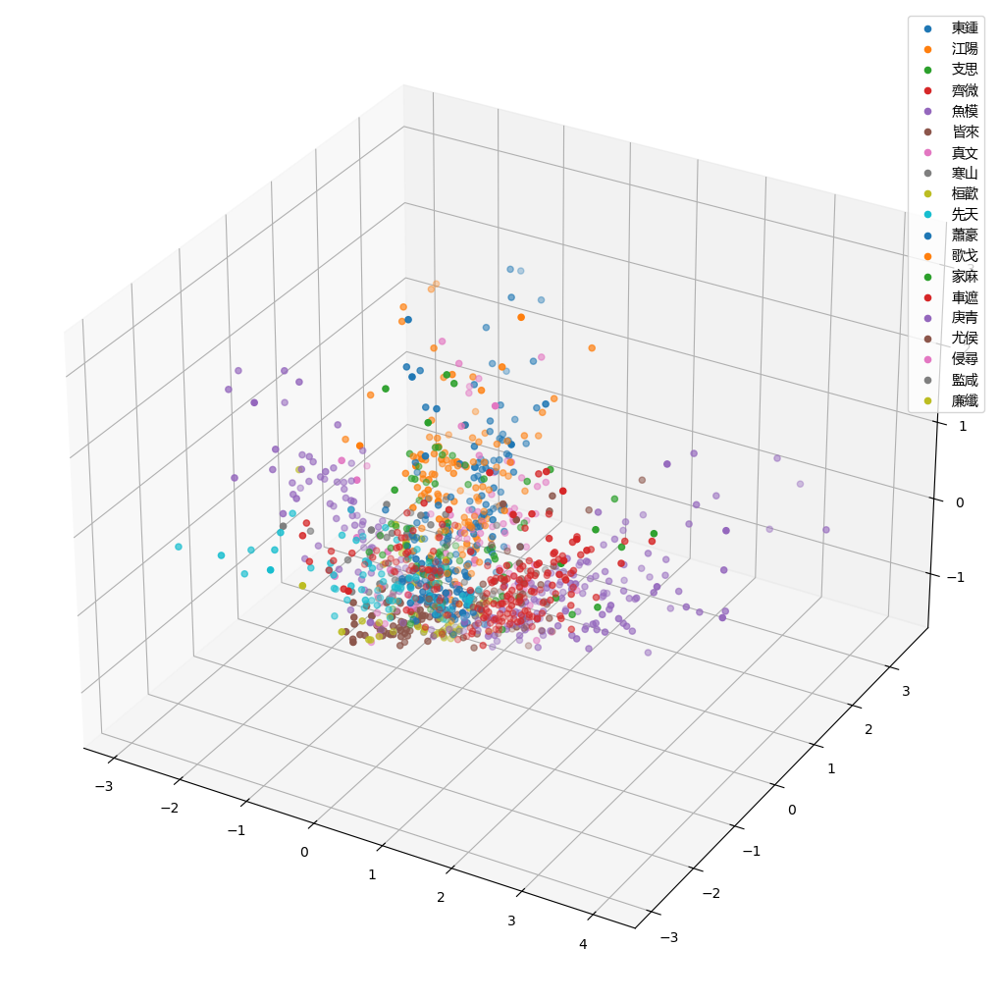

In [44]:
pc = PCA(3).fit_transform(zhongyuanyinyun_svc.decision_function(zhongyuanyinyun_emb))

fig = plt.figure(figsize=(10, 10))
ax = mplot3d.Axes3D(fig)
fig.add_axes(ax)

for r in zhongyuanyinyun['rhyme'].unique():
    mask = zhongyuanyinyun['rhyme'] == r
    ax.scatter(pc[mask, 0], pc[mask, 1], pc[mask, 2], cmap='tab20', label=r)

ax.legend(loc='upper right')
plt.show()

ani = animation.FuncAnimation(
    fig,
    functools.partial(rotate, ax=ax),
    np.arange(45, 405, 5),
    interval=200,
    repeat_delay=200
)
ani.save('方言编码广韵SVM变换PCA降维三维散点图.gif')
plt.close()

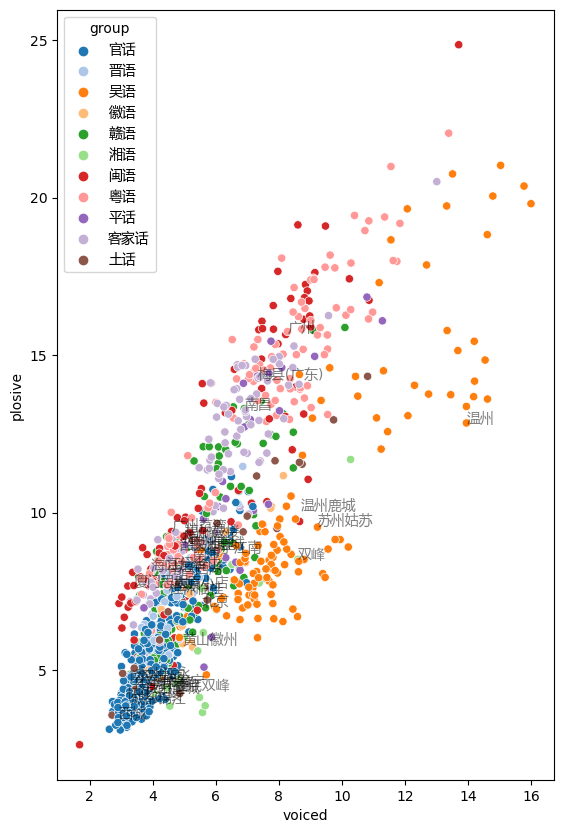

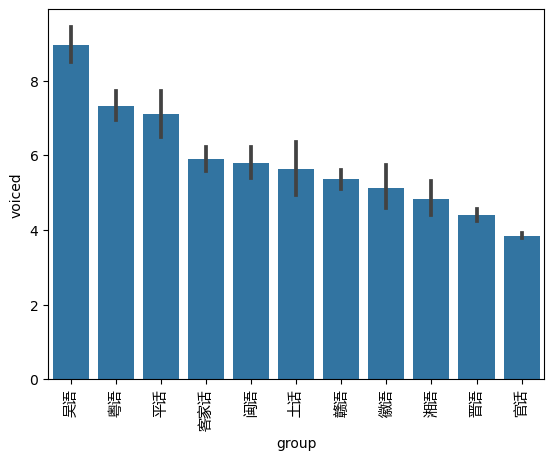

In [45]:
trans = get_trans(dialect_emb, weight)
w = normalize([voiced_svc.coef_[0], plosive_svc.coef_[0]])
voiced_char_dir, plosive_char_dir = w
dialect[['voiced', 'plosive']] = np.linalg.norm(np.tensordot(trans, w, [1, 1]), axis=1)

plt.figure(figsize=(10, 10))
ax = plt.axes(aspect='equal')
sns.scatterplot(dialect[dialect['group'] != ''], x='voiced', y='plosive', hue='group', palette='tab20', ax=ax)
for _, r in dialect[dialect['representative']].iterrows():
    ax.annotate(r['spot'], xy=r[['voiced', 'plosive']], alpha=0.5)
plt.show()
plt.close()

sns.barplot(
    data=dialect[dialect['group'] != ''],
    x='group',
    y='voiced',
    order=dialect[dialect['group'] != ''].groupby('group')['voiced'].mean().sort_values(ascending=False).index,
    color='tab:blue'
)
plt.xticks(rotation='vertical')
plt.show()
plt.close()

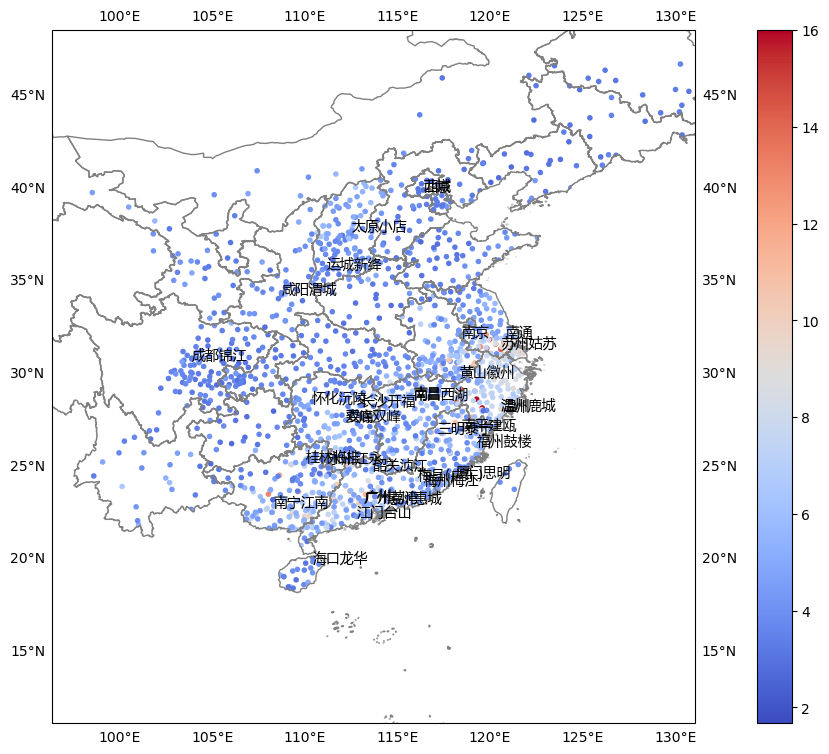

In [46]:
plt.figure(figsize=(16, 9))
ax, _, cs = sinetym.plot.geography.scatter(
    dialect['latitude'],
    dialect['longitude'],
    dialect['voiced'],
    scale=3,
    clip=china,
    marker='.',
    cmap='coolwarm'
)
ax.add_geometries(province, ax.projection, edgecolor='gray', facecolor='none')

for _, r in dialect[dialect['representative']].iterrows():
    ax.annotate(r['spot'], xy=r[['longitude', 'latitude']])

gl = ax.gridlines(draw_labels=True)
gl.xlines = False
gl.ylines = False
plt.colorbar(cs)
plt.show()
plt.close()

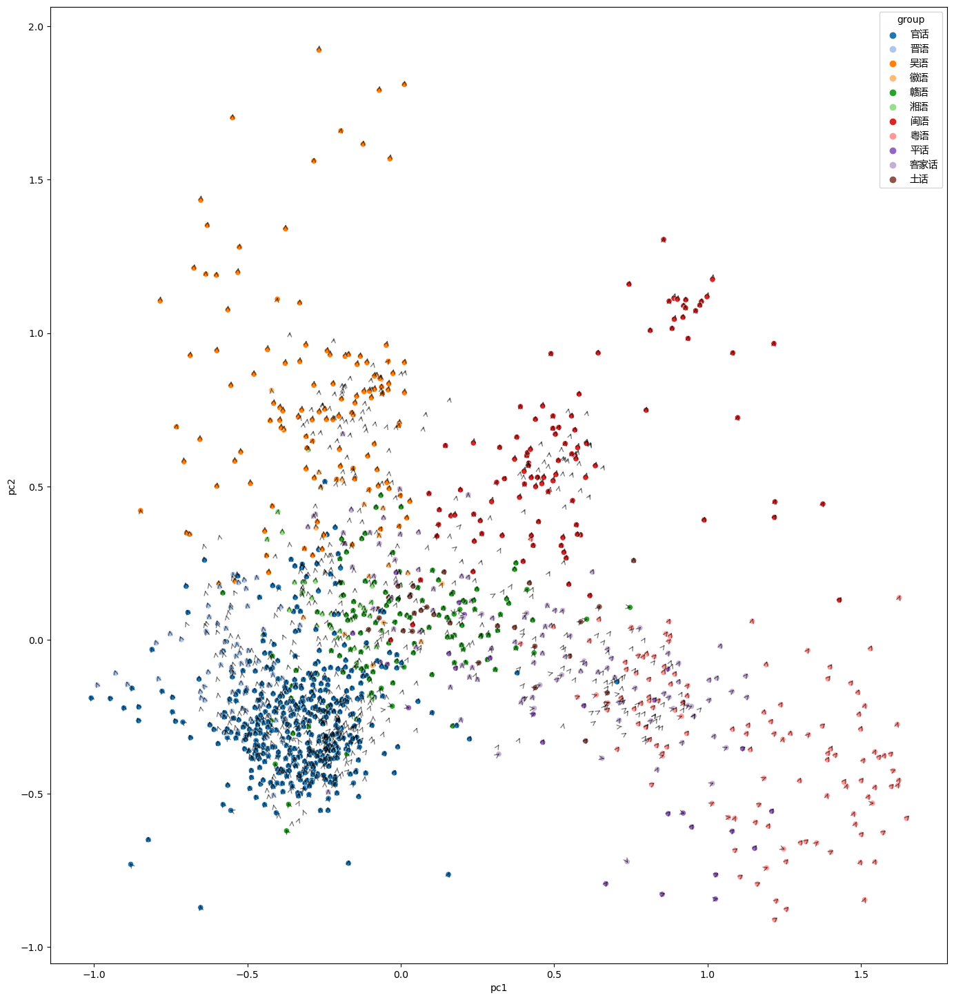

In [47]:
w = np.tensordot(weight, voiced_char_dir, [1, 0])
voiced_dialect_dir = (dialect_emb @ w + voiced_char_dir) @ w.T
voiced_dialect_dir /= np.linalg.norm(voiced_dialect_dir, axis=1, keepdims=True)

pc = dialect_pca.transform(dialect_emb + 0.05 * voiced_dialect_dir)

plt.figure(figsize=(32, 18))
ax = plt.axes(aspect='equal')
sns.scatterplot(dialect[dialect['group'] != ''], x='pc1', y='pc2', hue='group', palette='tab20', ax=ax)
for i, (_, r) in enumerate(dialect.iterrows()):
    ax.annotate('', xy=pc[i, :2], xytext=r[['pc1', 'pc2']], arrowprops={'arrowstyle': '->', 'alpha': 0.5})
plt.show()
plt.close()

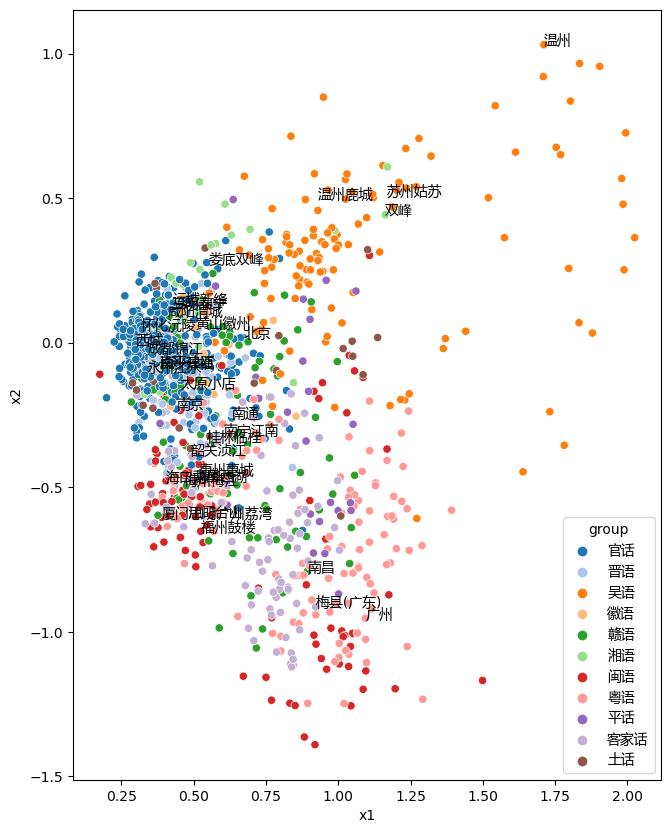

In [48]:
lr = LinearRegression().fit(dialect_emb, dialect[['voiced', 'plosive']])
q, _ = np.linalg.qr(np.stack(lr.coef_, axis=1))

dialect[['x1', 'x2']] = dialect_emb @ q

plt.figure(figsize=(10, 10))
ax = plt.axes(aspect='equal')

sns.scatterplot(dialect[dialect['group'] != ''], x='x1', y='x2', hue='group', palette='tab20', ax=ax)
for _, r in dialect[dialect['representative']].iterrows():
    ax.annotate(r['spot'], xy=r[['x1', 'x2']])

plt.show()
plt.close()

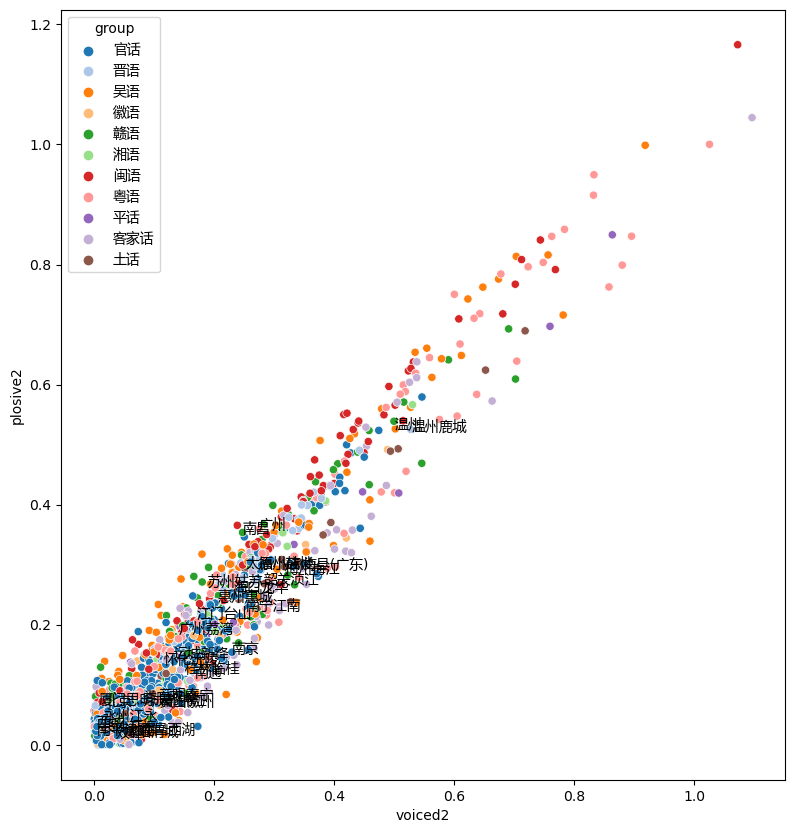

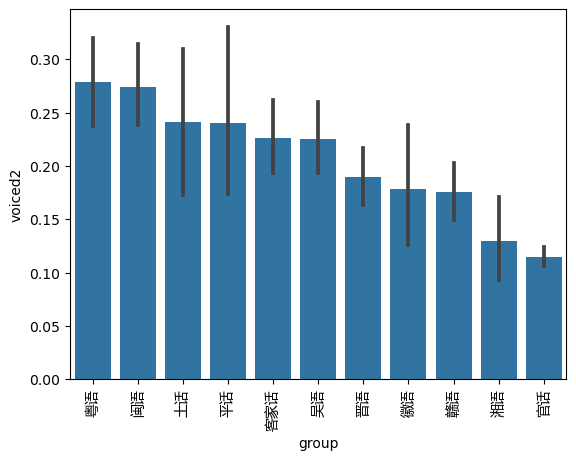

In [49]:
y = np.tensordot(weight, voiced_char_dir, [1, 0])
a = y @ y.T
s, q = np.linalg.eig(a)
voiced_dialect_dir = q[:, np.argmax(s)]
voiced_dialect_dir /= np.linalg.norm(voiced_dialect_dir)
dialect['voiced2'] = np.abs(np.tensordot(dialect_emb, voiced_dialect_dir, [-1, 0]))

y = np.tensordot(weight, plosive_char_dir, [1, 0])
a = y @ y.T
s, q = np.linalg.eig(a)
plosive_dialect_dir = q[:, np.argmax(s)]
plosive_dialect_dir /= np.linalg.norm(plosive_dialect_dir)
dialect['plosive2'] = np.abs(np.tensordot(dialect_emb, plosive_dialect_dir, [-1, 0]))

plt.figure(figsize=(10, 10))
ax = plt.axes(aspect='equal')
sns.scatterplot(dialect[dialect['group'] != ''], x='voiced2', y='plosive2', hue='group', palette='tab20', ax=ax)
for _, r in dialect[dialect['representative']].iterrows():
    ax.annotate(r['spot'], xy=r[['voiced2', 'plosive2']])
plt.show()
plt.close()

sns.barplot(
    data=dialect[dialect['group'] != ''],
    x='group',
    y='voiced2',
    order=dialect[dialect['group'] != ''].groupby('group')['voiced2'].mean().sort_values(ascending=False).index,
    color='tab:blue'
)
plt.xticks(rotation='vertical')
plt.show()
plt.close()

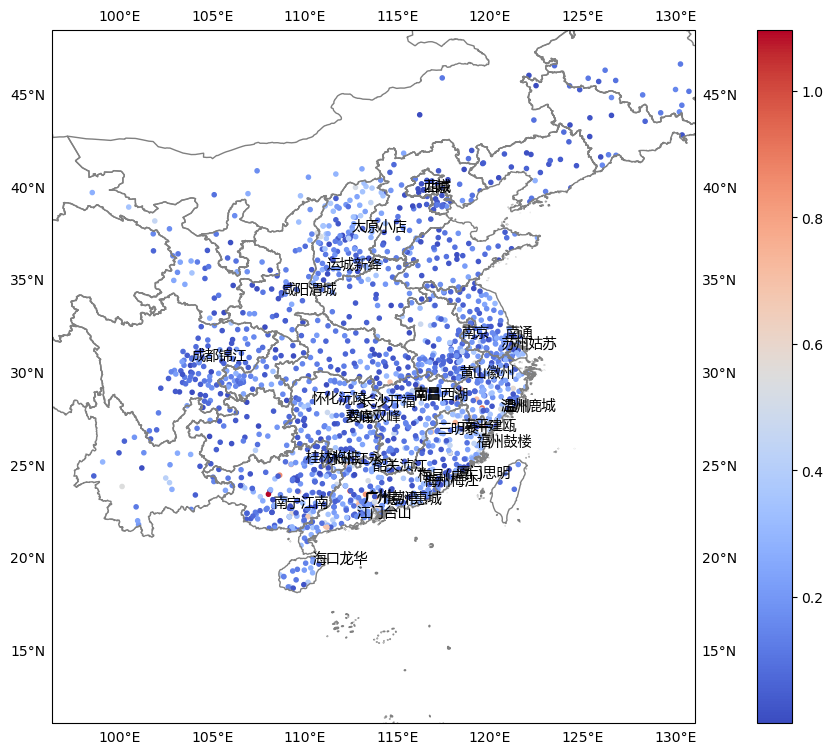

In [50]:
plt.figure(figsize=(16, 9))
ax, _, cs = sinetym.plot.geography.scatter(
    dialect['latitude'],
    dialect['longitude'],
    dialect['voiced2'],
    scale=3,
    clip=china,
    marker='.',
    cmap='coolwarm'
)
ax.add_geometries(province, ax.projection, edgecolor='gray', facecolor='none')

for _, r in dialect[dialect['representative']].iterrows():
    ax.annotate(r['spot'], xy=r[['longitude', 'latitude']])

gl = ax.gridlines(draw_labels=True)
gl.xlines = False
gl.ylines = False
plt.colorbar(cs)
plt.show()
plt.close()

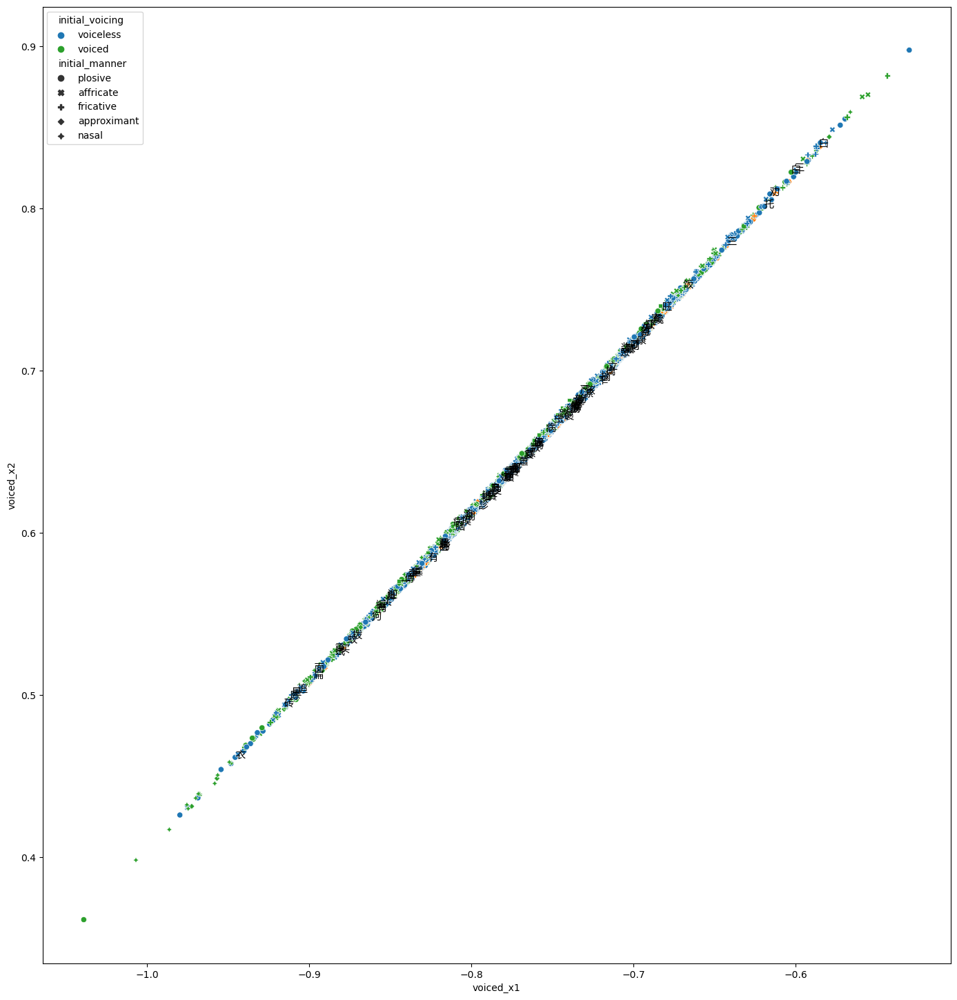

In [51]:
voiced_trans = get_trans(voiced_dialect_dir, weight)
s, q = np.linalg.eig(voiced_trans @ voiced_trans.T)
char[['voiced_x1', 'voiced_x2']] = (char_emb @ np.take(q, np.argsort(s)[::-1][:2], axis=-1))

plt.figure(figsize=(32, 18))
ax = plt.axes(aspect='equal')

sns.scatterplot(
    char[(char['initial_voicing'] != '') | (char['initial_manner'] != '')],
    x='voiced_x1',
    y='voiced_x2',
    hue='initial_voicing',
    style='initial_manner',
    palette='tab10',
    ax=ax
)

for _, r in char[char['sample']].iterrows():
    ax.annotate(r['character'], xy=r[['voiced_x1', 'voiced_x2']])

plt.show()
plt.close()

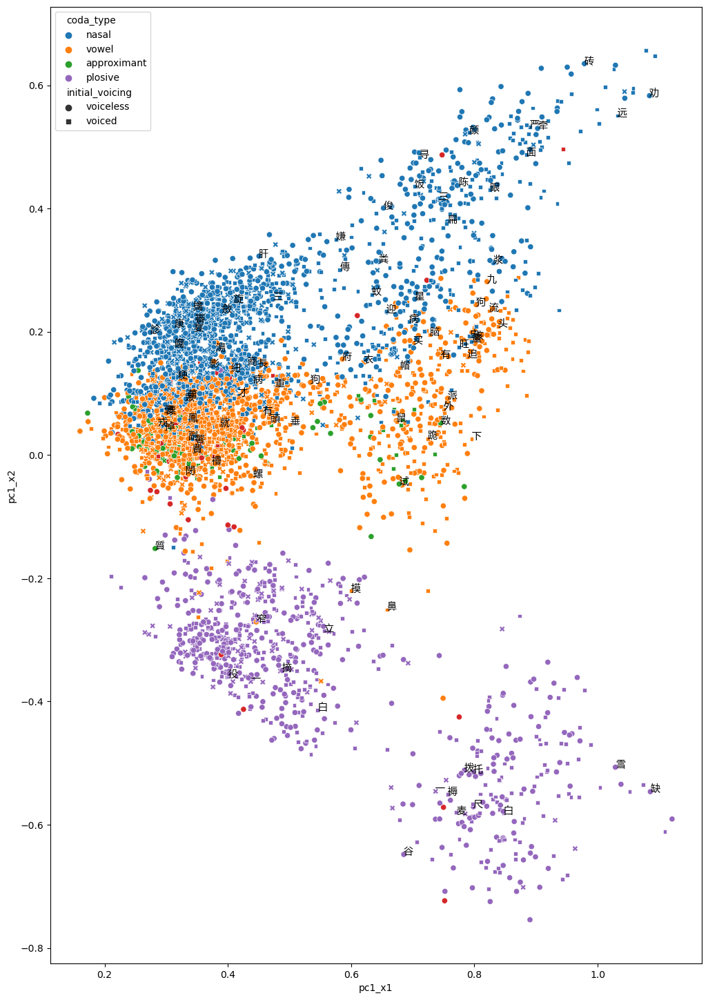

In [52]:
trans = get_trans(dialect_pca.components_[0], weight)
s, q = np.linalg.eig(trans @ trans.T)
char[['pc1_x1', 'pc1_x2']] = (char_emb @ np.take(q, np.argsort(s)[::-1][:2], axis=-1))

plt.figure(figsize=(32, 18))
ax = plt.axes(aspect='equal')

sns.scatterplot(
    char[(char['coda_type'] != '') | (char['initial_voicing'] != '')],
    x='pc1_x1',
    y='pc1_x2',
    hue='coda_type',
    style='initial_voicing',
    palette='tab10',
    ax=ax
)

for _, r in char[char['sample']].iterrows():
    ax.annotate(r['character'], xy=r[['pc1_x1', 'pc1_x2']])

plt.show()
plt.close()

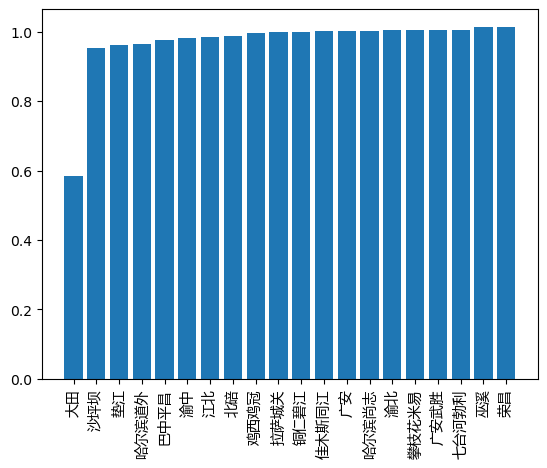

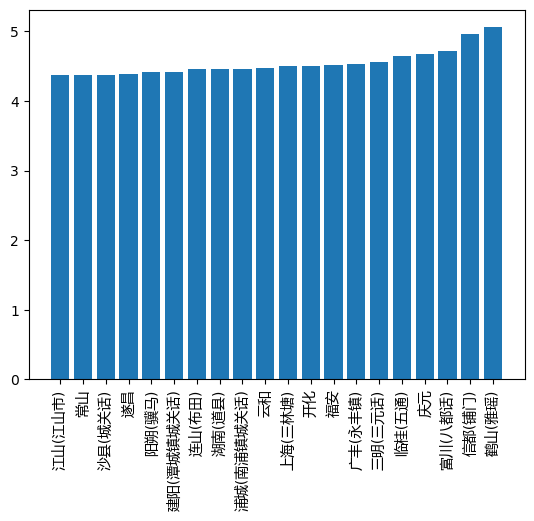

In [53]:
dialect['dist'] = np.linalg.norm(dialect_emb - mean_dialect_emb[None, :], axis=1)
dialect_sort = dialect.sort_values('dist')

plt.bar(dialect_sort[:20].index, dialect_sort[:20]['dist'], tick_label=dialect_sort[:20]['spot'])
plt.xticks(rotation='vertical')
plt.show()
plt.close()

plt.bar(dialect_sort[-20:].index, dialect_sort[-20:]['dist'], tick_label=dialect_sort[-20:]['spot'])
plt.xticks(rotation='vertical')
plt.show()
plt.close()

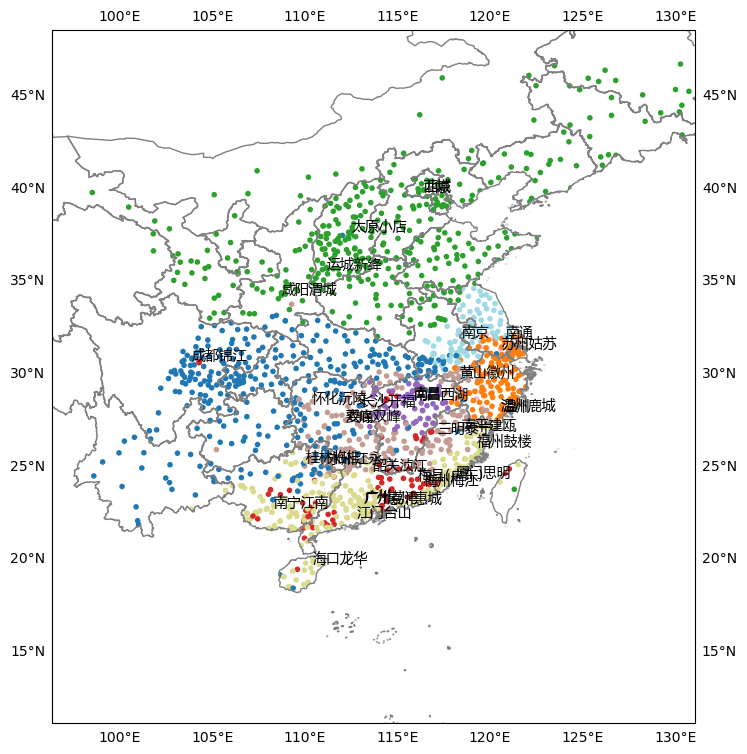

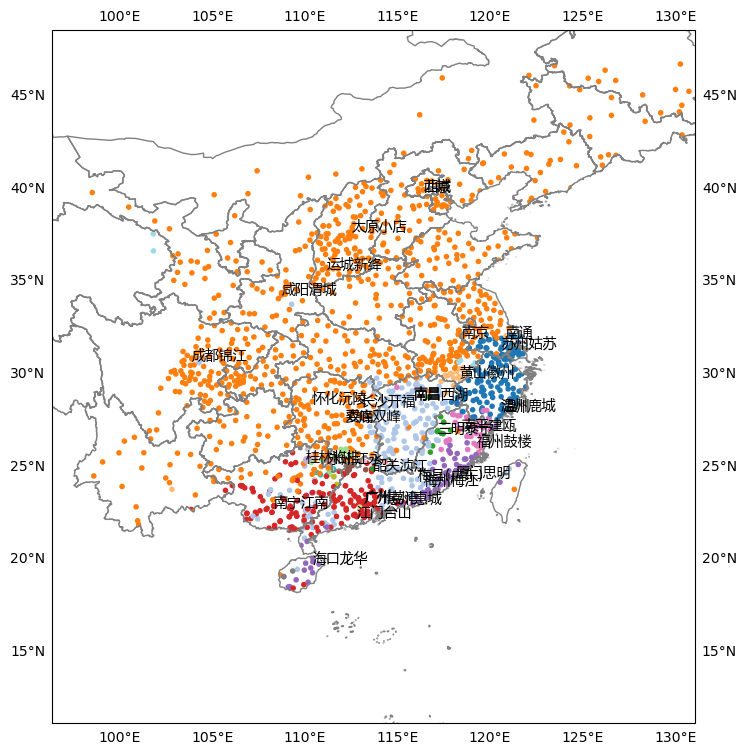

In [54]:
dialect['cluster1'] = KMeans(10, n_init='auto').fit_predict(dialect_emb)
dialect['cluster2'] = AgglomerativeClustering(20, metric='cosine', linkage='average').fit_predict(dialect_emb)

for c in ('cluster1', 'cluster2'):
    plt.figure(figsize=(16, 9))
    ax, _, _ = sinetym.plot.geography.scatter(
        dialect['latitude'],
        dialect['longitude'],
        dialect[c],
        scale=3,
        clip=china,
        marker='.',
        cmap='tab20'
    )
    ax.add_geometries(province, ax.projection, edgecolor='gray', facecolor='none')

    for _, r in dialect[dialect['representative']].iterrows():
        ax.annotate(r['spot'], xy=r[['longitude', 'latitude']])

    gl = ax.gridlines(draw_labels=True)
    gl.xlines = False
    gl.ylines = False
    plt.show()
    plt.close()

In [55]:
input_mean = np.mean(char_emb, axis=0)
s = char_emb - input_mean[None, :]
input_cov = s.T @ s / (s.shape[0] - 1)

trans = get_trans(dialect_emb[dialect.loc[dialect['sample'], 'idx']], weight)
wtw_eig_val, wtw_eig_vec = np.linalg.eig(trans @ np.swapaxes(trans, -1, -2))
trans2 = wtw_eig_vec * np.sqrt(np.maximum(wtw_eig_val, 0))[:, None, :] @ np.swapaxes(wtw_eig_vec, -1, -2)

d = trans2[:, None, ...] - trans2[None, :, ...]
a = np.swapaxes(d, -1, -2) @ d
a_eig_val, a_eig_vec = np.linalg.eig(a)
b = a_eig_vec * np.sqrt(np.maximum(a_eig_val, 0))[:, :, None, :]
cov = np.swapaxes(b, -1, -2) @ np.swapaxes(np.tensordot(b, input_cov, [2, 0]), -1, -2)
dist = np.sum(np.linalg.eigvals(cov), axis=-1) \
    + np.tensordot(np.tensordot(input_mean, a, [-1, 2]), input_mean, [-1, -1])

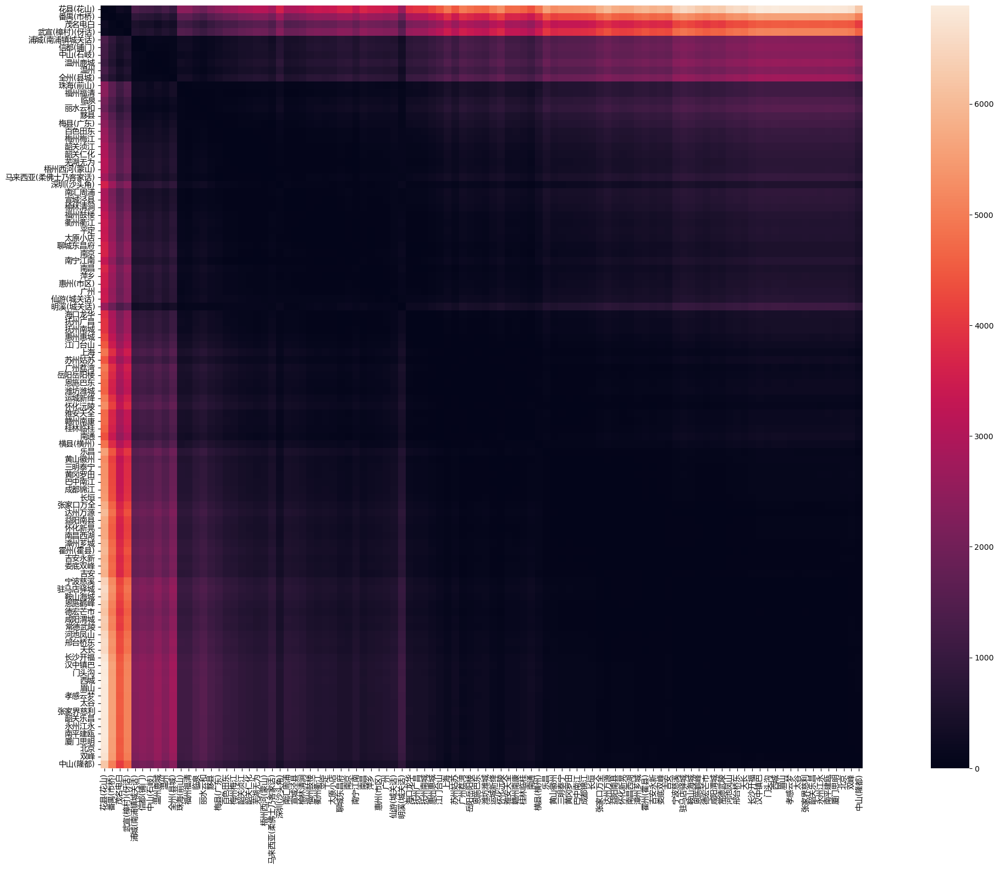

In [56]:
plt.figure(figsize=(32, 18))
plt.xticks(rotation='vertical')
plt.yticks(rotation='horizontal')
sinetym.plot.heatmap(dist, dialect.loc[dialect['sample'], 'spot'])
plt.show()
plt.close()

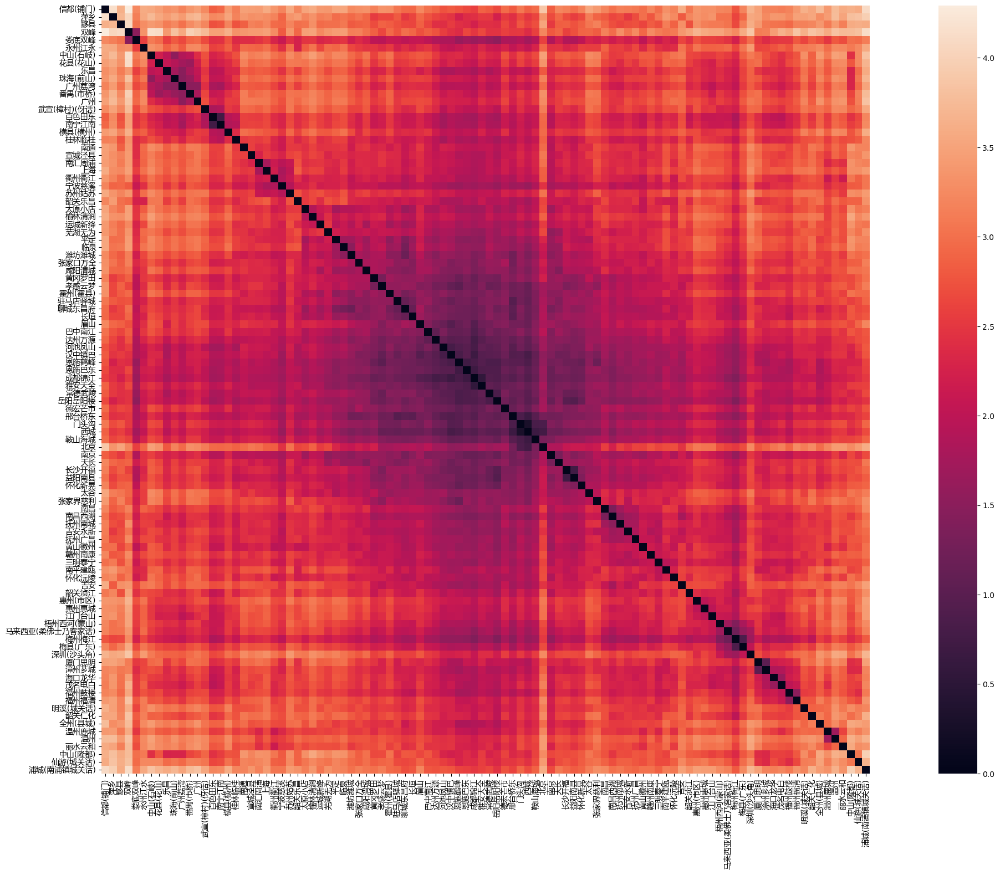

In [57]:
trans = get_trans(dialect_emb[dialect.loc[dialect['sample'], 'idx']], weight)
inv = np.linalg.inv(trans)
_, s, _ = np.linalg.svd(trans[:, None, ...] @ inv[None, :, ...])
dist = np.var(np.log(s), axis=-1)

plt.figure(figsize=(32, 18))
plt.xticks(rotation='vertical')
plt.yticks(rotation='horizontal')
sinetym.plot.heatmap(dist, dialect.loc[dialect['sample'], 'spot'])
plt.show()
plt.close()

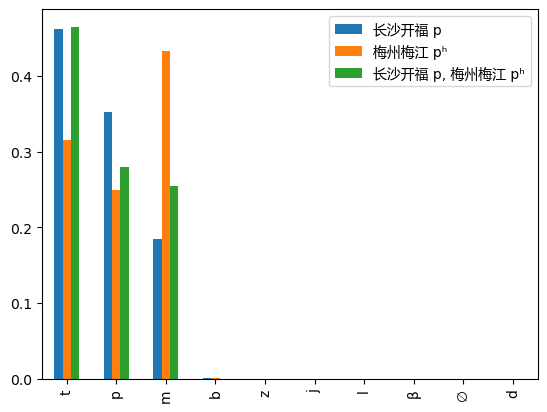

In [58]:
idx = ['Z26516', 'Z15233', 'Z10G71']
demb = np.repeat(get_emb(dialect_embs, dialect.loc[idx, dialect_columns]), char_emb.shape[0], axis=0)
cemb = np.tile(char_emb, (3, 1))
oemb = transform(demb, cemb, weight)
prob = get_prob(output_embs, oemb)[0].set_index(pd.MultiIndex.from_product((idx, char.index)))
df = prob.stack().unstack(1).loc[[('Z26516', 'p'), ('Z15233', 'pʰ')]] @ prob.loc['Z10G71']
df.set_index(dialect.loc[df.index.get_level_values(0), 'spot'].values + ' ' + df.index.get_level_values(1), inplace=True)
df.loc[', '.join(df.index)] = df.prod(axis=0)
df.loc[:, :] = normalize(df, norm='l1')

df.T.sort_values(df.index[-1], ascending=False)[:10].plot.bar()
plt.show()
plt.close()

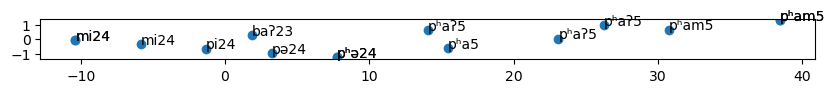

In [59]:
demb = get_emb(dialect_embs, dialect.loc[idx, dialect_columns])
demb = np.concatenate([
    np.linspace(demb[0], demb[1], 5),
    np.linspace(demb[1], demb[2], 5),
    np.linspace(demb[2], demb[0], 5)
], axis=0)
output_emb = transform(
    demb,
    np.repeat(get_emb(input_embs, char.loc[['Z0843'], input_columns]), demb.shape[0], axis=0),
    weight
)
outputs = get_output(output_embs, output_emb)
pc = output_pca.transform(output_emb)

plt.figure(figsize=(10, 10))
ax = plt.axes(aspect='equal')

ax.scatter(x=pc[:, 0], y=pc[:, 1])
for i in range(outputs.shape[0]):
    ax.annotate(''.join(outputs[i]), xy=pc[i, :2])

plt.show()
plt.close()

In [60]:
df = dialect.loc[dialect['representative'] & (dialect['dataset'] == 'zhongguoyuyan')]
dist = euclidean_distances(dialect_emb[df['idx']], dialect_emb)
idx = np.argsort(dist, axis=1)[:, 1:6]
pyperclip.copy(pd.DataFrame(
    np.where(dialect['spot'] != '', dialect['spot'], dialect['did'])[idx],
    index=df['spot'].rename('方言'),
    columns=np.arange(1, 6)
).to_markdown())
display_markdown(pyperclip.paste(), raw=True)

| 方言     | 1        | 2            | 3          | 4        | 5          |
|:---------|:---------|:-------------|:-----------|:---------|:-----------|
| 厦门思明 | 厦门思明 | 泉州永春     | 台北新北   | 厦门同安 | 漳州芗城   |
| 三明泰宁 | 南平邵武 | 大田         | 宿迁宿城   | 巫溪     | 巫山       |
| 福州鼓楼 | 福州闽侯 | 福州长乐     | 福州连江   | 福州永泰 | 宁德古田   |
| 南平建瓯 | 南平政和 | 南平延平     | 大田       | 南平浦城 | 南平松溪   |
| 怀化沅陵 | 湘西泸溪 | 大田         | 辽源龙山   | 荣昌     | 毕节七星关 |
| 永州江永 | 大田     | 毕节七星关   | 巫溪       | 北碚     | 万州       |
| 长沙开福 | 长沙     | 益阳南县     | 株洲       | 湘潭雨湖 | 岳阳岳阳楼 |
| 娄底双峰 | 湘潭湘乡 | 双峰         | 湘潭韶山   | 大田     | 常德津市   |
| 南昌西湖 | 南昌湾里 | 景德镇珠山   | 九江德安   | 抚州临川 | 抚州资溪   |
| 海口龙华 | 屯昌     | 东方         | 定安       | 琼海     | 文昌       |
| 咸阳渭城 | 咸阳旬邑 | 西安莲湖     | 庆阳宁县   | 商洛商州 | 运城       |
| 韶关浈江 | 梅州五华 | 大田         | 宜春铜鼓   | 韶关翁源 | 东莞       |
| 苏州姑苏 | 苏州太仓 | 苏州吴江     | 苏州昆山   | 嘉兴平湖 | 湖州吴兴   |
| 南京     | 南京浦口 | 南京六合     | 大田       | 淮安楚州 | 淮安金湖   |
| 南通     | 上饶弋阳 | 盐城东台     | 南通如东   | 南通海安 | 大田       |
| 黄山徽州 | 大田     | 铜仁碧江     | 达州渠县   | 垫江     | 沙坪坝     |
| 运城新绛 | 渭南韩城 | 运城垣曲     | 运城稷山   | 咸阳渭城 | 临汾侯马   |
| 太原小店 | 朔州怀仁 | 乌拉察布集宁 | 晋中寿阳   | 平定     | 忻州定襄   |
| 成都锦江 | 南充阆中 | 内江资中     | 资阳雁江   | 内江市中 | 资阳安岳   |
| 温州鹿城 | 温州永嘉 | 温州瑞安     | 温州乐清   | 温州苍南 | 大田       |
| 南宁江南 | 南宁江南 | 南宁隆安     | 百色田东   | 百色田阳 | 百色平果   |
| 桂林临桂 | 桂林临桂 | 大田         | Z13326mb01 | 内江威远 | 百色田林   |
| 江门台山 | 江门开平 | 大田         | 百色田东   | 茂名化州 | 云浮罗定   |
| 广州荔湾 | 澳门     | Z32C89mb01   | 广州番禺   | 云浮郁南 | 佛山南海   |
| 惠州惠城 | 大田     | 河源源城     | 惠州龙门   | 广安岳池 | 惠州博罗   |
| 梅州梅江 | 苗栗     | 玉林博白     | 崇左宁明   | 梅州丰顺 | 宜春铜鼓   |
| 西城     | 门头沟   | 昌平         | 房山       | 怀柔     | 密云       |

In [61]:
dist = cosine_distances(dialect_emb[df['idx']], dialect_emb)
idx = np.argsort(dist, axis=1)[:, 1:6]
pyperclip.copy(pd.DataFrame(
    np.where(dialect['spot'] != '', dialect['spot'], dialect['did'])[idx],
    index=df['spot'].rename('方言'),
    columns=np.arange(1, 6)
).to_markdown())
display_markdown(pyperclip.paste(), raw=True)

| 方言     | 1                | 2                | 3            | 4          | 5          |
|:---------|:-----------------|:-----------------|:-------------|:-----------|:-----------|
| 厦门思明 | 厦门思明         | 泉州永春         | 台北新北     | 厦门同安   | 漳州芗城   |
| 三明泰宁 | 泰宁(城关话)     | 南平邵武         | 邵武         | 宿迁宿城   | 南平延平   |
| 福州鼓楼 | 福州闽侯         | 福州长乐         | 福州连江     | 福州永泰   | 福州       |
| 南平建瓯 | 建瓯(市志)       | 建瓯             | 南平政和     | 石陂       | 南平浦城   |
| 怀化沅陵 | 湘西泸溪         | 湘潭韶山         | 大田         | 湘西古丈   | 永州冷水滩 |
| 永州江永 | 江永城关(白水村) | 郴州宜章         | 大田         | 湘西泸溪   | 韶关南雄   |
| 长沙开福 | 长沙             | 益阳南县         | 长沙         | 湘潭雨湖   | 株洲       |
| 娄底双峰 | 双峰             | 湘潭湘乡         | 娄底娄星     | 湘潭韶山   | 娄底涟源   |
| 南昌西湖 | 南昌湾里         | 景德镇珠山       | 抚州临川     | 南昌       | 抚州资溪   |
| 海口龙华 | 屯昌             | 东方             | 文昌         | 定安       | 琼海       |
| 咸阳渭城 | 咸阳旬邑         | 西安莲湖         | 渭南韩城     | 铜川耀州   | 商洛商州   |
| 韶关浈江 | 韶关翁源         | 梅州五华         | 河源龙川     | 宜春铜鼓   | 东莞       |
| 苏州姑苏 | 苏州太仓         | 苏州吴江         | 苏州昆山     | 苏州       | 昆山       |
| 南京     | 南京浦口         | 南京六合         | 镇江句容     | 淮安楚州   | 淮安清浦   |
| 南通     | 上饶弋阳         | 盐城东台         | 南通如东     | 南通海安   | 南通通州   |
| 黄山徽州 | 宣州绩溪         | 绩溪             | 嵊县太平     | 郴州宜章   | 黄山屯溪   |
| 运城新绛 | 渭南韩城         | 运城稷山         | 临汾侯马     | 运城垣曲   | 运城万荣   |
| 太原小店 | 晋中寿阳         | 朔州怀仁         | 乌拉察布集宁 | 忻州定襄   | 平定       |
| 成都锦江 | 南充阆中         | 内江市中         | 内江资中     | 资阳雁江   | 资阳安岳   |
| 温州鹿城 | 温州             | 温州永嘉         | 温州瑞安     | 温州乐清   | 温州平阳   |
| 南宁江南 | 南宁江南         | 南宁隆安         | 百色田东     | 百色田阳   | 百色平果   |
| 桂林临桂 | 桂林临桂         | 临桂(五通)(土话) | 临桂(五通)   | Z13326mb01 | 柳州融水   |
| 江门台山 | 台山(台城)       | 江门开平         | 开平(赤坎)   | 茂名化州   | 百色田东   |
| 广州荔湾 | 澳门             | Z32C89mb01       | 广州番禺     | 云浮郁南   | 佛山南海   |
| 惠州惠城 | 惠州(市区)       | 惠州博罗         | 河源源城     | 惠州龙门   | 河源龙川   |
| 梅州梅江 | 梅县(广东)       | 苗栗             | 玉林博白     | 香港       | 梅州丰顺   |
| 西城     | 门头沟           | 昌平             | 房山         | 怀柔       | 密云       |

In [62]:
pyperclip.copy(group_data \
    .assign(dataset=group_data['dataset'].map({'xiaoxuetang': '小学堂', 'zhongguoyuyan': '语保'})) \
    .loc[group_data['test'] & (group_data['svc'] != group_data['group']), ['dataset', 'spot', 'group', 'svc']] \
    .sort_values('group') \
    .rename(columns={'dataset': '数据集', 'spot': '方言', 'group': '标注分类', 'svc': '预测分类'}) \
    .to_markdown(index=False))
display_markdown(pyperclip.paste(), raw=True)

| 数据集   | 方言             | 标注分类   | 预测分类   |
|:---------|:-----------------|:-----------|:-----------|
| 小学堂   | 金坛西岗         | 吴语       | 赣语       |
| 语保     | 芜湖繁昌         | 吴语       | 官话       |
| 语保     | 临汾翼城         | 官话       | 晋语       |
| 语保     | 湘西凤凰         | 官话       | 赣语       |
| 语保     | 怀化芷江         | 官话       | 湘语       |
| 语保     | 龙岩连城         | 客家话     | 闽语       |
| 语保     | 株洲攸县         | 客家话     | 赣语       |
| 小学堂   | 灵川(三街)       | 平话       | 湘语       |
| 小学堂   | 融水(融水镇)     | 平话       | 粤语       |
| 小学堂   | 藤县(藤城)       | 平话       | 粤语       |
| 语保     | 延安宝塔         | 晋语       | 官话       |
| 小学堂   | 平顺             | 晋语       | 官话       |
| 语保     | 张家口张北       | 晋语       | 官话       |
| 语保     | 石家庄赞皇       | 晋语       | 官话       |
| 小学堂   | 阳城             | 晋语       | 官话       |
| 语保     | 岳阳             | 湘语       | 赣语       |
| 小学堂   | 武宣(樟村)(伢话) | 粤语       | 平话       |
| 语保     | 衡阳耒阳         | 赣语       | 官话       |
| 语保     | 郴州安仁         | 赣语       | 湘语       |
| 语保     | 岳阳岳阳楼       | 赣语       | 官话       |
| 语保     | 桂林灵川         | 闽语       | 平话       |

In [63]:
pyperclip.copy(mandarin \
    .assign(dataset=mandarin['dataset'].map({'xiaoxuetang': '小学堂', 'zhongguoyuyan': '语保'})) \
    .loc[mandarin['test'] & (mandarin['subgroup'] != mandarin['svc']), ['dataset', 'spot', 'subgroup', 'svc']] \
    .sort_values('subgroup') \
    .rename(columns={'dataset': '数据集', 'spot': '方言', 'subgroup': '标注分类', 'svc': '预测分类'}) \
    .to_markdown(index=False))
display_markdown(pyperclip.paste(), raw=True)

| 数据集   | 方言       | 标注分类   | 预测分类   |
|:---------|:-----------|:-----------|:-----------|
| 语保     | 东方       | 中原官话   | 胶辽官话   |
| 语保     | 庆阳庆城   | 中原官话   | 兰银官话   |
| 语保     | 白银靖远   | 中原官话   | 冀鲁官话   |
| 语保     | 金昌永昌   | 兰银官话   | 中原官话   |
| 语保     | 聊城东昌府 | 冀鲁官话   | 中原官话   |
| 语保     | 临沂莒南   | 冀鲁官话   | 胶辽官话   |
| 语保     | 赤峰宁城   | 北京官话   | 中原官话   |
| 语保     | 平谷       | 北京官话   | 冀鲁官话   |
| 小学堂   | 怀远       | 江淮官话   | 中原官话   |
| 语保     | 商洛镇安   | 江淮官话   | 中原官话   |
| 语保     | 白山浑江   | 胶辽官话   | 东北官话   |
| 语保     | 运城临猗   | 胶辽官话   | 中原官话   |

,did,cid,character,initial,final,tone,tone_category,note,variant,initial_voicing,initial_manner,coda_type,pred_initial,pred_final,pred_tone
159004,Z15231mb01,Z0001,多,t,ɔ,53,NaN,,mb01,voiceless,plosive,vowel,t,ɔ,53
159005,Z15231mb01,Z0002,拖,tʰ,ɔ,53,NaN,,mb01,voiceless,plosive,vowel,tʰ,ɔ,53
159006,Z15231mb01,Z0003,大,t,ai,22,NaN,,mb01,voiceless,plosive,vowel,t,ai,22
159007,Z15231mb01,Z0004,锣,l,ɔ,21,NaN,,mb01,voiced,approximant,vowel,l,ɔ,21
159008,Z15231mb01,Z0005,左,tʃ,ɔ,35,NaN,,mb01,voiceless,affricate,vowel,tʃ,ɔ,35
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
160032,Z15231mb01,Z0996,褥,∅,iok,2,NaN,,mb01,,,plosive,∅,ap,2
160033,Z15231mb01,Z0997,曲,kʰ,ok,5,NaN,,mb01,voiceless,plosive,plosive,kʰ,ok,5
160034,Z15231mb01,Z0998,局,k,ok,2,NaN,,mb01,voiceless,plosive,plosive,k,ok,2
160035,Z15231mb01,Z0999,玉,∅,iok,2,NaN,,mb01,,,plosive,∅,ap,2


,did,cid,character,initial,final,tone,tone_category,note,variant,initial_voicing,initial_manner,coda_type,pred_initial,pred_final,pred_tone
159004,Z15231mb01,Z0001,多,t,ɔ,53,NaN,,mb01,voiceless,plosive,vowel,s,i,213
159005,Z15231mb01,Z0002,拖,tʰ,ɔ,53,NaN,,mb01,voiceless,plosive,vowel,v,aŋ,35
159006,Z15231mb01,Z0003,大,t,ai,22,NaN,,mb01,voiceless,plosive,vowel,s,ɿ,213
159007,Z15231mb01,Z0004,锣,l,ɔ,21,NaN,,mb01,voiced,approximant,vowel,v,aŋ,35
159008,Z15231mb01,Z0005,左,tʃ,ɔ,35,NaN,,mb01,voiceless,affricate,vowel,m,an,34
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
160032,Z15231mb01,Z0996,褥,∅,iok,2,NaN,,mb01,,,plosive,v,aŋ,35
160033,Z15231mb01,Z0997,曲,kʰ,ok,5,NaN,,mb01,voiceless,plosive,plosive,s,ɿ,213
160034,Z15231mb01,Z0998,局,k,ok,2,NaN,,mb01,voiceless,plosive,plosive,v,aŋ,35
160035,Z15231mb01,Z0999,玉,∅,iok,2,NaN,,mb01,,,plosive,v,aŋ,35


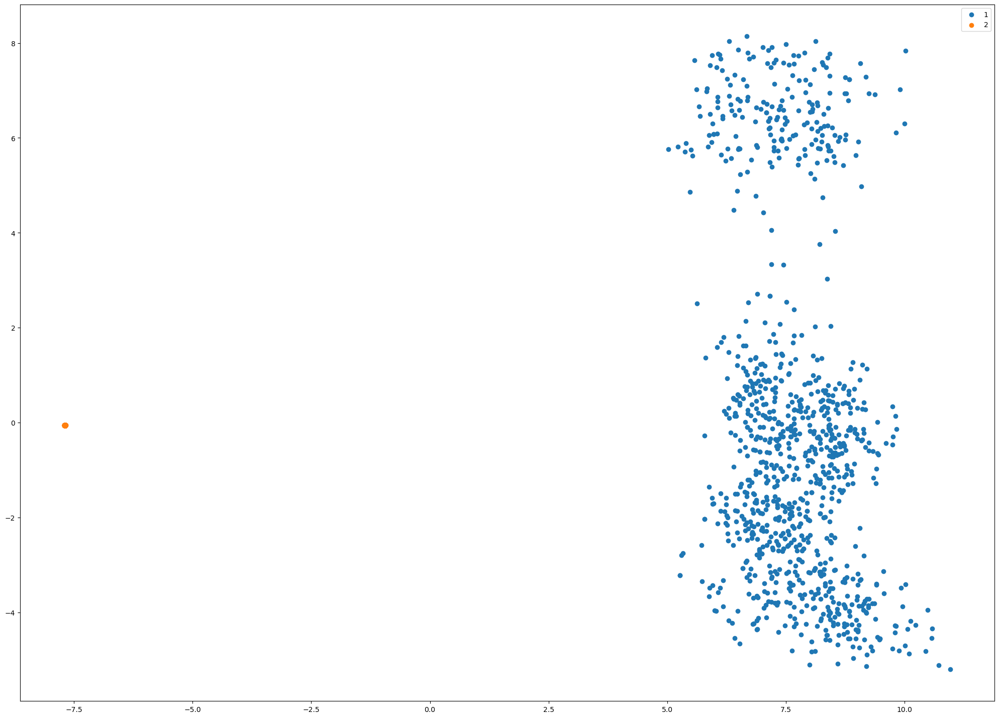

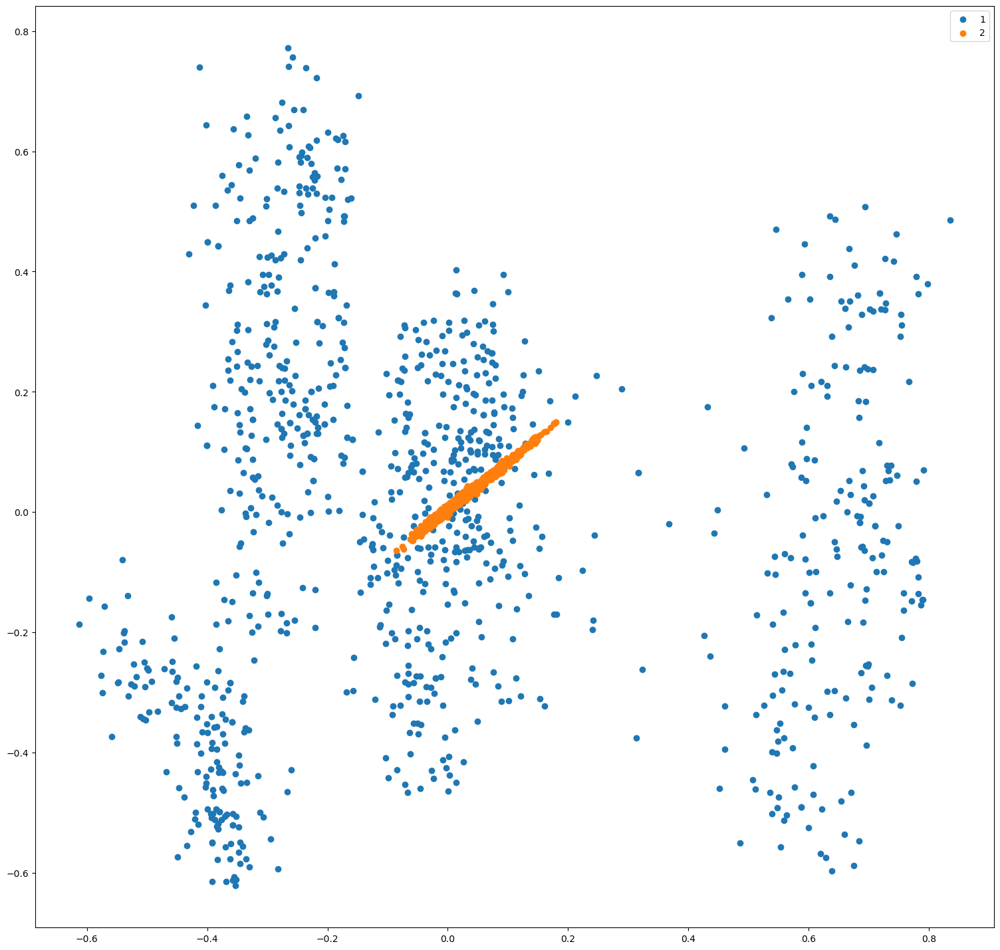

In [64]:
a = np.concatenate([e for e in output_embs], axis=0)
ainv = np.linalg.pinv(a)
lim = np.cumsum([0] + [e.shape[0] for e in output_embs])
output_embs2 = [pd.DataFrame(ainv.T[lim[i]:lim[i + 1]], index=output_embs[i].index) for i in range(lim.shape[0] - 1)]
trans = get_trans(dialect_emb[dialect.loc['Z15231', 'idx']], weight)

input_emb1 = get_emb(input_embs, data.loc[data['did'] == 'Z15231mb01', input_columns])
output_emb1 = transform(dialect_emb[dialect.loc['Z15231', 'idx']], input_emb1, weight)
initial_emb1, final_emb1, tone_emb1 = [output_emb1 @ e.T for e in output_embs]
output_emb2 = get_emb(output_embs2, data.loc[data['did'] == 'Z15231mb01', output_columns])
input_emb2 = output_emb2 @ np.linalg.inv(trans)
output_emb3 = transform(dialect_emb[dialect.loc['Z15231', 'idx']], input_emb2, weight)
output3 = get_output(output_embs, output_emb3)
output_emb4 = transform(dialect_emb[dialect.loc['Z03E88', 'idx']], input_emb2, weight)
output4 = get_output(output_embs, output_emb4)
display(data[data['did'] == 'Z15231mb01'].assign(pred_initial=output3[:, 0], pred_final=output3[:, 1], pred_tone=output3[:, 2]))
display(data[data['did'] == 'Z15231mb01'].assign(pred_initial=output4[:, 0], pred_final=output4[:, 1], pred_tone=output4[:, 2]))
# display(get_output(input_embs, input_emb2))

pca = PCA(2).fit(np.concatenate([output_emb1, output_emb2], axis=0))
pc1 = pca.transform(output_emb1)
pc2 = pca.transform(output_emb2)

plt.figure(figsize=(32, 18))
ax = plt.axes(aspect='equal')

ax.scatter(pc1[:, 0], pc1[:, 1], label=1)
ax.scatter(pc2[:, 0], pc2[:, 1], label=2)
ax.legend()

plt.show()
plt.close()

pc1 = char_pca.transform(input_emb1)
pc2 = char_pca.transform(input_emb2)

plt.figure(figsize=(32, 18))
ax = plt.axes(aspect='equal')

ax.scatter(pc1[:, 0], pc1[:, 1], label=1)
ax.scatter(pc2[:, 0], pc2[:, 1], label=2)
ax.legend()

plt.show()
plt.close()